# Load dependencies and set up plotting preferences

In [2]:
%load_ext autoreload
%autoreload 2

### Import dependencies
import os
import analyze_movements as am
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import pylab
from tqdm.notebook import tqdm
from glob import glob
import warnings
import time
warnings.filterwarnings('ignore')

### Set general plotting parameters
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
plt.rcParams.update({'font.family':'sans-serif'})
plt.rcParams.update({'font.sans-serif':'Arial'})
matplotlib.rcParams.update({'font.size': 10})
plot_params = {'cm':pylab.get_cmap('jet'),
               'pointsize':3,
               'cond_col':['k',[0.6,0.6,0.6]],
               'hmm_col':[[0.6,0.6,0.6], 'k'],
               '4cond_col':[[1,0,0],'k',[0.5,0,0],[0.6,0.6,0.6]],
               'cond_sty':['-',':'],
               '4cond_sty':[':','-',':','-'],
               'plat_cols':['b','r','m'],
               'laser_col':['k','c'],
               'bm_col':['b','m']}

### Chose whether you want to make PDF/videos
save_pdf = True #do you want to save figures to pdf?
show_UMAP = False # do you want to launch the UMAP html visualizer?
make_videos = False #do you want to make videos showing bobs?

### Select data file
# data_file = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_alldata.pkl'
# data_file = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_alldata_500msClusts.h5'

### Path to clipped videos
vid_path = r'\\sendak\D\Phil\jumping_analysis\paper_cohort\clipped_vids'

print('loaded dependencies')

loaded dependencies


### Look at head angles, landing position in original dataset

In [2]:
# load decision data
mvmnt_file = r'T:\variable_platform_allpts.h5'
df_all = pd.read_hdf(mvmnt_file,key='df')
df_all['distance_DLC'] = df_all['distance']
df_all['platform_DLC'] = df_all['platform']

trial_length = []
for index,row in df_all.iterrows():
    trial_length.append((row['Top_Jump']-row['Top_Start'])/row['fps'])
df_all['trial_length'] = trial_length

### load top-down data
data_file = r'T:\df_jumpDLCpts.h5'
df_jump = pd.read_hdf(data_file,key='df')
df_jump['platform_DLC'] = df_jump['platform']
df_jump['distance_DLC'] = df_jump['distance']

expt_group = []
for index,row in df_all.iterrows():
    if 'PV' in str(row['subject']):
        expt_group.append('ChR2')
    else:
        expt_group.append('WT')
df_all['expt_group'] = expt_group


expt_group = []
for index,row in df_jump.iterrows():
    if 'PV' in str(row['subject']):
        expt_group.append('ChR2')
    else:
        expt_group.append('WT')
df_jump['expt_group'] = expt_group

In [3]:
lh_thresh = 0.95
start_fr = 0#-200
side_pitch = []
side_position = []

# get pitch
for index,row in df_all.iterrows():

    ear_like = row['Side LEar likelihood'] < lh_thresh
    eye_like = row['Side LEye likelihood'] < lh_thresh
    rho_like = ear_like & eye_like
    rho_like = rho_like[start_fr:-2]

    ear_x = row['Side LEar x'][start_fr:-2]
    ear_y = row['Side LEar y'][start_fr:-2]
    eye_x = row['Side LEye x'][start_fr:-2]
    eye_y = row['Side LEye y'][start_fr:-2]
    # get head angle
    rho = np.degrees(np.arctan2(eye_y-ear_y,ear_x-eye_x))
    rho[rho_like] = np.nan

    side_pitch.append(rho)
    side_position.append(eye_y)

df_all['Side_pitch'] = side_pitch
df_all['Side_pitch_mean'] = [np.nanmean(r) for r in side_pitch]
df_all['Side_pitch_std'] = [np.nanstd(r) for r in side_pitch]
df_all['Side_position_mean'] = [np.nanmean(r) for r in side_position]
df_all['Side_position_std'] = [np.nanstd(r) for r in side_position]

### get yaw
lh_thresh = 0.95
start_fr = -200
top_yaw = []

for index,row in df_all.iterrows():

    jump_fr = int(row['Top_Jump']-row['Top_Start'])

    ear_like = row['Top LEar likelihood'] < lh_thresh
    eye_like = row['Top LEye likelihood'] < lh_thresh
    rho_like = ear_like & eye_like
    rho_like = rho_like[start_fr:jump_fr]

    ear_x = row['Top LEar x'][start_fr:jump_fr]
    ear_y = row['Top LEar y'][start_fr:jump_fr]
    eye_x = row['Top LEye x'][start_fr:jump_fr]
    eye_y = row['Top LEye y'][start_fr:jump_fr]
    # get head angle
    rho = np.degrees(np.arctan2(ear_y-eye_y,ear_x-eye_x))
    rho[rho_like] = np.nan

    top_yaw.append(rho)

df_all['Top_yaw'] = top_yaw
df_all['Top_yaw_std'] = [np.nanstd(r) for r in top_yaw]


accuracy = []
l_thresh=0.99
for index,row in df_jump.iterrows():
    LandFR_x = np.nanmedian(row['Top LandFR x'][row['Top LandFR likelihood']>l_thresh])
    LandFL_x = np.nanmedian(row['Top LandFL x'][row['Top LandFL likelihood']>l_thresh])
    LandLEar = row['Top LEar x'][-1]
    accuracy.append((np.nanmean([LandFR_x,LandFL_x])-LandLEar)/row['Top_pixpercm'])
df_jump['accuracy'] = accuracy



# trial duration and movement frequency in original dataset

In [4]:
# df_all = variable_platform_mvmnts_250ms_velocity_labels.h5


# trial_length = []
# for index,row in df_all.iterrows():
#     trial_length.append((row['Top_Jump']-row['Top_Start'])/100)
# df_all['trial_length'] = trial_length

# df_cond = df_all[(df_all['condition']=='control')|(df_all['condition']=='suture')]#|(df_all['success']!=2)]
# df_cond.reset_index(inplace=True,drop=True)
# labels_cond = labels_all[(labels_all['condition']=='control')|(labels_all['condition']=='suture')]#|(labels_all['success']!=2)]
# labels_cond.reset_index(inplace=True,drop=True)

# condition = 'ocular'
# am.plot_movs_per_sec(df_cond,labels_cond,condition,plot_params['cond_col'],False,[],suptitle='baseline behavior')
# am.plot_variable_vs_distance_manipulation(df_cond,'trial_length','success',condition,0,20,plot_params['cond_col'],False,[],suptitle='trial duration by success outcome')

# df_cond = df_all[(df_all['condition']=='opto suture')]
# df_cond.reset_index(inplace=True,drop=True)
# labels_cond = labels_all[(labels_all['condition']=='opto suture')]
# labels_cond.reset_index(inplace=True,drop=True)

# condition = 'laser_trial'
# am.plot_movs_per_sec(df_cond,labels_cond,condition,plot_params['laser_col'],False,[],suptitle='binocular opto')
# am.plot_variable_vs_distance_manipulation(df_cond,'trial_length','expt_group',condition,0,20,plot_params['laser_col'],False,[],suptitle='binocular opto')



NameError: name 'labels_all' is not defined

In [10]:
# # load metadata
# keys = df_all.keys()[:19]
# data = df_all.loc[:,keys]

# # add DLC data to dataframe for top-down cam only
# lh_thresh = 0.95
# df_jump = am.load_dlc_h5(data,['Top'],vid_path,lh_thresh)

1764it [09:21,  3.45it/s]

there is no file for:  expdate                   062920
subject                  J158BRT
condition                control
platform                       2
distance                      24
                          ...   
Top LandBR likelihood      [0.0]
Top LandFR x               [0.0]
Top LandFR y               [0.0]
Top LandFR likelihood      [0.0]
jumpdist                       0
Name: 1763, Length: 80, dtype: object


4310it [22:49,  3.15it/s]


In [11]:
# # save the side data
# expt_group = []
# for index,row in df_jump.iterrows():
#     if 'PV' in str(row['subject']):
#         expt_group.append('ChR2')
#     else:
#         expt_group.append('WT')
# df_jump['expt_group'] = expt_group
# df_jump['distance_DLC'] = df_jump['distance']

# data_file = r'T:\df_jumpDLCpts.h5'

# df_jump.to_hdf(data_file,key='df',mode='w')

In [9]:
### create pdf of opto analysis for original group
pdf_file = r'T:\og_monoc_opto_analysis.pdf'
pp = PdfPages(pdf_file)

cond = 'opto suture'
df_cond = df_jump[df_jump['condition']==cond]
df_cond.reset_index(inplace=True,drop=True)

#visualize all landing positions
im = np.ones((540,720,3))*255
im = im.astype('uint8')
dists = np.unique(df_cond['distance_DLC'])
anis = np.unique(df_cond['subject'])
laser_label = np.unique(df_cond['laser_trial'])
laser_col = ['k','c']
laser_col_mean = ['b','m']

for ani in anis:
    df_ani = df_cond[(df_cond['subject']==ani)&(df_cond['success']==1)]
    df_ani.reset_index(inplace=True,drop=True)
    fig, axs = plt.subplots(2,int(np.ceil(len(dists)/2)),figsize=(4*int(np.ceil(len(dists)/2)),4*2))
    axs = axs.ravel()
    for d,dist in enumerate(dists):
        ax = axs[d]
        for l,laser in enumerate(laser_label):
            temp_df = df_ani[(df_ani['distance_DLC']==dist)&(df_ani['laser_trial']==laser)]
            temp_df.reset_index(inplace=True,drop=True)
            if laser==laser_label[0]:
                row = df_cond.iloc[np.where((df_cond['platform_DLC']==3)&(df_cond['distance_DLC']==dist))[0][0]] #find a trial w/platform 3
                # vid_file = am.find(row['expdate'] + '_' + row['subject'] + '_' + row['condition'] + '_TOP_' + str(row['trial']-1) + '*.avi',vid_path)[0]
                vid_file = am.find(str(row['expdate']) + '_' + row['subject'] + '_' + 'TOP' + '_' + str(row['trial']).zfill(3) + '*.avi',vid_path)[0]
                frame,fps,frame_width,frame_height,ret = am.grab_vidframe(vid_file,10)
                ax.imshow(frame)
            #get landing positions
            xs = [i[-1] for i in temp_df['Top LEar x']]
            ys = [i[-1] for i in temp_df['Top LEar y']]
            #plot individual landing positions
            ax.scatter(xs,ys,c=laser_col[l],marker='+',zorder=l+1)
            #plot mean landing positions
            ax.scatter(np.mean(xs),np.mean(ys),c=laser_col_mean[l],marker='o',zorder=l+3)
        # ax.axis([0,1440,0,1080])
        ax.axis('off')
    axs[-1].axis('off')
    fig.suptitle(ani + ' ' + df_ani['expt_group'].iloc[0])
    pp.savefig(fig)
    plt.close(fig)


#visualize movements
for ani in anis:
    df_ani = df_cond[(df_cond['subject']==ani)&(df_cond['success']!=2)]
    df_ani.reset_index(inplace=True,drop=True)
    fig, axs = plt.subplots(2,int(np.ceil(len(dists)/2)),figsize=(4*int(np.ceil(len(dists)/2)),4*2))
    axs = axs.ravel()
    for d,dist in enumerate(dists):
        ax = axs[d]
        for l,laser in enumerate(laser_label):
            temp_df = df_ani[(df_ani['distance_DLC']==dist)&(df_ani['laser_trial']==laser)]
            temp_df.reset_index(inplace=True,drop=True)
            if laser==laser_label[0]:
                ax.imshow(im)
            # plot individual decision periods
            for index,row in temp_df.iterrows():
                ax.plot(row['Top LEar x'][:int(row['Top_Jump']-row['Top_Start'])],row['Top LEar y'][:int(row['Top_Jump']-row['Top_Start'])],
                '-',color=laser_col[l],linewidth=0.5,alpha=0.4)
        # ax.axis([0,1440,0,1080])
        ax.axis('off')
    axs[-1].axis('off')
    fig.suptitle(ani + ' ' + df_ani['expt_group'].iloc[0])

    pp.savefig(fig)
    plt.close(fig)



#quanitfy head position histograms
maxy=2500
for ani in anis:
    df_ani = df_cond[(df_cond['subject']==ani)&(df_cond['success']!=2)]
    df_ani.reset_index(inplace=True,drop=True)
    fig, axs = plt.subplots(2,int(np.ceil(len(dists)/2)),figsize=(4*int(np.ceil(len(dists)/2)),4*2))
    axs = axs.ravel()
    for d,dist in enumerate(dists):
        ax = axs[d]
        trial_dur = []
        for l,laser in enumerate(laser_label):
            temp_df = df_ani[(df_ani['distance_DLC']==dist)&(df_ani['laser_trial']==laser)]
            temp_df.reset_index(inplace=True,drop=True)
            temp_arr = np.array([])
            for index,row in temp_df.iterrows():
                temp_arr = np.append(temp_arr,row['Top LEar y'][:int(row['Top_Jump']-row['Top_Start'])],axis=0)
            temp_arr.flatten()
            ax.hist(temp_arr,bins=np.arange(200,300,10),color=laser_col[l],alpha=0.4,zorder=l)
            # ax.plot([np.nanmean(temp_arr),np.nanmean(temp_arr)],[0,6000],':',color=laser_col[laser],linewidth=3,zorder=laser+2)
            ax.plot([np.nanmean(temp_arr)-np.nanstd(temp_arr),np.nanmean(temp_arr)+np.nanstd(temp_arr)],[maxy+l*100,maxy+l*100],'-',color=laser_col[l],linewidth=3,zorder=l+2)
            ax.plot(np.nanmean(temp_arr),maxy+l*100,'o',color=laser_col[l],linewidth=3,zorder=l+2)
            try:
                trial_dur.append(temp_df['trial_length'].mean())
            except:
                trial_dur.append(0)
        ax.set_title('dur off=%0.1fs, on=%0.1fs' % (trial_dur[0],trial_dur[1]))
        ax.set_xlabel('head position (pix)')
        ax.set_ylabel('freq')
    fig.suptitle(ani + ' ' + df_ani['expt_group'].iloc[0])
    fig.tight_layout()
    pp.savefig(fig)
    plt.close(fig)


# mn_land_diff = np.zeros((len(dists),len(anis)))

# for a,ani in enumerate(anis):
#     df_ani = df_cond[(df_cond['subject']==ani)&(df_cond['success']==1)]
#     df_ani.reset_index(inplace=True,drop=True)
#     for d,dist in enumerate(dists):
#         mn_land = np.zeros(4) #x1,x2,y1,y2
#         for l,laser in enumerate(laser_label):
#             temp_df = df_ani[(df_ani['distance_DLC']==dist)&(df_ani['laser_trial']==laser)]
#             temp_df.reset_index(inplace=True,drop=True)

#             #get landing positions
#             xs = [i[-1] for i in temp_df['Top LEar x']]
#             ys = [i[-1] for i in temp_df['Top LEar y']]
    
#             mn_land[l] = np.nanmean(xs)/df_ani['Top_pixpercm'].iloc[0]
#             mn_land[l+2] = np.nanmean(ys)/df_ani['Top_pixpercm'].iloc[0]
#         mn_land_diff[d,a] = np.sqrt((mn_land[1]-mn_land[0])**2 + (mn_land[3]-mn_land[2])**2)


# fig, ax = plt.subplots(1,1,figsize=(5,5))
# ax.errorbar(x=dists,y=np.nanmean(mn_land_diff[:,:4],axis=1),yerr=np.nanstd(mn_land_diff[:,:4],axis=1)/np.sqrt(4),color='k',label='WT')
# ax.errorbar(x=dists,y=np.nanmean(mn_land_diff[:,4:],axis=1),yerr=np.nanstd(mn_land_diff[:,4:],axis=1)/np.sqrt(4),color='c',label='ChR2')
# ax.set_xlim(5,25)
# ax.set_ylim(0,3)
# ax.set_xlabel('gap distance')
# ax.set_ylabel('laser-induced change in landing position (cm)',fontsize=12)
# ax.legend()
# fig.tight_layout()
# pp.savefig(fig)
# plt.close(fig)


cond = 'opto suture'
df_cond = df_jump[(df_jump['condition']==cond)&(df_jump['success']!=2)]
df_cond.reset_index(inplace=True,drop=True)

dists = np.unique(df_cond['distance_DLC'])
anis = np.unique(df_cond['subject'])
laser_label = np.unique(df_cond['laser_trial'])

mn_land_xy_diff = np.zeros((len(dists),2,int(len(anis)/2)))
mn_land_x_diff = np.zeros((len(dists),2,int(len(anis)/2)))
mn_land_y_diff = np.zeros((len(dists),2,int(len(anis)/2)))
std_land_x = np.zeros((len(dists),2,2,int(len(anis)/2))) #dists,laser,group,animal
std_land_y = np.zeros((len(dists),2,2,int(len(anis)/2)))

wt_count = -1
ch_count = -1

for a,ani in enumerate(anis):
    df_ani = df_cond[(df_cond['subject']==ani)&(df_cond['success']==1)]
    df_ani.reset_index(inplace=True,drop=True)

    if df_ani['expt_group'].iloc[0]=='WT':
        grp='WT'
        wt_count += 1
    else:
        grp='ChR2'
        ch_count += 1

    for d,dist in enumerate(dists):
        mn_land = np.zeros(4) #x1,x2,y1,y2
        std_land = np.zeros(4) #x1,x2,y1,y2
        for l,laser in enumerate(laser_label):
            temp_df = df_ani[(df_ani['distance_DLC']==dist)&(df_ani['laser_trial']==laser)]
            temp_df.reset_index(inplace=True,drop=True)

            #get landing positions
            xs = [i[-1] for i in temp_df['Top LEar x']]
            ys = [i[-1] for i in temp_df['Top LEar y']]
    
            mn_land[l] = np.nanmean(xs)/df_ani['Top_pixpercm'].iloc[0]
            mn_land[l+2] = np.nanmean(ys)/df_ani['Top_pixpercm'].iloc[0]
            std_land[l] = np.nanstd(xs)/df_ani['Top_pixpercm'].iloc[0]
            std_land[l+2] = np.nanstd(ys)/df_ani['Top_pixpercm'].iloc[0]
        if grp=='WT':
            mn_land_xy_diff[d,0,wt_count] = np.sqrt((mn_land[1]-mn_land[0])**2 + (mn_land[3]-mn_land[2])**2)
            mn_land_x_diff[d,0,wt_count] = np.abs(mn_land[1]-mn_land[0])
            mn_land_y_diff[d,0,wt_count] = np.abs(mn_land[3]-mn_land[2])
            std_land_x[d,0,0,wt_count] = std_land[0]
            std_land_x[d,1,0,wt_count] = std_land[1]
            std_land_y[d,0,0,wt_count] = std_land[2]
            std_land_y[d,1,0,wt_count] = std_land[3]
        else:
            mn_land_xy_diff[d,1,ch_count] = np.sqrt((mn_land[1]-mn_land[0])**2 + (mn_land[3]-mn_land[2])**2)
            mn_land_x_diff[d,1,ch_count] = np.abs(mn_land[1]-mn_land[0])
            mn_land_y_diff[d,1,ch_count] = np.abs(mn_land[3]-mn_land[2])
            std_land_x[d,0,1,ch_count] = std_land[0]
            std_land_x[d,1,1,ch_count] = std_land[1]
            std_land_y[d,0,1,ch_count] = std_land[2]
            std_land_y[d,1,1,ch_count] = std_land[3]


fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.errorbar(x=dists,y=np.nanmean(mn_land_xy_diff[:,0,:],axis=1),yerr=np.nanstd(mn_land_xy_diff[:,0,:],axis=1)/np.sqrt(4),color='k',label='WT')
ax.errorbar(x=dists,y=np.nanmean(mn_land_xy_diff[:,1,:],axis=1),yerr=np.nanstd(mn_land_xy_diff[:,1,:],axis=1)/np.sqrt(4),color='c',label='ChR2')
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance')
ax.set_ylabel('laser-induced change in landing position (cm)',fontsize=12)
ax.legend()
fig.suptitle(cond)
fig.tight_layout()
pp.savefig(fig)
plt.close(fig)

fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.errorbar(x=dists,y=np.nanmean(mn_land_x_diff[:,0,:],axis=1),yerr=np.nanstd(mn_land_x_diff[:,0,:],axis=1)/np.sqrt(4),color='k',label='WT')
ax.errorbar(x=dists,y=np.nanmean(mn_land_x_diff[:,1,:],axis=1),yerr=np.nanstd(mn_land_x_diff[:,1,:],axis=1)/np.sqrt(4),color='c',label='ChR2')
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance')
ax.set_ylabel('distance change',fontsize=12)
ax.legend()
fig.suptitle(cond)
fig.tight_layout()
pp.savefig(fig)
plt.close(fig)

fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.errorbar(x=dists,y=np.nanmean(mn_land_y_diff[:,0,:],axis=1),yerr=np.nanstd(mn_land_y_diff[:,0,:],axis=1)/np.sqrt(4),color='k',label='WT')
ax.errorbar(x=dists,y=np.nanmean(mn_land_y_diff[:,1,:],axis=1),yerr=np.nanstd(mn_land_y_diff[:,1,:],axis=1)/np.sqrt(4),color='c',label='ChR2')
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance')
ax.set_ylabel('lateral change',fontsize=12)
ax.legend()
fig.suptitle(cond)
fig.tight_layout()
pp.savefig(fig)
plt.close(fig)

fig, axs = plt.subplots(1,2,figsize=(10,5))
axs = axs.ravel()
ax = axs[0]
ax.errorbar(x=dists,y=np.nanmean(std_land_x[:,0,0,:],axis=1),yerr=np.nanstd(std_land_x[:,0,0,:],axis=1)/np.sqrt(4),color='k',label='laser off')
ax.errorbar(x=dists,y=np.nanmean(std_land_x[:,1,0,:],axis=1),yerr=np.nanstd(std_land_x[:,0,0,:],axis=1)/np.sqrt(4),color='c',label='laser on')
ax.set_title('WT')
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance')
ax.set_ylabel('distance std',fontsize=12)
ax = axs[1]
ax.errorbar(x=dists,y=np.nanmean(std_land_x[:,0,1,:],axis=1),yerr=np.nanstd(std_land_x[:,0,1,:],axis=1)/np.sqrt(4),color='k',label='laser off')
ax.errorbar(x=dists,y=np.nanmean(std_land_x[:,1,1,:],axis=1),yerr=np.nanstd(std_land_x[:,0,1,:],axis=1)/np.sqrt(4),color='c',label='laser on')
ax.set_title('ChR2')
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance')
ax.set_ylabel('distance std',fontsize=12)
ax.legend()
fig.suptitle(cond)
fig.tight_layout()
pp.savefig(fig)
plt.close(fig)

fig, axs = plt.subplots(1,2,figsize=(10,5))
axs = axs.ravel()
ax = axs[0]
ax.errorbar(x=dists,y=np.nanmean(std_land_y[:,0,0,:],axis=1),yerr=np.nanstd(std_land_y[:,0,0,:],axis=1)/np.sqrt(4),color='k',label='laser off')
ax.errorbar(x=dists,y=np.nanmean(std_land_y[:,1,0,:],axis=1),yerr=np.nanstd(std_land_y[:,1,0,:],axis=1)/np.sqrt(4),color='c',label='laser on')
ax.set_title('WT')
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance')
ax.set_ylabel('lateral std',fontsize=12)
ax = axs[1]
ax.errorbar(x=dists,y=np.nanmean(std_land_y[:,0,1,:],axis=1),yerr=np.nanstd(std_land_y[:,0,1,:],axis=1)/np.sqrt(4),color='k',label='laser off')
ax.errorbar(x=dists,y=np.nanmean(std_land_y[:,1,1,:],axis=1),yerr=np.nanstd(std_land_y[:,1,1,:],axis=1)/np.sqrt(4),color='c',label='laser on')
ax.set_title('ChR2')
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance')
ax.set_ylabel('lateral std',fontsize=12)
ax.legend()
fig.suptitle(cond)
fig.tight_layout()
pp.savefig(fig)
plt.close(fig)


cond = 'opto suture'
df_cond = df_all[(df_all['condition']==cond)&(df_all['success']!=2)]
df_cond.reset_index(inplace=True,drop=True)
am.plot_variable_vs_distance_manipulation(df_cond,'Top_yaw_std','expt_group','laser_trial',0,20,plot_params['cond_col'],True,pp,suptitle='monocular opto last 2s')

variable = 'Top_yaw_std'
condition = 'ocular'

df_cond = df_all[(df_all['condition']=='control')|(df_all['condition']=='suture')]
df_cond.reset_index(inplace=True,drop=True)
df_cond = df_cond[(df_cond['success']!=2)]
df_cond.reset_index(inplace=True,drop=True)
am.plot_variable_vs_distance(df_cond,variable,condition,0,50,plot_params['cond_col'],True,pp,suptitle='')
am.plot_variable_vs_distance_manipulation(df_cond,variable,'success',condition,0,20,plot_params['cond_col'],True,pp,suptitle='failure (0) vs. success (1)')

variable = 'Side_pitch_mean'

cond = 'opto suture'
df_cond = df_all[(df_all['condition']==cond)&(df_all['success']!=2)]
df_cond.reset_index(inplace=True,drop=True)
am.plot_variable_vs_distance_manipulation(df_cond,variable,'expt_group','laser_trial',0,60,plot_params['laser_col'],True,pp,suptitle='monocular opto last 2s')


condition = 'ocular'

df_cond = df_all[(df_all['condition']=='control')|(df_all['condition']=='suture')]
df_cond.reset_index(inplace=True,drop=True)
df_cond = df_cond[(df_cond['success']!=2)]
df_cond.reset_index(inplace=True,drop=True)
am.plot_variable_vs_distance(df_cond,variable,condition,0,60,plot_params['laser_col'],True,pp,suptitle='')
am.plot_variable_vs_distance_manipulation(df_cond,variable,'success',condition,0,60,plot_params['laser_col'],True,pp,suptitle='failure (0) vs. success (1)')

pp.close()

In [10]:
def make_ris_table(pfs,ds,save_pdf,pp):
    
    ### Create a lookup table for retinal image sizes for platform/distance combinations
    
    ### INPUTS
    ### pfs: an array containing the platform sizes in cm
    ### ds: an array containing the gap distances in cm
    ### save_pdf: whether option was selected to save pdf
    ### pp: the pdf object (only necessary if saving PDF)
    
    ### OUTPUTS
    ### ris: table of retinal image sizes
    ### fig, ax: the figure and axes objects

    #first gen platform/distance parameters
    ris = np.degrees(np.arctan(pfs/ds[:,None])).T

#     plt.rcParams.update({'font.size': 20})

    fig, ax = plt.subplots(figsize=(len(ds)*2,len(pfs)*2))
    im = ax.imshow(ris,cmap='Greys')

    # We want to show all ticks...
    ax.set_xticks(np.arange(len(ds)))
    ax.set_yticks(np.arange(len(pfs)))
    # ... and label them with the respective list entries
    ax.set_xticklabels(ds)
    ax.set_yticklabels(pfs)

    fs = 20 #font size for plotting
    # Loop over data dimensions and create text annotations.
    for i in range(len(ds)):
        for j in range(len(pfs)):
            if ris[j,i]>59:
                color = 'w'
            else:
                color = 'k'
            text = ax.text(i, j, '%.1f' % ris[j, i],
                           ha="center", va="center", color=color,fontsize=fs)

    ax.set_title("Visual Angle (degrees)",fontsize=fs)
    ax.set_ylabel('platform width (cm)',fontsize=fs)
    ax.set_xlabel('gap distance (cm)',fontsize=fs)

    # fig.tight_layout()
    # plt.show()

    if save_pdf:
        pp.savefig(fig)
        plt.close(fig)
        
    return ris, fig, ax

save_pdf = True
if save_pdf:
    pdf_file = r'C:\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\RIStable.pdf'
    pp = PdfPages(pdf_file)
else:
    pp=[]
pfs = np.around(np.array([4,8,12])*2.54,decimals=1)
ds = np.around(np.arange(8,28,4),decimals=1)
ris, fig, ax = make_ris_table(pfs,ds,save_pdf,pp)
pp.close()

# Start here if you want to load the raw data from scratch

In [2]:
# # load experiment metadata
# raw_data_path = r'\\jumpy\T\Phil\jumping_behavior\variableplat_experiments'
# top_pixpercm = 15.11 #measured square on jumping platform lip 9/11/20
# side_pixpercm = np.round(np.sqrt(2401)/3.81,2) #measured square on jumping platform lip 9/11/20
# data, exptfiles = am.json_to_df(raw_data_path,side_pixpercm,top_pixpercm)

# # find DLC files
# dlc_path = 'D:\Phil\jumping_analysis\paper_cohort\clipped_vids'
# dlc_files = am.find('*filtered.h5',dlc_path)
# print('%d total DLC trials' % (len(dlc_files)/2))

  0%|          | 0/280 [00:00<?, ?it/s]

140 experiments
4310 trials
Index(['expdate', 'subject', 'condition', 'platform', 'distance', 'success',
       'laser_trial', 'jump_time', 'trial', 'fps', 'Top_pixpercm',
       'Side_pixpercm', 'ocular', 'Top_Start', 'Top_Jump', 'Top_End',
       'Side_Start', 'Side_Jump', 'Side_End'],
      dtype='object')
4310 total DLC trials


In [8]:
# ### correct jump time indices for top camera (use Bonsai timestamps instead of FLIR)
# #function to load Bonsai timestamps
# def load_Bonsai_TS(file_name):
#     TS_read = pd.read_csv(file_name, header=None)
#     ts = list(TS_read[0])
#     return ts

# def find_first(item, vec):
#     return np.argmin(np.abs(np.array(vec)-item))

# #function to save time stamp values for trial events
# def save_vidclip_ts(df,file_name):
#     df.to_json(file_name)

# def hms_to_seconds(t):
#     h = int(t.split(':')[0])
#     m = int(t.split(':')[1])
#     s = float(t.split(':')[2])
#     return 3600*h + 60*m + s

# paths = glob(raw_data_path + '\*\*',recursive=True)
# event_keys = ['Top_Start', 'Top_Jump', 'Top_End', 'Side_Start', 'Side_Jump','Side_End']
# jd_df = pd.DataFrame(columns=event_keys)
# for path in paths:
#     try:
#         side_bons_file = am.find('*SIDE_BonsaiTS.csv',path)[0]
#         top_bons_file = am.find('*TOP_BonsaiTS.csv',path)[0]
#     except:
#         side_bons_file = am.find('*SIDE.csv',path)[0]
#         top_bons_file = am.find('*TOP.csv',path)[0]
#     vidclip_file = am.find('*vidclip_ts.txt',path)[0]
#     side_bons = load_Bonsai_TS(side_bons_file)
#     top_bons = load_Bonsai_TS(top_bons_file)
#     if type(top_bons[0])!=float:
#         for i,t in enumerate(side_bons):
#             side_bons[i] = hms_to_seconds(t)
#         for i,t in enumerate(top_bons):
#             top_bons[i] = hms_to_seconds(t)
#     ts_df = pd.read_json(vidclip_file)
#     for index,row in ts_df.iterrows():
#         ts_df['Top_Jump'].iloc[index] = find_first(side_bons[row['Side_Jump']],top_bons)
#         ts_df['Top_End'].iloc[index] = find_first(side_bons[row['Side_End']],top_bons)
#     jd_df = jd_df.append(ts_df,ignore_index=True)
    
# for key in event_keys:
#     data[key] = jd_df[key].to_list()
    
# print('finished fixing time stamps')

In [7]:
# # add DLC data to dataframe
# lh_thresh = 0.9
# new_data = am.load_dlc_h5(data,['Side','Top'],dlc_path,lh_thresh)
# # mvmt_data = am.load_dlc_h5_decision_period_only(data,['Side','Top'],dlc_path)

# # # analyze movements
# mvmt_data = am.add_movements_to_df(new_data)

# # save the data
# mvmt_data.to_hdf(data_file,key='df',mode='w')

# print('finished loading data and extracting movements')


finished loading data and extracting movements


In [2]:
# data_file = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\jumping_raw_data_2020.h5'

# # load experiment metadata
# raw_data_path = r'\\jumpy\D\Phil\jumping_behavior'
# data, exptfiles = am.json_to_df(raw_data_path)

# # find DLC files
# dlc_path = 'D:\Phil\jumping_analysis\paper_cohort\clipped_vids'
# dlc_files = am.find('*filtered.h5',dlc_path)
# print('%d total DLC trials' % (len(dlc_files)/2))

# # add DLC data to dataframe
# lh_thresh = 0.9
# new_data = am.load_dlc_h5(data,['Side','Top'],dlc_path,lh_thresh)
# # mvmt_data = am.load_dlc_h5_decision_period_only(data,['Side','Top'],dlc_path)

# # # # analyze movements
# # mvmt_data = am.add_movements_to_df(new_data)
# new_data = am.get_jump_accuracy(new_data)

# # save the data
# new_data.to_hdf(data_file,key='df',mode='w')

# print('finished loading data and extracting movements')

# Load raw data

In [3]:
# load experiment metadata
raw_data_path = r'\\jumpy\T\Phil\jumping_behavior\variableplat_experiments'
top_pixpercm = 15.11 #measured square on jumping platform lip 9/11/20
side_pixpercm = np.round(np.sqrt(2401)/3.81,2) #measured square on jumping platform lip 9/11/20
data, exptfiles = am.json_to_df(raw_data_path,side_pixpercm,top_pixpercm)

# find DLC files
dlc_path = 'D:\Phil\jumping_analysis\paper_cohort\clipped_vids'
dlc_files = am.find('*filtered.h5',dlc_path)
print('%d total DLC trials' % (len(dlc_files)/2))

  0%|          | 0/280 [00:00<?, ?it/s]

140 experiments
4310 trials
Index(['expdate', 'subject', 'condition', 'platform', 'distance', 'success',
       'laser_trial', 'jump_time', 'trial', 'fps', 'Top_pixpercm',
       'Side_pixpercm', 'ocular', 'Top_Start', 'Top_Jump', 'Top_End',
       'Side_Start', 'Side_Jump', 'Side_End'],
      dtype='object')
4310 total DLC trials


# Add in DLC data (decision period only)

In [4]:
# add DLC data to dataframe
lh_thresh = 0.99
filtered=True
df_all = am.load_dlc_h5_decision_period_only(data,['Side','Top'],dlc_path,lh_thresh,filtered)

In [5]:
# correct jump distance based on start position, calculate actual gap distance and accuracy
jd_sub = []
actual_distance = []
for idx,row in df_all.iterrows():
    TakeFL_x = np.nanmedian(row['Top TakeFL x'])
    LandFR_x = np.nanmedian(row['Top LandFR x'])
    LandFL_x = np.nanmedian(row['Top LandFL x'])
    actual_distance.append((TakeFL_x - np.nanmean([LandFR_x,LandFL_x]))/row['Top_pixpercm'])
    
    jd_sub.append((row['Top TakeFL x'][-1] - row['Top LEye x'][-1])/row['Top_pixpercm'])
df_all['actual_distance'] = actual_distance
df_all['jumpdist'] = df_all['jumpdist'] + jd_sub
df_all = am.get_jump_accuracy(df_all)

# save out just the eye/nose/whiskpad, take/land platform edges
# df = df_all[['expdate','subject','condition','platform','distance','jumpdist','accuracy','success','laser_trial','jump_time','trial','fps',
#              'Top_pixpercm','Side_pixpercm','ocular','Side_Start','Side_Jump','Top_Start','Top_Jump',
#              'Side Nose x','Top Nose x','Side Nose y','Top Nose y','Side Nose likelihood','Top Nose likelihood',
#              'Side WiskPad x','Top WiskPad x','Side WiskPad y','Top WiskPad y','Side WiskPad likelihood','Top WiskPad likelihood',
#              'Side LEye x','Top LEye x','Side LEye y','Top LEye y','Side LEye likelihood','Top LEye likelihood',
#              'Side LEar x','Top LEar x','Side LEar y','Top LEar y','Side LEar likelihood','Top LEar likelihood',
#              'Side TakeFL x','Top TakeFL x','Side TakeFL y','Top TakeFL y','Side TakeFL likelihood','Top TakeFL likelihood',
#              'Side LandFR x','Top LandFR x','Side LandFR y','Top LandFR y','Side LandFR likelihood','Top LandFR likelihood',
#              'Side LandFL x','Top LandFL x','Side LandFL y','Top LandFL y','Side LandFL likelihood','Top LandFL likelihood']].copy()
# h5file = r'T:\variable_platform_basedf.h5'

In [6]:
h5file = r'T:\variable_platform_allpts.h5'

df_all.to_hdf(h5file,key='df',mode='w')
print('finished saving data!')

finished saving data!


# Find movements and add them to the dataframe

In [3]:
# load data if necessary
# h5file = r'T:\jumping_revisions_analysis\df_decision_alldata_Side.h5'
h5file = r'T:\jumping_revisions_analysis\df_decision_alldata_Side.h5'
df = pd.read_hdf(h5file)

# set the duration of the window for individual movements
pwin = 0.25 #half the movement duration window desired
# metric = 'position'
metric = 'velocity'


mvmnt_data = am.add_movements_to_df(df,pwin,['Side'],metric)
print('finished loading data and extracting movements')
print('%d total movements in %d trials' % (np.sum([len(win) for win in mvmnt_data['Side_windows']]),len(mvmnt_data)))

# save the data
mvmnt_file = r'T:\jumping_revisions_analysis\hclusters_revision_mvmnts_0p5cmXY_%sms_%s.h5' % (int(pwin*1000),metric)
mvmnt_data.to_hdf(mvmnt_file,key='df',mode='w')
print('finished saving data!')

8797it [00:23, 371.84it/s]


finished loading data and extracting movements
77736 total movements in 8797 trials
finished saving data!


In [88]:
# save_pdf = False
# pdf_file = r'T:\jumping_revisions_analysis\movements_all_trials.pdf'
# pp = PdfPages(pdf_file)
# key = 'LEye'
# plim=5
# like_thresh=0.99
# vid_dir = r'T:\jumping_revisions'
# side = 'Side'

# # for index,row in df_all.iterrows():
# #     print(index)
# row = mvmnt_data.iloc[1000]
# print(row['Side_windows'])
# am.plot_example_trial_movements(row,labels,key,pwin,plim,like_thresh,vid_dir,side,save_pdf,pp)
# row,labels,key,cluster_key,pwin,plim,like_thresh,vid_dir,side,save_pdf,pp)
# # pp.close()

SyntaxError: invalid syntax (<ipython-input-88-72de9713a51a>, line 15)

# Cluster movements and analyze performance (group)

In [4]:
# set the duration of the window for individual movements
# pwin = 0.25 #half the movement duration window desired
# metric = 'position'
metric = 'velocity'
# nclusts = np.arange(3,16) #range of cluster numbers you want
n_guess = 100 #int(nclusts[-1])
# hthresh = 0.01 #min threshold for dendrogram to select the lastp number of clusters
# Load unclustered data
start = time.time()
# mvmnt_file = r'T:\variable_platform_mvmnts_%sms_%s.h5' % (int(pwin*1000),metric)
df_all = pd.read_hdf(mvmnt_file)
print('loaded data from file in %0.1f seconds' % (time.time()-start))

loaded data from file in 4.2 seconds


data shape:  (77736, 96)
added data to UMAP in 0.5 seconds
finished PCA in 46.6 seconds
embedded data shape:  (77736, 2)
labels shape:  (77736, 21)
labels keys:  ['subject', 'expdate', 'distance_DLC', 'success', 'platform', 'jumpdist', 'condition', 'ocular', 'trial', 'laser_trial', 'Side_windows', 'Side_mov_rel_jump', 'Side_mov_rel_start', 'subject_id', 'distance_id', 'condition_id', 'kmeans', 'embedding_x', 'embedding_y', 'Side_x_eye_mvmnt', 'Side_y_eye_mvmnt']
created UMAP labels in 169.0 seconds
finished calculating linkage!
finished initial hierarchical clustering in 462.9 seconds


Text(0.5, 1.0, 'ideal clusters: 2')

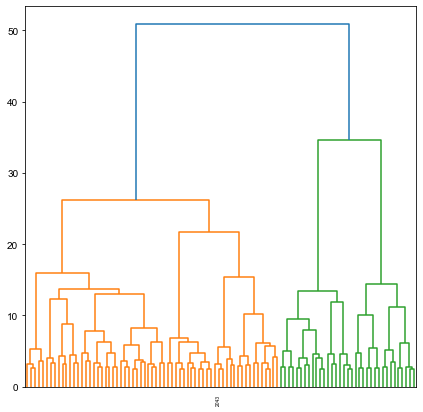

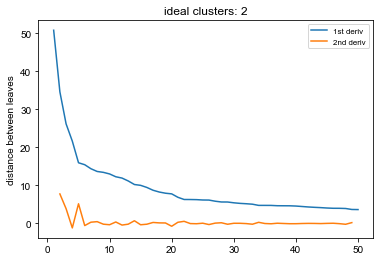

In [5]:
## Set up PDF file if save_pdf=True
if save_pdf:
    pdf_file = mvmnt_file[:-3] + '_temp.pdf'
    pp = PdfPages(pdf_file)
else:
    pp=[]

# Get data into UMAP format
start = time.time()
data, xeye, yeye, mov_rel_jump, mov_rel_start, windows = am.data_to_umap(df_all,'Side')
print('added data to UMAP in %0.1f seconds' % (time.time()-start))
# data, xeye, yeye, xnose, ynose, theta, xnose, ynose, mov_rel_jump, mov_rel_start, windows = am.data_to_umap(df_all,'Side')

# Run PCA and K-means clustering and run UMAP embedding on PCA
pca_components = 10
start = time.time()
pca, reduced_data, kmeans, cluster_data, n_k, fig, ax = am.run_pca_kmeans(data,pca_components,save_pdf,pp)
print('finished PCA in %0.1f seconds' % (time.time()-start))

# Create the labels for the UMAP of PCA data
start = time.time()
labels_all, embedding = am.create_umap_labels(df_all,'Side',kmeans,reduced_data,xeye,yeye,windows,mov_rel_jump,mov_rel_start)
print('created UMAP labels in %0.1f seconds' % (time.time()-start))



# Perform hierarchical clustering
start = time.time()
Z = am.hierarchical_dendrogram(reduced_data,n_guess)
print('finished initial hierarchical clustering in %0.1f seconds' % (time.time()-start))


plt.figure()
last = Z[-50:, 2]
last_rev = last[::-1]
idxs = np.arange(1, len(last) + 1)
plt.plot(idxs, last_rev,label='1st deriv')
acceleration = np.diff(last, 2)  # 2nd derivative of the distances
acceleration_rev = acceleration[::-1]
plt.plot(idxs[:-2] + 1, acceleration_rev,label='2nd deriv')
plt.ylabel('distance between leaves')
plt.legend(fontsize=8)
k = acceleration_rev.argmax() + 2  # if idx 0 is the max of this we want 2 clusters
plt.title("ideal clusters: %d" % k)

# for i in range(11):
#     plt.plot([0,500],[i,i],'k:')

In [ ]:
# # set the duration of the window for individual movements
# pwin = 0.25 #half the movement duration window desired
# metric = 'velocity'
# # nclusts = np.arange(3,16) #range of cluster numbers you want
# n_guess = 100 #int(nclusts[-1])
# # hthresh = 0.01 #min threshold for dendrogram to select the lastp number of clusters
# # Load unclustered data
# start = time.time()
# mvmnt_file = r'T:\variable_platform_mvmnts_%sms_%s.h5' % (int(pwin*1000),metric)
# df_all = pd.read_hdf(mvmnt_file)
# print('loaded data from file in %0.1f seconds' % (time.time()-start))
# df_all['distance_DLC'] = df_all['distance']
# df_all['platform_DLC'] = df_all['platform']

loaded data from file in 3.2 seconds


11 fclusters
finished hierarchical clustering in 128.39 seconds
finished clustering 11 movements


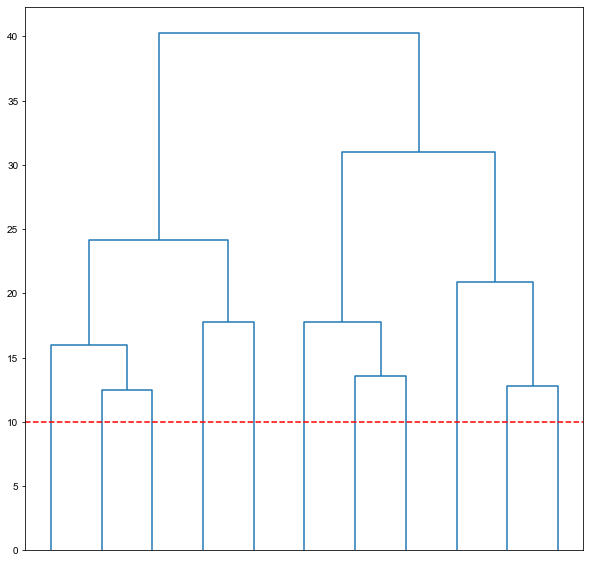

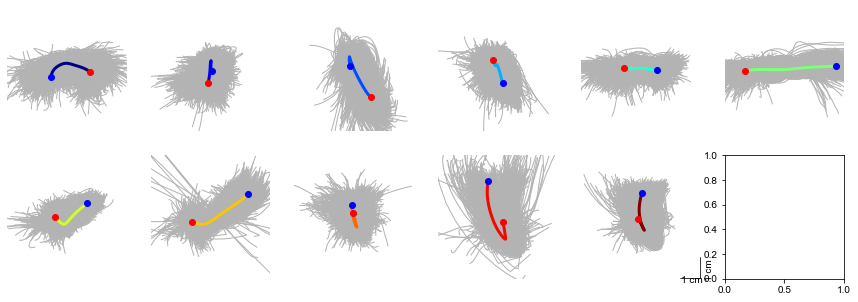

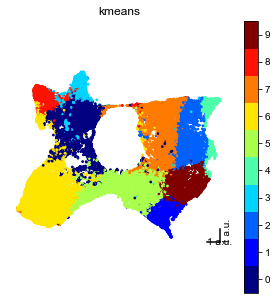

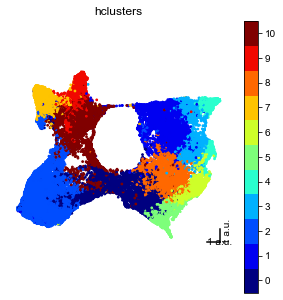

In [44]:
save_pdf=False
# ### clustering parameters
nclust = 11
hthresh = 10
n_guess=100
# for nc,nclust in enumerate(nclusts):

# print('doing %d clusters (%d/%d total)' % (nclust,(nc+1),len(nclusts)))

start = time.time()
labels_clust, n_k, fig1, fig2 = am.hierarchical_clustering(labels_all,'Side',reduced_data,Z,hthresh,int(nclust),plot_params,save_pdf,pp)
print('finished hierarchical clustering in %0.2f seconds' % (time.time()-start))

# UMAP of PCA with variables mapped onto points with colors (kmeans, hierarchical)
fig, ax = am.plot_UMAP_labels(labels_clust,'kmeans',plot_params,save_pdf,pp)
fig, ax = am.plot_UMAP_labels(labels_clust,'hclusters',plot_params,save_pdf,pp)


# Order the clusters by variance (high to low)
labels_clust = am.order_clusters_by_variance(labels_clust,'Side','kmeans')
labels_clust = am.order_clusters_by_variance(labels_clust,'Side','hclusters')

# Calculate movement amplitudes
labels_clust = am.get_movement_amplitudes(labels_clust,'Side')

# Interactive UMAP visualization (optional)
if show_UMAP:
    p = am.play_fn(x,y,theta, embedding, pdf_file[:-4] + '.hmtl')

trial_length = []
for index,row in df_all.iterrows():
    trial_length.append((row['Top_Jump']-row['Top_Start'])/100)
df_all['trial_length'] = trial_length

# Save the df and labels
df_pickle = mvmnt_file[:-3] + '_df.h5'
labels_pickle = mvmnt_file[:-3] + '_labels.h5'
df_all.to_hdf(df_pickle,key='df',mode='w')
labels_clust.to_hdf(labels_pickle,key='df',mode='w')

# Close the clustering PDF
if save_pdf:
    pp.close()
    try:
        os.rename(os.path.normpath(pdf_file),
                  os.path.normpath(pdf_file[:-9] + '_normpca_clustering_%dclusts.pdf' % (n_k)))
        print('Saved clustering PDF')
    except:
        os.remove(os.path.normpath(pdf_file[:-9] + '_normpca_clustering_%dclusts.pdf' % (n_k)))
        os.rename(os.path.normpath(pdf_file),
                  os.path.normpath(pdf_file[:-9] + '_normpca_clustering_%dclusts.pdf' % (n_k)))
        print('Saved clustering PDF')

print('finished clustering %d movements' % n_k)

#     ### manually load clustered data
#     n_k = 2 #number of clusters in the dataset
#     df_pickle = mvmnt_file[:-3] + '_df_%dclusts.h5' % n_k
#     labels_pickle = mvmnt_file[:-3] + '_labels_%dclusts.h5' % n_k
#     df_all = pd.read_hdf(df_pickle)
#     labels_all = pd.read_hdf(labels_pickle)
#     df_all = df_all.astype({'success': 'int32'})
# df_all[df_all['success']==2] = df_all[df_all['success']==2].replace(2,0)
# df_all.loc[:,'jumpdist'] = df_all['jumpdist'].astype('float')
# labels_all[labels_all['success']==2] = labels_all[labels_all['success']==2].replace(2,0)

# Plot clustered movement analyses

In [3]:
pwin = 0.25 #half the movement duration window desired
# metric = 'position'
metric = 'velocity'
mvmnt_file = r'T:\jumping_revisions_analysis\variable_platform_mvmnts_%sms_%s.h5' % (int(pwin*1000),metric)
df_pickle = mvmnt_file[:-3] + '_df.h5'
labels_pickle = mvmnt_file[:-3] + '_labels.h5'
df_all = pd.read_hdf(df_pickle,key='df')
labels_all = pd.read_hdf(labels_pickle,key='df')

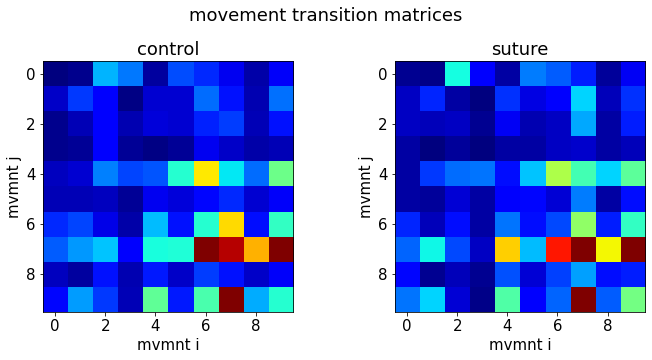

In [219]:
fig , axs = plt.subplots(1,2,figsize=(10,5))
axs = axs.ravel()
for c,cond in enumerate(conds):
    ax = axs[c]
    im = ax.imshow(tmat_hclust[:,:,c],vmin=0,vmax=0.05,cmap='jet')
    ax.set_title(cond)
    ax.set_xlabel('mvmnt i')
    ax.set_ylabel('mvmnt j')
plt.colorbar(im, ax=ax, ticks = np.arange(0,0.25,0.05))
fig.suptitle('movement transition matrices')
fig.tight_layout()

In [14]:
side = 'Side'
cluster_key = 'hclusters'
# cluster_key = 'kmeans'

pdf_file = mvmnt_file[:-3] + '_baseline_group_plots_normpca_%d_%sclusts_movements.pdf' % (len(np.unique(labels_all[cluster_key])),cluster_key)
pp = PdfPages(pdf_file)

hclusters_seq = []
for index,row in df_all.iterrows():
    h = labels_all[cluster_key].iloc[np.where((labels_all['subject']==row['subject'])&(labels_all['expdate']==row['expdate'])&(labels_all['trial']==row['trial']))[0]].to_numpy()
    hclusters_seq.append(h)
df_all['hclusters_seq'] = hclusters_seq

conds = ['control','suture']
n_hclust = len(np.unique(labels_all[cluster_key]))
tmat_hclust = np.zeros((n_hclust,n_hclust,len(conds)))

for c,cond in enumerate(conds):
    hclusters_seq = df_all['hclusters_seq'][df_all['condition']==cond]
    for seq in hclusters_seq:
        if len(seq>1):
            for i in np.arange(n_hclust):
                for j in np.arange(n_hclust):
                    cnt=0
                    i_inds = np.where(seq==i)[0]
                    if len(i_inds)>0:
                        i_inds += 1
                        if i_inds[-1]>=len(seq):
                            i_inds = i_inds[:-1]
                        if len(i_inds)>0:
                            for ind in i_inds:
                                if seq[ind]==j:
                                    cnt += 1
                            tmat_hclust[i,j,c] = tmat_hclust[i,j,c] + cnt
    tmat_hclust[:,:,c] /= np.sum(np.sum(tmat_hclust[:,:,c]))

# for col in range(tmat_hclust.shape[1]):
#     tmat_hclust[col,col] = 0

base_df = df_all.copy()
base_df = base_df[(base_df['condition']=='control')|(base_df['condition']=='suture')]
base_df.reset_index(inplace=True,drop=True)
base_labels = labels_all.copy()
base_labels = base_labels[(base_labels['condition']=='control')|(base_labels['condition']=='suture')]
base_labels.reset_index(inplace=True,drop=True)

vmax=0.05
fig , axs = plt.subplots(1,2,figsize=(4,2))
axs = axs.ravel()
for c,cond in enumerate(conds):
    ax = axs[c]
    im = ax.imshow(tmat_hclust[:,:,c],vmin=0,vmax=0.05,cmap='jet')
    ax.set_title(cond)
    ax.set_xlabel('mvmnt i')
    ax.set_ylabel('mvmnt j')
plt.colorbar(im, ax=ax, ticks = np.arange(0,vmax+vmax/5,vmax/5))
# fig.suptitle('movement transition matrices')
fig.tight_layout()
pp.savefig(fig)
plt.close(fig)

condition = 'ocular'
fig, ax = am.plot_movement_clusters(base_df,base_labels,side,cluster_key,condition,plot_params,True,pp)
fig, ax = am.plot_cluster_freq(base_df,base_labels,cluster_key,condition,plot_params['bm_col'],True,pp)
fig, ax = am.plot_movement_timing(base_labels,side,cluster_key,condition,0.025,-5,0.5,pwin,plot_params,True,pp)


trial_length = []
for index,row in df_all.iterrows():
    trial_length.append((row['Top_Jump']-row['Top_Start'])/100)
df_all['trial_length'] = trial_length


### baseline behavior
df_cond = df_all[(df_all['condition']=='control')|(df_all['condition']=='suture')]#|(df_all['success']!=2)]
df_cond.reset_index(inplace=True,drop=True)
labels_cond = labels_all[(labels_all['condition']=='control')|(labels_all['condition']=='suture')]#|(labels_all['success']!=2)]
labels_cond.reset_index(inplace=True,drop=True)

condition = 'ocular'
am.plot_movs_per_sec(df_cond,labels_cond,condition,cluster_key,0,1,plot_params['bm_col'],True,pp,suptitle='')
am.plot_variable_vs_distance_manipulation(df_cond,'trial_length','success',condition,8,24,plot_params['bm_col'],True,pp,suptitle='')


### binocular opto
df_cond = df_all[(df_all['condition']=='controlopto')]
df_cond.reset_index(inplace=True,drop=True)
labels_cond = labels_all[(labels_all['condition']=='controlopto')]
labels_cond.reset_index(inplace=True,drop=True)

condition = 'laser_trial'
am.plot_movs_per_sec(df_cond,labels_cond,condition,cluster_key,0,1,plot_params['laser_col'],True,pp,suptitle='')
am.plot_variable_vs_distance_manipulation(df_cond,'trial_length','expt_group',condition,8,24,plot_params['laser_col'],True,pp,suptitle='')


### monocular opto
df_cond = df_all[(df_all['condition']=='sutureopto')]
df_cond.reset_index(inplace=True,drop=True)
labels_cond = labels_all[(labels_all['condition']=='sutureopto')]
labels_cond.reset_index(inplace=True,drop=True)

condition = 'laser_trial'
am.plot_movs_per_sec(df_cond,labels_cond,condition,cluster_key,0,1,plot_params['laser_col'],True,pp,suptitle='')
am.plot_variable_vs_distance_manipulation(df_cond,'trial_length','expt_group',condition,8,24,plot_params['laser_col'],True,pp,suptitle='')

pp.close()

print('finished plotting movement data for %s %d' % (cluster_key,len(np.unique(labels_all[cluster_key]))))

finished plotting movement data for hclusters 10


# visualize movements

In [2]:
pwin = 0.25 #half the movement duration window desired
# metric = 'position'
metric = 'velocity'
mvmnt_file = r'T:\jumping_revisions_analysis\variable_platform_mvmnts_%sms_%s.h5' % (int(pwin*1000),metric)
df_pickle = mvmnt_file[:-3] + '_df.h5'
labels_pickle = mvmnt_file[:-3] + '_labels.h5'
df_all = pd.read_hdf(df_pickle,key='df')
labels_all = pd.read_hdf(labels_pickle,key='df')
print('%d hclusters %s' % (len(np.unique(labels_all['hclusters'])),metric))

10 hclusters velocity


### make bob videos (not currently working)

In [45]:
# #make_bob_vids not working with this dataset for some reason, maybe hard coding?
# idxs = [100,300,900,1200]
# cluster_key = 'hclusters'
# base_path = r'T:\jumping_revisions_labeled_vids'
# vid_path = r'T:\jumping_revisions'
# side = 'Side'
# tdown = 1
# sdown = 1

# am.make_bob_vids(base_df,base_labels,idxs,cluster_key,base_path,vid_path,side,tdown,sdown)

created 012922_PVCHA7LT_control_47_SIDEcalib.avi
created 013022_PVCHA7LT_control_34_SIDEcalib.avi
created 020122_PVCHA7RT_control_21_SIDEcalib.avi
created 020222_PVCHA7RT_control_10_SIDEcalib.avi


### find example movements w/highest correlation to mean and visualize them

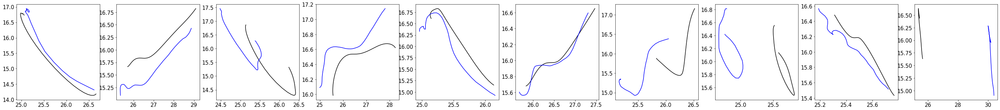

In [223]:
cluster_key = 'hclusters'

base_df = df_all.copy()
base_df = base_df[(base_df['condition']=='control')|(base_df['condition']=='suture')]
base_df.reset_index(inplace=True,drop=True)
base_labels = labels_all.copy()
base_labels = base_labels[(base_labels['condition']=='control')|(base_labels['condition']=='suture')]
base_labels.reset_index(inplace=True,drop=True)

n_k = len(np.unique(base_labels[cluster_key]))
cc_to_mean = np.zeros((len(base_labels),n_k))
best_ind = np.zeros(n_k).astype(int)

fig, axs = plt.subplots(1,n_k,figsize=(5*n_k,5))
axs = axs.ravel()

for K in range(n_k):
    ax = axs[K]
    idxs = np.where(base_labels[cluster_key]==K)[0]

    x = base_labels['Side_x_eye_mvmnt'][idxs].mean()
    y = base_labels['Side_y_eye_mvmnt'][idxs].mean()
    ax.plot(x,y,'k')

    cc = [np.corrcoef(np.hstack([x,y]),np.hstack([tx,ty]))[0,1] for tx,ty in zip(base_labels['Side_x_eye_mvmnt'],base_labels['Side_y_eye_mvmnt'])]
    cc_to_mean[:,K] = np.array(cc)
    best_ind[K] = np.argmax(cc_to_mean[:,K])

    x = base_labels['Side_x_eye_mvmnt'][best_ind[K]]
    y = base_labels['Side_y_eye_mvmnt'][best_ind[K]]
    ax.plot(x,y,'b')

    


In [160]:
pdf_file = mvmnt_file[:-3] + '_baseline_group_plots_normpca_%d_%sclusts_example_movements.pdf' % (len(np.unique(labels_all[cluster_key])),cluster_key)
pp = PdfPages(pdf_file)

vid_dir = r'T:\jumping_revisions'
fig, axs = plt.subplots(1,n_k,figsize=(5*n_k,5))
axs = axs.ravel()

for b,best in enumerate(best_ind):
    ax = axs[b]
    row = base_labels.iloc[int(best)]
    vid_file = am.vidname_from_row(vid_dir,side,row)
    df_row = am.df_row_from_labels(base_df,row)
    frame,fps,frame_width,frame_height,ret = am.grab_vidframe(vid_file,int(row['Side_windows'])+int(df_row['Side_Start']))
    ax.imshow(frame)

    dlc_file = am.dlc_file_from_row(vid_dir,side,row)
    pts = pd.read_hdf(dlc_file)
    pts.columns = [' '.join(col[:][1:3]).strip() for col in pts.columns.values]
    eye_x = pts['LEye x'][int(df_row['Side_Start']+row['Side_windows']):int(df_row['Side_Start']+row['Side_windows']+pwin*2*df_row['fps'])].to_numpy()
    eye_y = pts['LEye y'][int(df_row['Side_Start']+row['Side_windows']):int(df_row['Side_Start']+row['Side_windows']+pwin*2*df_row['fps'])].to_numpy()

    ax.plot(eye_x,eye_y,'k',linewidth=5,label='movement')
    ax.plot(eye_x[0],eye_y[0],'bo',markersize=10,label='start')
    ax.plot(eye_x[-1],eye_y[-1],'ro',markersize=10,label='end')
    ax.axis([800,1200,800,400])
    ax.set_title('cluster %d' % (b+1))
    ax.axis('off')
ax.legend(loc=3)
fig.tight_layout()
pp.savefig(fig)
plt.close(fig)


condition = 'ocular'
fig, ax = am.plot_movement_clusters(base_df,base_labels,side,cluster_key,condition,plot_params,True,pp)

pp.close()

### plot movements and their relationship to performance/accuracy

In [224]:
df_clust = df_all.copy()
# df_clust = am.get_jump_accuracy(df_clust)
labels_clust = am.get_movement_amplitudes_mm(labels_clust,'Side')
labels_clust.loc[:,'jumpdist'] = labels_clust['jumpdist'].astype('float')

###### Baseline group analysis
base_df = df_clust.copy()
base_df = base_df[(base_df['condition']=='control')|(base_df['condition']=='suture')]
# base_df = base_df[base_df['laser_trial']=='laser off']
base_df.reset_index(inplace=True,drop=True)
# base_df[base_df['condition']=='opto suture'] = base_df[base_df['condition']=='opto suture'].replace('opto suture','suture')
base_labels = labels_clust.copy()
base_labels = base_labels[(base_labels['condition']=='control')|(base_labels['condition']=='suture')]
# base_labels = base_labels[base_labels['laser_trial']=='laser off']
base_labels.reset_index(inplace=True,drop=True)
# base_labels[base_labels['condition']=='opto suture'] = base_labels[base_labels['condition']=='opto suture'].replace('opto suture','suture')


cluster_key = 'hclusters'
# cluster_key = 'kmeans'
condition = 'ocular'
side = 'Side'


## Set up group plot PDF file if save_pdf=True
if save_pdf:
    pdf_file = mvmnt_file[:-3] + '_baseline_group_plots_normpca_%d_%sclusts.pdf' % (len(np.unique(base_labels[cluster_key])),cluster_key)
    pp = PdfPages(pdf_file)
else:
    pp=[]


# Analyze movements from kmeans clustering of PCA data (group, individual)
fig, ax = am.plot_movement_clusters(base_df,base_labels,side,cluster_key,condition,plot_params,save_pdf,pp)
fig, ax = am.plot_cluster_freq(base_df,base_labels,cluster_key,condition,plot_params,save_pdf,pp)
fig, ax = am.plot_movement_timing(base_labels,side,cluster_key,condition,-5,0.5,pwin,plot_params,save_pdf,pp)

for cluster_num in range(len(np.unique(base_labels[cluster_key]))):
    fig, ax = am.plot_movement_trace_distance(base_labels,side,cluster_num,cluster_key,condition,plot_params,save_pdf,pp)
    base_df = am.label_bob_frequency(base_df,base_labels,cluster_key,cluster_num)
    fig, ax = am.plot_performance_bob_freq(base_df,condition,'bob_freq',1,save_pdf,pp,suptitle='cluster %d' % cluster_num)
    fig, ax = am.plot_variable_vs_distance(base_df,'bob_freq',condition,0,6,plot_params['cond_col'],save_pdf,pp,suptitle='cluster %d' % cluster_num)
    fig, ax = am.plot_movement_amplitudes(base_labels,cluster_num,cluster_key,'ocular',plot_params,save_pdf,pp)

### create lists of platform widths and gap distances to get retinal image size
# pfs = np.around(np.array([4,8,12])*2.54,decimals=1)
# ds = np.around(np.arange(8,28,4),decimals=1)
# ris, fig, ax = am.make_ris_table(pfs,ds,save_pdf,pp)

fig, ax = am.plot_performance(base_df,condition,1,8,24,plot_params,save_pdf,pp)
fig, ax = am.plot_jump_accuracy(base_df,condition,'success',plot_params,save_pdf,pp,'accuracy vs. success')
fig, ax = am.plot_jumpdist(base_df,condition,8,24,plot_params,save_pdf,pp)
fig, ax = am.plot_performance_platforms(base_df,condition,1,8,24,plot_params,save_pdf,pp)
# fig, ax = am.plot_ris_distance(base_df,condition,ris,plot_params,save_pdf,pp)
fig, ax = am.plot_jumpdist_platforms(base_df,condition,5,25,plot_params,save_pdf,pp)

### close the group PDF
try:
    pp.close()
except:
    pass

print('finished plotting data for %d %s clusters!' % (len(np.unique(base_labels[cluster_key])),cluster_key))
# print('finished analysis for animal %d/%d' % (aninum+1,len(anis)))


### old

# fig, ax = am.plot_movement_timing(base_labels,'Side','hclusters','ocular',plot_params,save_pdf,pp)
# base_df = am.label_any_bob_trials(base_df,base_labels,'hclusters')
# fig, ax = am.plot_performance_vs_movement(base_df,base_labels,' any mvmt','hclusters','ocular',plot_params,save_pdf,pp)

# for cluster_num in range(n_k):
#     fig, ax = am.calculate_movement_frequency(base_df,base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_movement_amplitudes(base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_yamps_mm(base_labels,cluster_num,'hclusters','ocular',1,4,plot_params,save_pdf,pp)
#     fig, ax = am.plot_visangles(base_labels,cluster_num,'hclusters','ocular',1,plot_params,save_pdf,pp)
#     fig, ax = am.plot_performance_vs_movement(base_df,base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#     base_df = am.label_bob_trials(base_df,base_labels,'hclusters',cluster_num)
#     fig, ax = am.plot_jump_accuracy(base_df,'ocular','bob_trial',cluster_num,plot_params,save_pdf,pp)

finished plotting data for 10 hclusters clusters!


In [151]:
# pwin = 0.25 #half the movement duration window desired
# metric = 'velocity'
# # metric = 'position'
# mvmnt_file = r'T:\variable_platform_mvmnts_%sms_%s.h5' % (int(pwin*1000),metric)
# df_all = pd.read_hdf(mvmnt_file)
# base_df = df_all.copy()
# base_df = base_df[base_df['laser_trial']=='laser off']
# base_df.reset_index(inplace=True,drop=True)
# base_df[base_df['condition']=='opto suture'] = base_df[base_df['condition']=='opto suture'].replace('opto suture','suture')

In [5]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [6]:
save_pdf = False
pp = []

fail/suc/abort anova p vals:  [0.96477813 0.75155311 0.60105287]


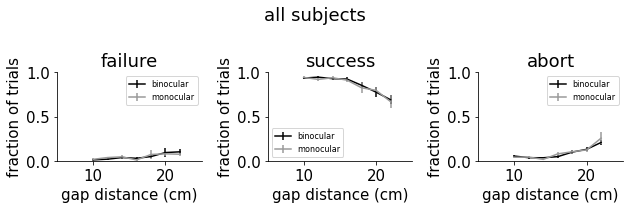

In [31]:
###### Baseline group analysis
df_cond = df_all[(df_all['condition']=='control')|(df_all['condition']=='suture')]
df_cond.reset_index(inplace=True,drop=True)

condition = 'ocular'

fig, axs, array = am.plot_fraction_success(df_cond,condition,plot_params['cond_col'],'-',False,pp,'all subjects')
print('fail/suc/abort anova p vals: ', am.anova_fraction_success(df_cond,array,condition))

fail/suc/abort anova p vals:  [0.00770218 0.00033539 0.00198909]
fail/suc/abort anova p vals:  [0.86404884 0.87185666 0.79284751]


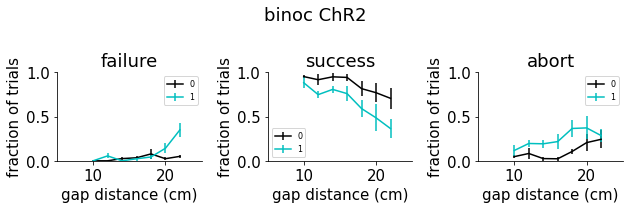

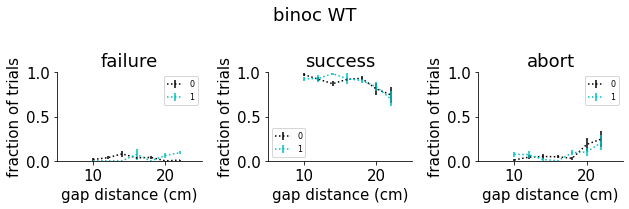

In [32]:
condition = 'laser_trial'

df_cond = df_all[(df_all['condition']=='controlopto')&(df_all['expt_group']=='ChR2')]

fig, axs, array = am.plot_fraction_success(df_cond,condition,plot_params['laser_col'],'-',False,pp,'binoc ChR2')
print('fail/suc/abort anova p vals: ', am.anova_fraction_success(df_cond,array,condition))

df_cond = df_all[(df_all['condition']=='controlopto')&(df_all['expt_group']=='WT')]

fig, axs, array = am.plot_fraction_success(df_cond,condition,plot_params['laser_col'],':',False,pp,'binoc WT')
print('fail/suc/abort anova p vals: ', am.anova_fraction_success(df_cond,array,condition))

fail/suc/abort anova p vals:  [0.12980949 0.53613255 0.76574223]
fail/suc/abort anova p vals:  [0.08752719 0.28075802 0.84490147]


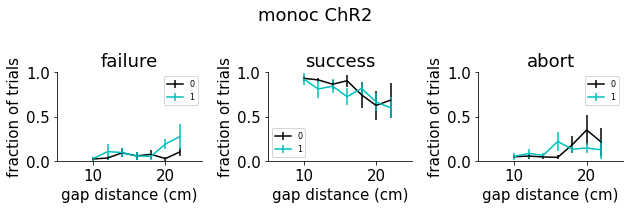

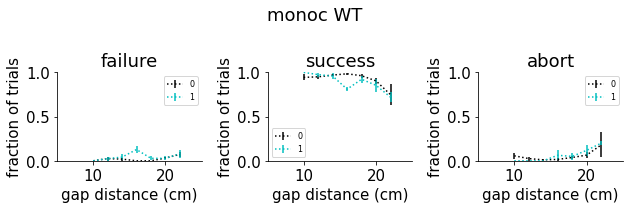

In [33]:
condition = 'laser_trial'

df_cond = df_all[(df_all['condition']=='sutureopto')&(df_all['expt_group']=='ChR2')]

fig, axs, array = am.plot_fraction_success(df_cond,condition,plot_params['laser_col'],'-',False,pp,'monoc ChR2')
print('fail/suc/abort anova p vals: ', am.anova_fraction_success(df_cond,array,condition))

df_cond = df_all[(df_all['condition']=='sutureopto')&(df_all['expt_group']=='WT')]

fig, axs, array = am.plot_fraction_success(df_cond,condition,plot_params['laser_col'],':',False,pp,'monoc WT')
print('fail/suc/abort anova p vals: ', am.anova_fraction_success(df_cond,array,condition))

In [21]:
sm.stats.anova_lm(model, typ=2).loc['C(laser_trial)','PR(>F)']

0.8449014657416041

In [13]:
from matplotlib import cm
# load the df and labels
df_pickle = mvmnt_file[:-3] + '_df.h5'
labels_pickle = mvmnt_file[:-3] + '_labels.h5'
df_all = pd.read_hdf(df_pickle)
labels_all = pd.read_hdf(labels_pickle)

In [7]:
print(temp_labels.shape,base_labels.shape)

(4471, 34) (37504, 34)


# Look at effects of movements of different amplitudes

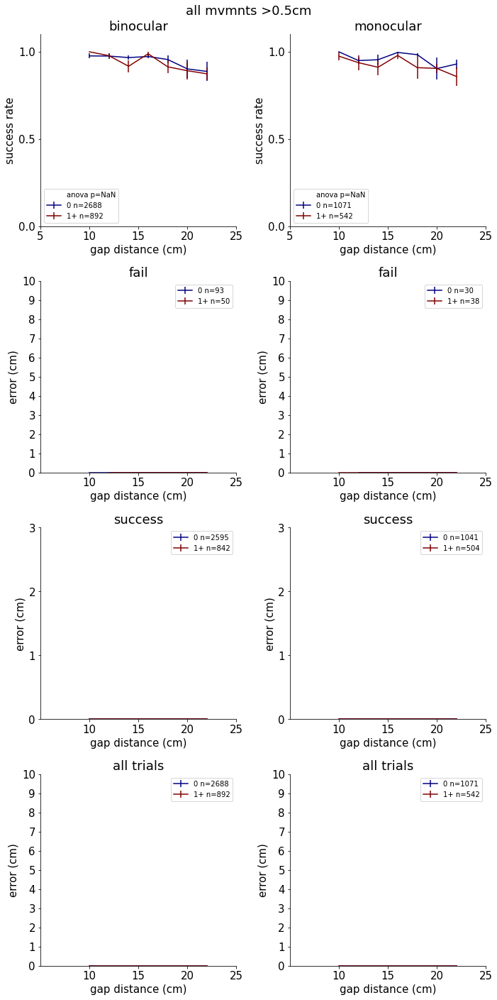

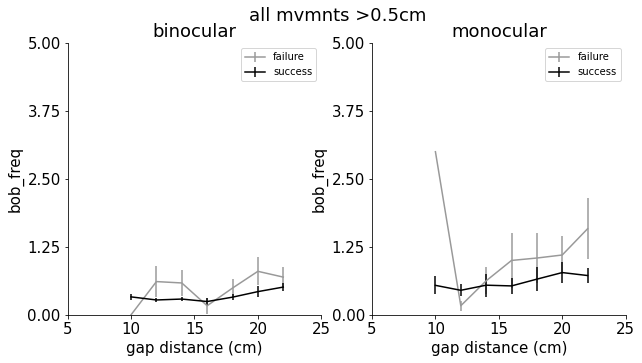

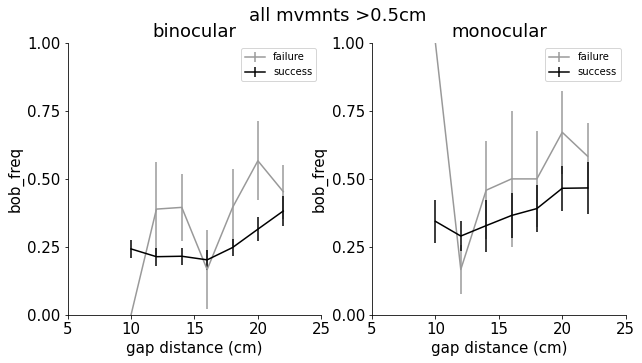

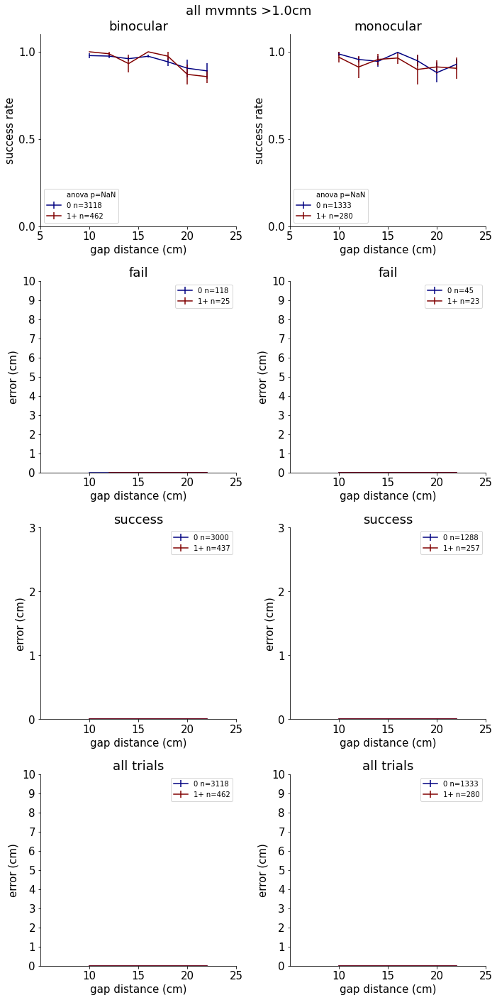

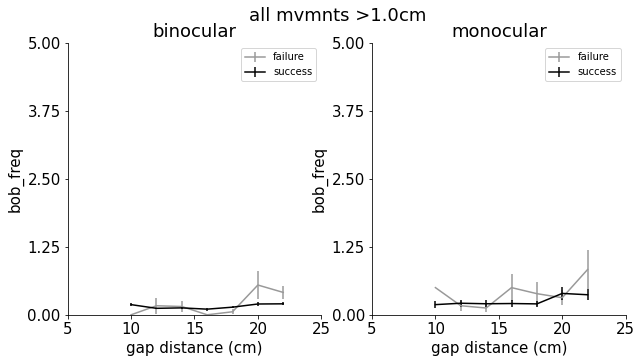

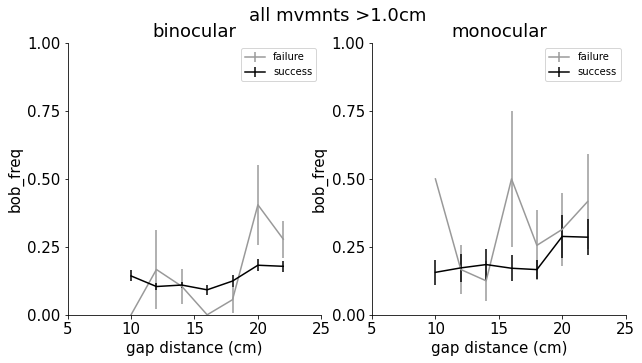

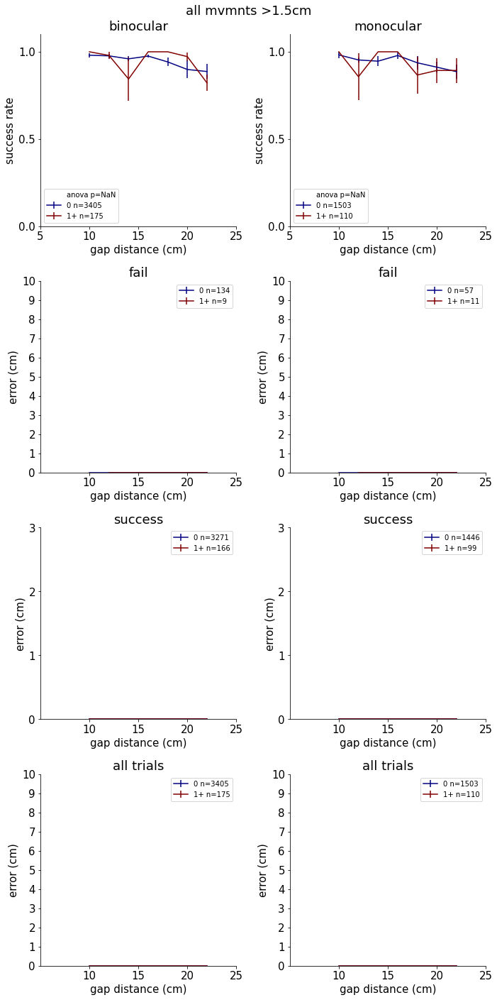

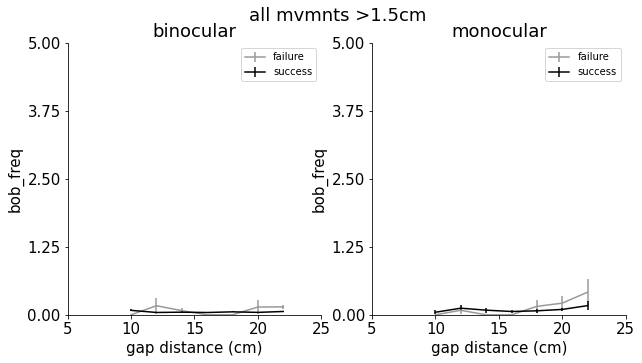

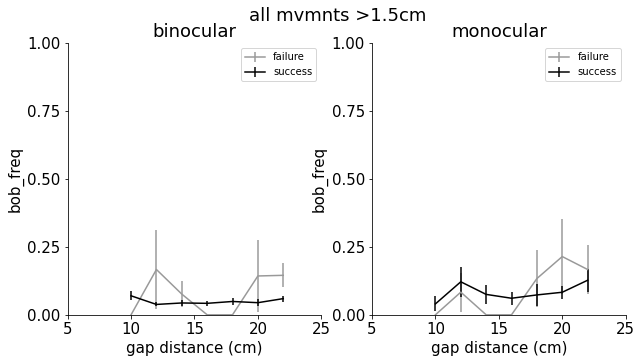

In [21]:
df_clust = df_all.copy()
df_clust = am.get_jump_accuracy(df_clust)
labels_clust = am.get_movement_amplitudes_mm(labels_clust,'Side')
labels_clust.loc[:,'jumpdist'] = labels_clust['jumpdist'].astype('float')

###### Baseline group analysis
base_df = df_clust.copy()
base_df = base_df[(base_df['condition']=='control')|(base_df['condition']=='suture')]
base_df.reset_index(inplace=True,drop=True)
base_labels = labels_clust.copy()
base_labels = base_labels[(base_labels['condition']=='control')|(base_labels['condition']=='suture')]
base_labels.reset_index(inplace=True,drop=True)

bob_freq_label = 'bob_freq'
freq_max = 1
condition = 'ocular'
    
amp_thresholds = [0.5,1.0,1.5]
for amp_thresh in amp_thresholds:
    temp_labels = base_labels[(base_labels['yamps']>amp_thresh)&(base_labels['yamps']>base_labels['xamps'])]
    temp_labels.shape
    base_df = am.label_bob_frequency_multi(base_df,temp_labels,'kmeans',np.arange(10))

    fig, ax = am.plot_performance_bob_freq(base_df,condition,bob_freq_label,1,plot_params,False,[],suptitle='all mvmnts >%0.1fcm' % amp_thresh)
    fig, ax = am.plot_variable_vs_distance(base_df,bob_freq_label,condition,0,5,plot_params,False,[],suptitle='all mvmnts >%0.1fcm' % amp_thresh)
    base_df[bob_freq_label].loc[base_df[bob_freq_label]>0]=1
    fig, ax = am.plot_variable_vs_distance(base_df,bob_freq_label,condition,0,1,plot_params,False,[],suptitle='all mvmnts >%0.1fcm' % amp_thresh)


In [32]:
np.unique(base_df[bob_freq_label])

array([0, 1])

binocular state 0 performance p=NaN
binocular state 0 accuracy p=NaN
monocular state 0 performance p=NaN
monocular state 0 accuracy p=NaN
 
binocular state 1 performance p=NaN
binocular state 1 accuracy p=NaN
monocular state 1 performance p=NaN
monocular state 1 accuracy p=NaN
 
binocular state 2 performance p=NaN
binocular state 2 accuracy p=NaN
monocular state 2 performance p=NaN
monocular state 2 accuracy p=NaN
 
binocular state 3 performance p=NaN
binocular state 3 accuracy p=NaN
monocular state 3 performance p=NaN
monocular state 3 accuracy p=NaN
 
binocular state 4 performance p=NaN
binocular state 4 accuracy p=NaN
monocular state 4 performance p=NaN
monocular state 4 accuracy p=NaN
 
binocular state 5 performance p=NaN
binocular state 5 accuracy p=NaN
monocular state 5 performance p=NaN
monocular state 5 accuracy p=NaN
 
binocular state 6 performance p=NaN
binocular state 6 accuracy p=NaN
monocular state 6 performance p=NaN
monocular state 6 accuracy p=NaN
 
binocular state 7 pe

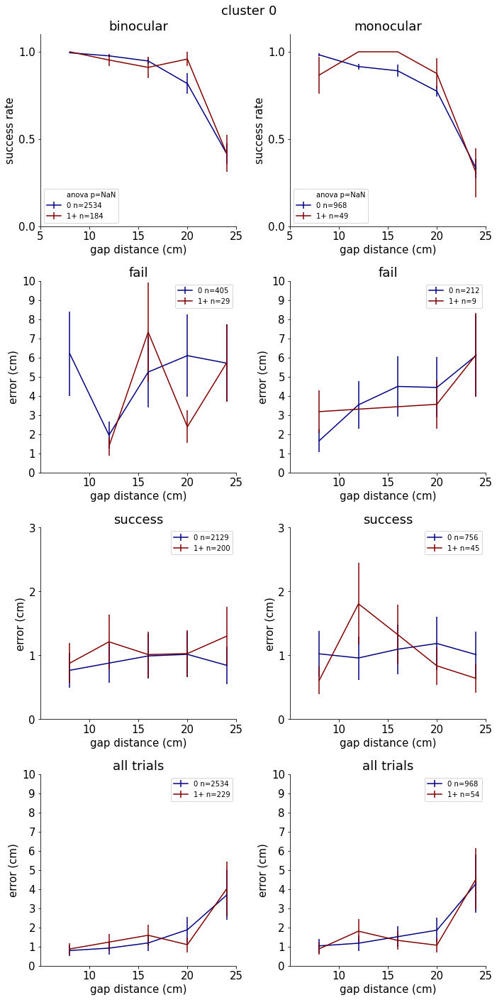

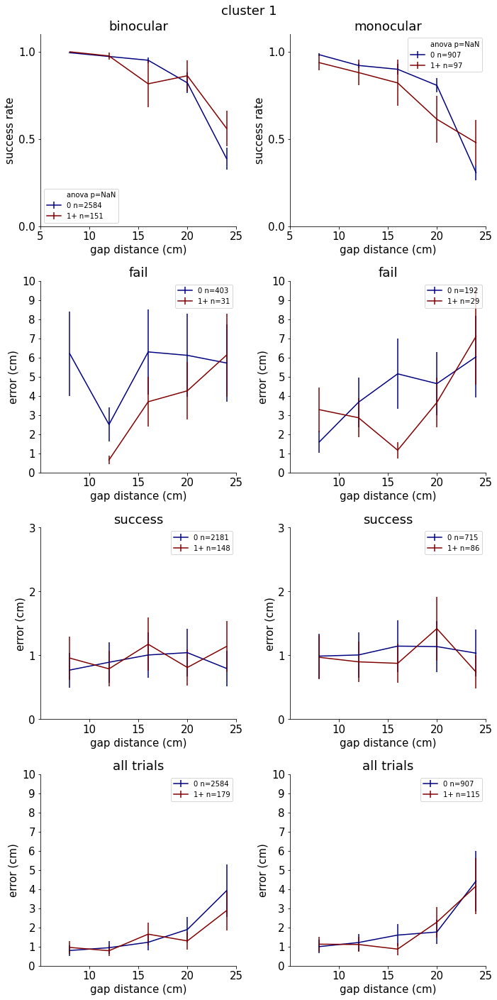

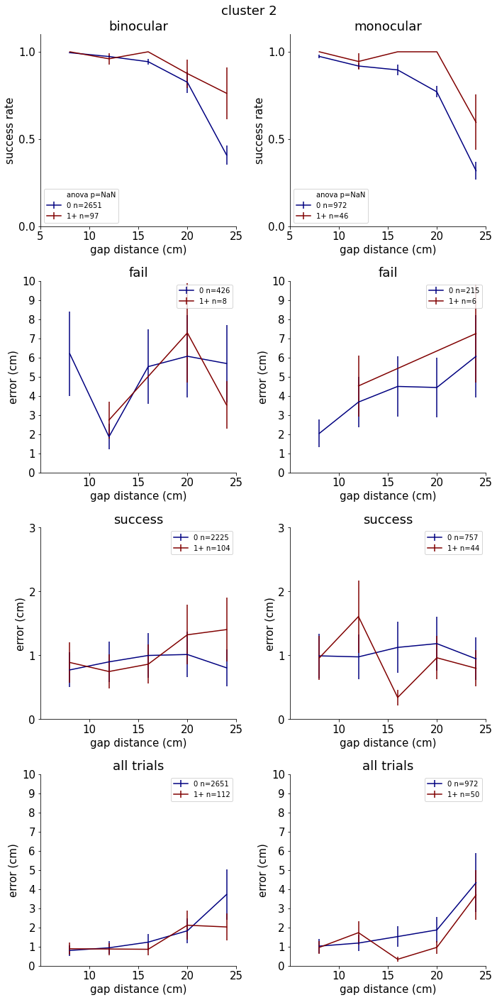

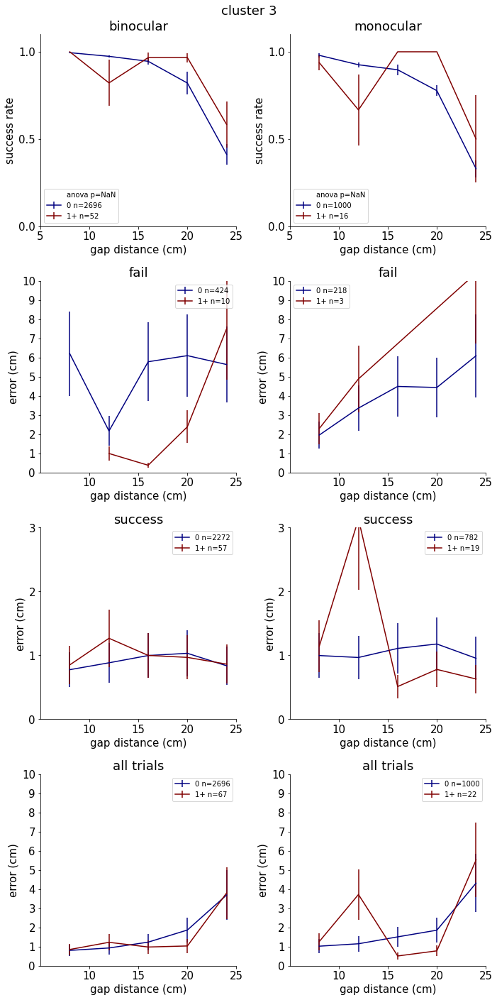

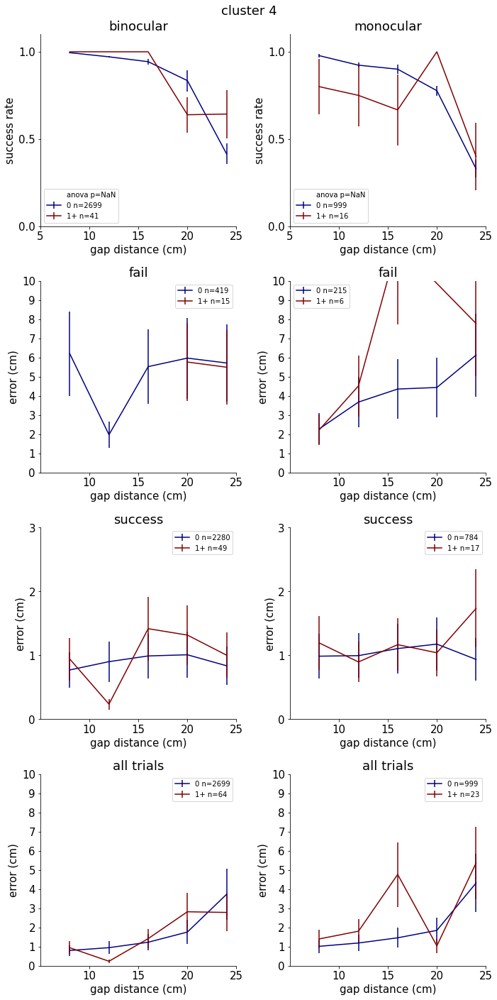

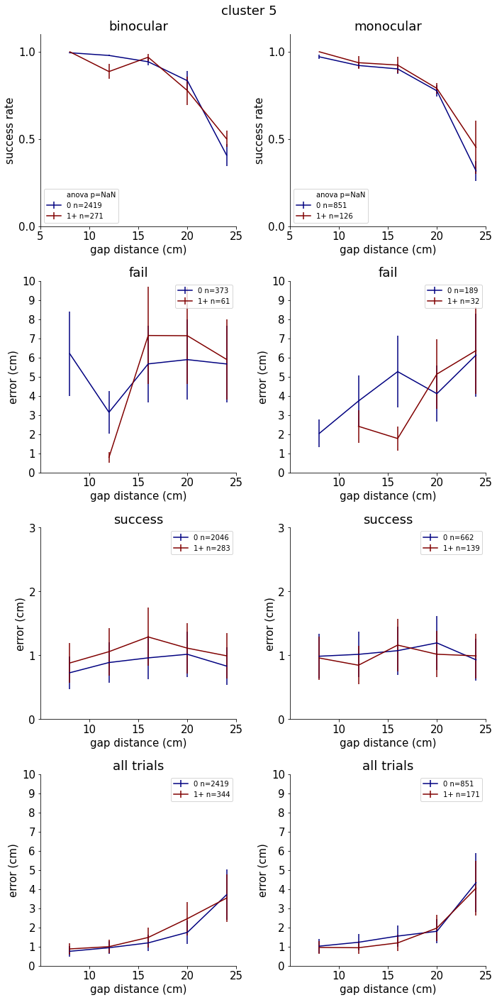

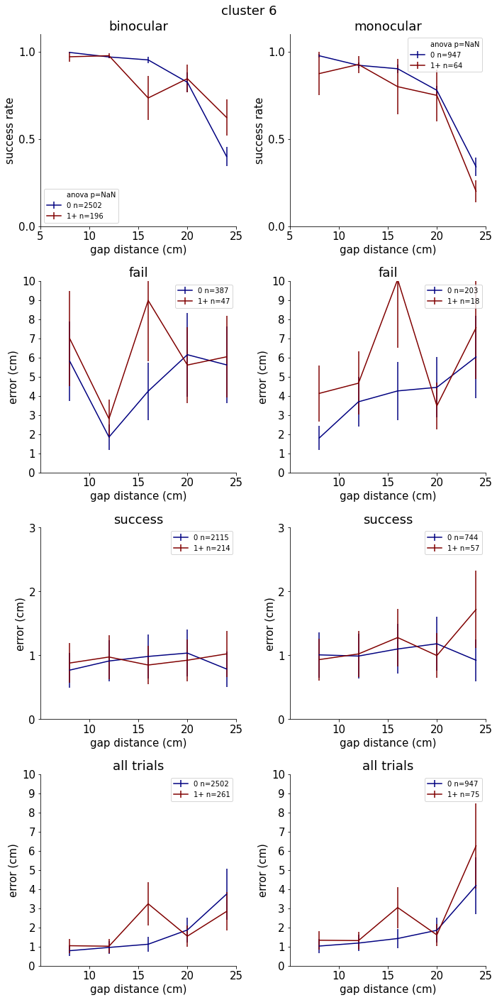

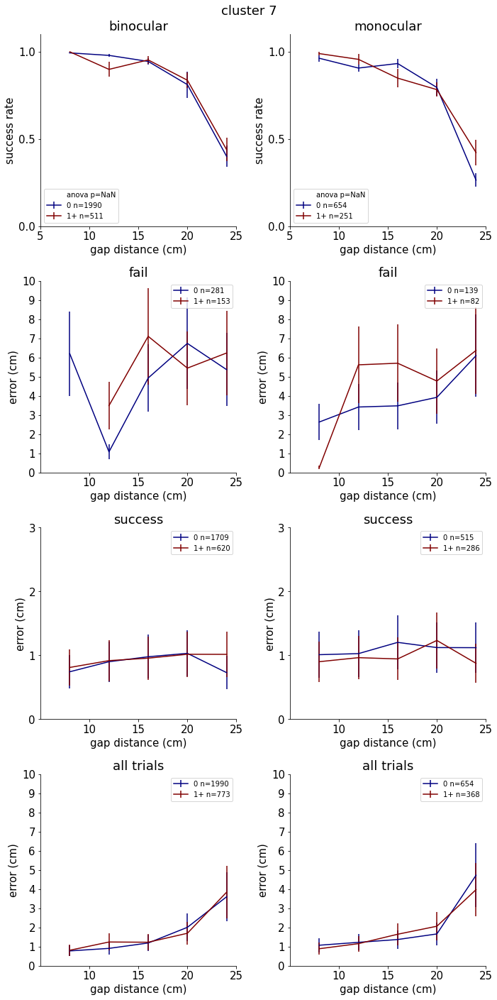

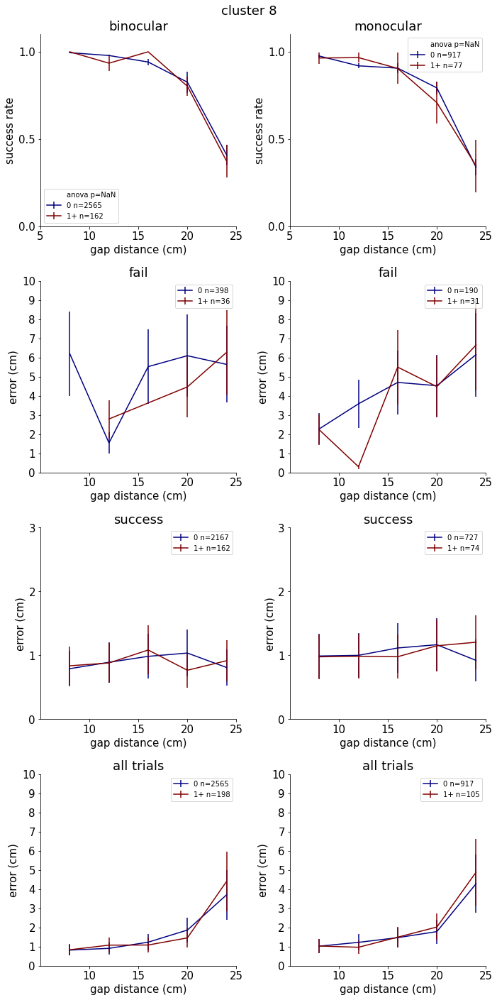

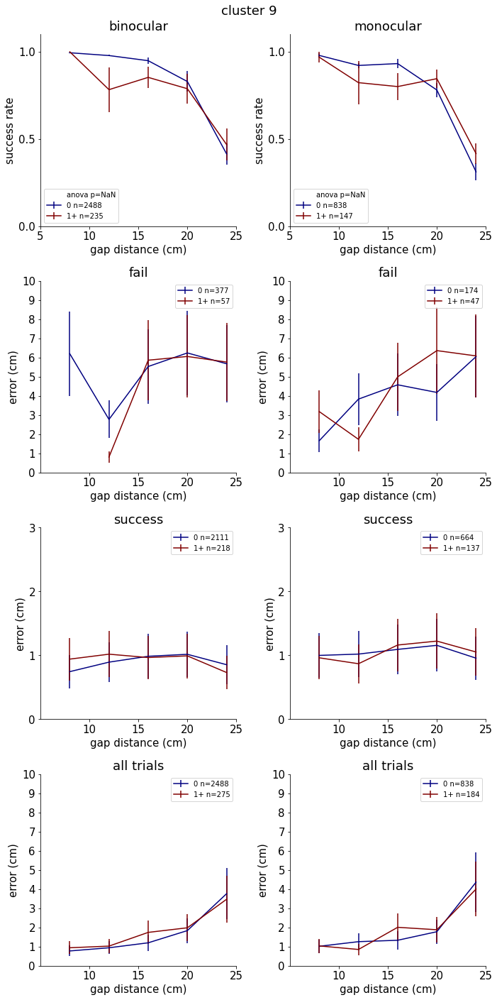

In [14]:
for cluster_num in range(len(np.unique(temp_labels[cluster_key]))):
    base_df = am.label_bob_frequency(base_df,temp_labels,cluster_key,cluster_num)
    fig, ax = am.plot_performance_bob_freq(base_df,condition,'bob_freq',1,plot_params,False,[],suptitle='cluster %d' % cluster_num)
    
    bob_freq_label = 'bob_freq'
    freq_max = 1
    condition = 'ocular'

    df = base_df.copy()
    anis = np.unique(df['subject'])
    dists = np.unique(df['distance'])
    conds = np.unique(df[condition])
    suc_lab = ['fail','success']
    suc_lim = [10,3]
    jet = cm.get_cmap('jet',freq_max+1)
    new_cols = jet(np.linspace(0, 1, freq_max+1))

    # fig, axs = plt.subplots(4,len(conds),figsize=(len(conds)*5,5*4))
    temp_df = am.remove_aborts(df)
    temp_df = temp_df[['subject','distance','success','jumpdist','accuracy',condition,bob_freq_label]]

    for c,cond in enumerate(conds):
    #     stats_array = np.empty((len(anis),len(dists),(freq_max + 1)))
    #     stats_array[:] = np.nan
        anova_df = pd.DataFrame(columns=['distance','freq','success'])

        for freq in np.arange(freq_max+1):

            if freq==0:
                mn = temp_df[(temp_df[bob_freq_label]==freq)&(temp_df[condition]==cond)].groupby(['distance','subject']).mean()
    #             mn.reset_index(inplace=True)
                tot_tr = len(temp_df[(temp_df[bob_freq_label]==freq)&(temp_df[condition]==cond)])
            else:
                mn = temp_df[(temp_df[bob_freq_label]>=freq)&(temp_df[condition]==cond)].groupby(['distance','subject']).mean()
    #             mn.reset_index(inplace=True)
                tot_tr = len(temp_df[(temp_df[bob_freq_label]==freq)&(temp_df[condition]==cond)])

            try:
                for d,dist in enumerate(dists):
    #                 stats_array[:,d,freq] = mn.xs(dist)['success']

                    stats_df = pd.DataFrame(columns=['distance','freq','success'])
                    stats_df['distance']  = pd.Series(np.repeat(dist,len(anis)))
                    stats_df['freq'] = pd.Series(np.repeat(freq,len(anis)))
                    stats_df['success'] = pd.Series(mn.xs(dist)['success'].to_numpy())
                    anova_df = pd.concat([anova_df,stats_df],axis=0)
            except:
                pass

        try:
            #print anova results
            model = ols('success ~ C(distance) + C(freq) + C(distance):C(freq)', data=anova_df).fit()
            anova_stats = sm.stats.anova_lm(model, typ=2)
            print(cond + ' state %s performance p=%0.3f' % (cluster_num,anova_stats['PR(>F)'].loc['C(freq)']))
    #         print(sm.stats.anova_lm(model, typ=2))
    #         print('')
        except:
            print(cond + ' state %s performance p=NaN' % (cluster_num))

        anova_df = pd.DataFrame(columns=['distance','freq','accuracy'])
        for freq in np.arange(freq_max+1):
            if freq==0:
                mn = temp_df[(temp_df[bob_freq_label]==freq)&(temp_df[condition]==cond)].groupby(['distance','subject']).mean()
                tot_tr = len(temp_df[(temp_df[bob_freq_label]==freq)&(temp_df[condition]==cond)])
            else:
                mn = temp_df[(temp_df[bob_freq_label]>=freq)&(temp_df[condition]==cond)].groupby(['distance','subject']).mean()
                tot_tr = len(temp_df[(temp_df[bob_freq_label]>=freq)&(temp_df[condition]==cond)])

            try:
                for d,dist in enumerate(dists):
            #                 stats_array[:,d,freq] = mn.xs(dist)['success']

                    stats_df = pd.DataFrame(columns=['distance','freq','accuracy'])
                    stats_df['distance']  = pd.Series(np.repeat(dist,len(anis)))
                    stats_df['freq'] = pd.Series(np.repeat(freq,len(anis)))
                    stats_df['accuracy'] = pd.Series(mn.xs(dist)['accuracy'].to_numpy())
                    anova_df = pd.concat([anova_df,stats_df],axis=0)
            except:
                pass
        
        try:
            #print anova results
            model = ols('accuracy ~ C(distance) + C(freq) + C(distance):C(freq)', data=anova_df).fit()
            anova_stats = sm.stats.anova_lm(model, typ=2)
            print(cond + ' state %s accuracy p=%0.3f' % (cluster_num,anova_stats['PR(>F)'].loc['C(freq)']))
        except:
            print(cond + ' state %s accuracy p=NaN' % (cluster_num))
    print(' ')

# Tail analysis (just for fun)

In [108]:
def quick_filt(trace):
    mn = np.nanmedian(trace)
    std = np.nanstd(trace)
    upper = mn+std
    lower = mn-std
    idxs = (trace<lower) | (trace>upper)
    trace[idxs]=np.nan
    trace = pd.Series(trace).interpolate().to_numpy() #interp over nans
    trace = pd.Series(trace).fillna(method='bfill').to_numpy() #if first vals are nans fill them
    trace = signal.medfilt(trace,kernel_size=5) #median filter
#     trace = np.convolve(trace, 5, mode='same') #smoothing filter
    return trace

In [109]:
#load the dataframe with all the dlc points
h5file = r'T:\variable_platform_allpts.h5'
df_all = pd.read_hdf(h5file)
print('finished loading data!')

from scipy import signal

finished loading data!


In [110]:
###### Baseline group analysis
df_all = df_all[df_all['laser_trial']=='laser off']
df_all.reset_index(inplace=True,drop=True)
df_all[df_all['condition']=='opto suture'] = df_all[df_all['condition']=='opto suture'].replace('opto suture','suture')

good_inds = []
# quality_thresh = 0.95
tail_pt = 'MidTail'
side = 'Top'
# for index,row in df_all.iterrows():
#     if np.sum(row[side + ' ' + tail_pt + ' likelihood']>quality_thresh)/len(row[side + ' ' + tail_pt + ' likelihood'])>quality_thresh:
#         good_inds.append(index)

tail_df = df_all.copy()#.iloc[good_inds]
# tail_df.reset_index(inplace=True,drop=True)
print('%d good tail trials after quality check (originally %d)' % (len(tail_df),len(df_all)))

4005 good tail trials after quality check (originally 4005)


In [111]:
for index,row in tail_df.iterrows():
    tail_df[side + ' ' + tail_pt + ' x'].loc[index] = quick_filt(row[side + ' ' + tail_pt + ' x'])
    tail_df[side + ' ' + tail_pt + ' y'].loc[index] = quick_filt(row[side + ' ' + tail_pt + ' y'])

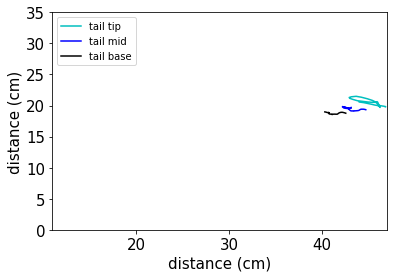

In [112]:
idx = 1000
row = tail_df.iloc[idx]
x_keys = [side + ' TailTip x',side + ' MidTail x',side + ' TailBase x']
y_keys = [side + ' TailTip y',side + ' MidTail y',side + ' TailBase y']
fig, ax = plt.subplots(1,1)

ax.plot(row[side + ' TailTip x'][2:-2]/row[side + '_pixpercm'],row[side + ' TailTip y'][2:-2]/row[side + '_pixpercm'],'c-',label='tail tip')
ax.plot(row[side + ' MidTail x'][2:-2]/row[side + '_pixpercm'],row[side + ' MidTail y'][2:-2]/row[side + '_pixpercm'],'b-',label='tail mid')
ax.plot(row[side + ' TailBase x'][2:-2]/row[side + '_pixpercm'],row[side + ' TailBase y'][2:-2]/row[side + '_pixpercm'],'k-',label='tail base')
ax.set_xlim(int(180/row[side + '_pixpercm']),int(720/row[side + '_pixpercm']))
ax.set_ylim(int(0/row[side + '_pixpercm']),int(540/row[side + '_pixpercm']))
ax.set_xlabel('distance (cm)')
ax.set_ylabel('distance (cm)')
ax.legend(fontsize=10,loc=2)


In [113]:
print(row['expdate'],row['subject'],row['trial'])

062320 PV-CHR11P2RT 5


In [114]:
t_sec = 5
condition = 'ocular'
n_examples = 5 # number of example traces to plot for each animal/condition
save_pdf = True
pdf_file = r'T:\variable_platform_%s_%s_plots.pdf' % (tail_pt,side)
pp = PdfPages(pdf_file)

tail_dists,trial_dur = ([] for i in range(2))

for index,row in tail_df.iterrows():
    td = len(row[side + ' ' + tail_pt + ' x'])/row['fps']
    tail_x = np.diff(row[side + ' ' + tail_pt + ' x']-row[side + ' TailBase x'])/row[side + '_pixpercm']
    tail_y = np.diff(row[side + ' ' + tail_pt + ' y']-row[side + ' TailBase y'])/row[side + '_pixpercm']
    tail_dists.append(np.nansum(np.sqrt(tail_x**2 + tail_y**2)[2:-2])/td)#/(1/row['fps']))[idxs]
    trial_dur.append(td)

tail_df['tail_dists'] = tail_dists
tail_df['trial_dur'] = trial_dur

am.plot_variable_vs_distance(tail_df,'tail_dists',condition,0,100,plot_params,save_pdf,pp,suptitle='tail tip total distance traveled/trial duration')
am.plot_variable_vs_distance(tail_df,'trial_dur',condition,0,10,plot_params,save_pdf,pp,suptitle='trial duration (s)')
am.plot_tail_distance(df_all,tail_pt,t_sec,condition,side,n_examples,plot_params,save_pdf,pp)

pp.close()

finished plotting group averages
finished plotting animal 1 of 8
finished plotting animal 2 of 8
finished plotting animal 3 of 8
finished plotting animal 4 of 8
finished plotting animal 5 of 8
finished plotting animal 6 of 8
finished plotting animal 7 of 8
finished plotting animal 8 of 8


In [115]:
### tail tracking quality too low to make any conclusions here...

# Loop over animals and cluster/analyze

loaded data from file in 3.2 seconds
data shape:  (10462, 60)
added data to UMAP in 0.0 seconds
finished PCA in 9.9 seconds
embedded data shape:  (10462, 2)
labels shape:  (10462, 21)
labels keys:  ['subject', 'expdate', 'distance', 'success', 'platform', 'jumpdist', 'condition', 'ocular', 'trial', 'laser_trial', 'Side_windows', 'Side_mov_rel_jump', 'Side_mov_rel_start', 'subject_id', 'distance_id', 'condition_id', 'kmeans', 'embedding_x', 'embedding_y', 'Side_x_eye_mvmnt', 'Side_y_eye_mvmnt']
created UMAP labels in 20.8 seconds
finished calculating linkage!
finished initial hierarchical clustering in 4.6 seconds
5 fclusters
finished hierarchical clustering in 14.68 seconds
Saved clustering PDF
finished clustering  5 movements
finished analysis for animal 1/8
data shape:  (7197, 60)
added data to UMAP in 0.0 seconds
finished PCA in 6.1 seconds
embedded data shape:  (7197, 2)
labels shape:  (7197, 21)
labels keys:  ['subject', 'expdate', 'distance', 'success', 'platform', 'jumpdist', 'c

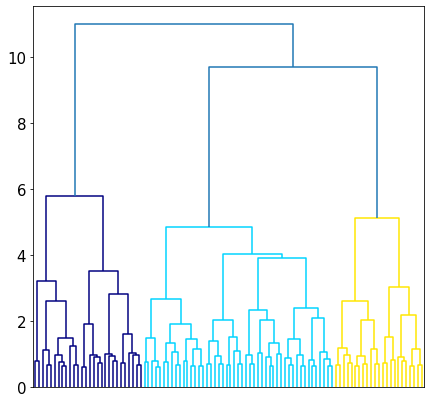

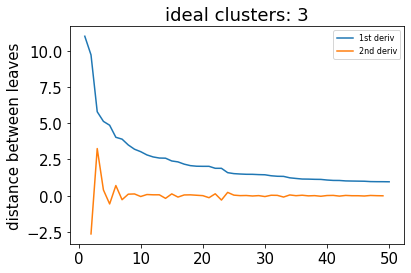

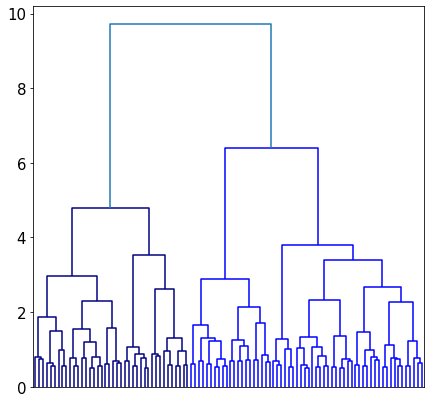

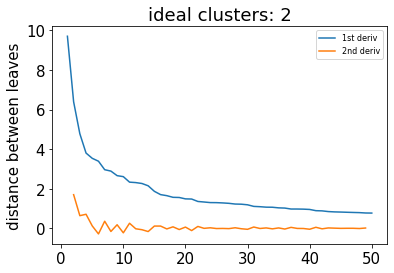

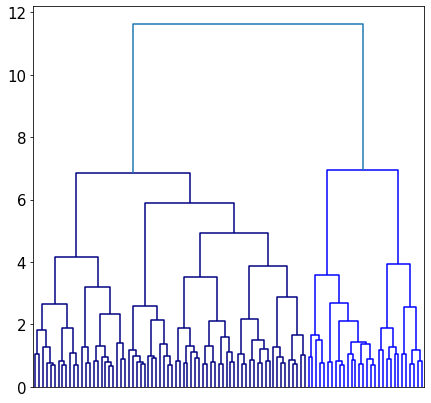

...

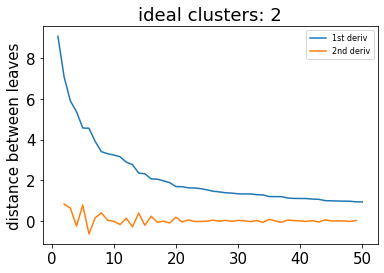

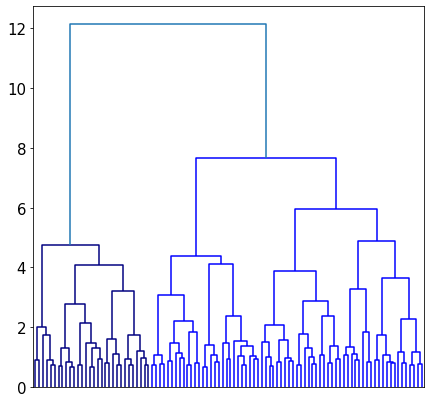

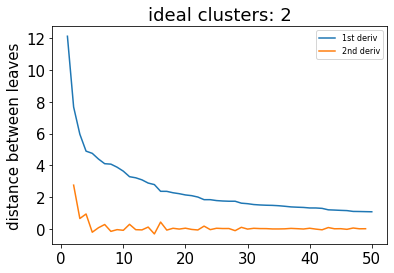

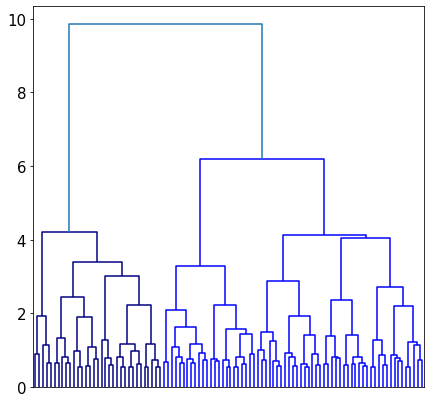

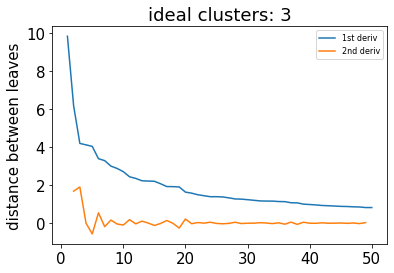

In [4]:
# set the duration of the window for individual movements
pwin = 0.25 #half the movement duration window desired
# nclusts = np.arange(3,16) #range of cluster numbers you want
n_guess = 100 #int(nclusts[-1])
# hthresh = 0.01 #min threshold for dendrogram to select the lastp number of clusters
# Load unclustered data
start = time.time()
mvmnt_file = r'T:\variable_platform_mvmnts_%sms.h5' % int(pwin*1000)
df_all = pd.read_hdf(mvmnt_file)
print('loaded data from file in %0.1f seconds' % (time.time()-start))

anis = np.unique(df_all['subject'])
for aninum,ani in enumerate(anis):
    ani_df = df_all.copy()
    ani_df = ani_df[(ani_df['subject']==ani)]
    ani_df.reset_index(inplace=True,drop=True)

    ## Set up PDF file if save_pdf=True
    if save_pdf:
        pdf_file = mvmnt_file[:-3] + '_normpca_clustering_%s.pdf' % (ani)
        pp = PdfPages(pdf_file)
    else:
        pp=[]

    # Get data into UMAP format
    start = time.time()
    data, xeye, yeye, mov_rel_jump, mov_rel_start, windows = am.data_to_umap(ani_df,'Side')
    print('added data to UMAP in %0.1f seconds' % (time.time()-start))
    # data, xeye, yeye, xnose, ynose, theta, xnose, ynose, mov_rel_jump, mov_rel_start, windows = am.data_to_umap(df_all,'Side')

    # Run PCA and K-means clustering and run UMAP embedding on PCA
    pca_components = 10
    start = time.time()
    pca, reduced_data, kmeans, cluster_data, n_k, fig, ax = am.run_pca_kmeans(data,pca_components,save_pdf,pp)
    print('finished PCA in %0.1f seconds' % (time.time()-start))

    # Create the labels for the UMAP of PCA data
    start = time.time()
    labels_all, embedding = am.create_umap_labels(ani_df,'Side',kmeans,reduced_data,xeye,yeye,windows,mov_rel_jump,mov_rel_start)
    print('created UMAP labels in %0.1f seconds' % (time.time()-start))



    # Perform hierarchical clustering
    start = time.time()
    Z = am.hierarchical_dendrogram(reduced_data,n_guess)
    print('finished initial hierarchical clustering in %0.1f seconds' % (time.time()-start))


    plt.figure()
    last = Z[-50:, 2]
    last_rev = last[::-1]
    idxs = np.arange(1, len(last) + 1)
    plt.plot(idxs, last_rev,label='1st deriv')
    acceleration = np.diff(last, 2)  # 2nd derivative of the distances
    acceleration_rev = acceleration[::-1]
    plt.plot(idxs[:-2] + 1, acceleration_rev,label='2nd deriv')
    plt.ylabel('distance between leaves')
    plt.legend(fontsize=8)
    k = acceleration_rev.argmax() + 2  # if idx 0 is the max of this we want 2 clusters
    plt.title("ideal clusters: %d" % k)

    # for i in range(11):
    #     plt.plot([0,500],[i,i],'k:')

    # ### clustering parameters
    nclust = 10
    hthresh = 5

    # for nc,nclust in enumerate(nclusts):

    # print('doing %d clusters (%d/%d total)' % (nclust,(nc+1),len(nclusts)))

    start = time.time()
    labels_clust, n_k, fig1, fig2 = am.hierarchical_clustering(labels_all,'Side',reduced_data,Z,hthresh,int(nclust),plot_params,save_pdf,pp)
    print('finished hierarchical clustering in %0.2f seconds' % (time.time()-start))

    # UMAP of PCA with variables mapped onto points with colors (kmeans, hierarchical)
    fig, ax = am.plot_UMAP_labels(labels_clust,'kmeans',plot_params,save_pdf,pp)
    fig, ax = am.plot_UMAP_labels(labels_clust,'hclusters',plot_params,save_pdf,pp)


    # Order the clusters by variance (high to low)
    labels_clust = am.order_clusters_by_variance(labels_clust,'Side','kmeans')
    labels_clust = am.order_clusters_by_variance(labels_clust,'Side','hclusters')

    # Calculate movement amplitudes
    labels_clust = am.get_movement_amplitudes(labels_clust,'Side')

    # Interactive UMAP visualization (optional)
    if show_UMAP:
        p = am.play_fn(x,y,theta, embedding, pdf_file[:-4] + '.hmtl')

    #     # Save the df and labels
    #     df_pickle = mvmnt_file[:-3] + '_df_%dclusts.h5' % n_k
    #     labels_pickle = mvmnt_file[:-3] + '_labels_%dclusts.h5' % n_k
    #     df_all.to_hdf(df_pickle,key='df',mode='w')
    #     labels_all.to_hdf(labels_pickle,key='df',mode='w')

    # Close the clustering PDF
    if save_pdf:
        pp.close()
#         try:
#             os.rename(os.path.normpath(pdf_file),
#                       os.path.normpath(pdf_file[:-9] + '_normpca_clustering_%dclusts_%s.pdf' % (n_k,ani)))
#             print('Saved clustering PDF')
#         except:
#             os.remove(os.path.normpath(pdf_file[:-9] + '_normpca_clustering_%dclusts_%s.pdf' % (n_k,ani)))
#             os.rename(os.path.normpath(pdf_file),
#                       os.path.normpath(pdf_file[:-9] + '_normpca_clustering_%dclusts_%s.pdf' % (n_k,ani)))
        print('Saved clustering PDF')

    print('finished clustering  %d movements' % n_k)

    #     ### manually load clustered data
    #     n_k = 2 #number of clusters in the dataset
    #     df_pickle = mvmnt_file[:-3] + '_df_%dclusts.h5' % n_k
    #     labels_pickle = mvmnt_file[:-3] + '_labels_%dclusts.h5' % n_k
    #     df_all = pd.read_hdf(df_pickle)
    #     labels_all = pd.read_hdf(labels_pickle)
    #     df_all = df_all.astype({'success': 'int32'})
    # df_all[df_all['success']==2] = df_all[df_all['success']==2].replace(2,0)
    # df_all.loc[:,'jumpdist'] = df_all['jumpdist'].astype('float')
    # labels_all[labels_all['success']==2] = labels_all[labels_all['success']==2].replace(2,0)

    df_clust = df_all.copy()
    df_clust = am.get_jump_accuracy(df_clust)
    labels_clust = am.get_movement_amplitudes_mm(labels_clust,'Side')
    labels_clust.loc[:,'jumpdist'] = labels_clust['jumpdist'].astype('float')

    ###### Baseline group analysis
    base_df = df_clust.copy()
    base_df = base_df[base_df['laser_trial']=='laser off']
    base_df.reset_index(inplace=True,drop=True)
    base_df[base_df['condition']=='opto suture'] = base_df[base_df['condition']=='opto suture'].replace('opto suture','suture')
    base_labels = labels_clust.copy()
    base_labels = base_labels[base_labels['laser_trial']=='laser off']
    base_labels.reset_index(inplace=True,drop=True)
    base_labels[base_labels['condition']=='opto suture'] = base_labels[base_labels['condition']=='opto suture'].replace('opto suture','suture')


#     cluster_key = 'hclusters'
    cluster_key = 'kmeans'
    condition = 'ocular'
    side = 'Side'


    ## Set up group plot PDF file if save_pdf=True
    if save_pdf:
        pdf_file = mvmnt_file[:-3] + '_baseline_group_plots_normpca_%d_%sclusts_%s.pdf' % (n_k,cluster_key,ani)
        pp = PdfPages(pdf_file)
    else:
        pp=[]


    # Analyze movements from kmeans clustering of PCA data (group, individual)
    fig, ax = am.plot_movement_clusters(base_df,base_labels,side,cluster_key,condition,plot_params,save_pdf,pp)
    fig, ax = am.plot_cluster_freq(base_df,base_labels,cluster_key,condition,plot_params,save_pdf,pp)
    fig, ax = am.plot_movement_timing(base_labels,side,cluster_key,condition,-5,0.5,pwin,plot_params,save_pdf,pp)

    for cluster_num in range(pca_components):
        fig, ax = am.plot_movement_trace_distance(base_labels,side,cluster_num,cluster_key,condition,plot_params,save_pdf,pp)
        base_df = am.label_bob_frequency(base_df,base_labels,cluster_key,cluster_num)
        fig, ax = am.plot_performance_bob_freq(base_df,condition,'bob_freq',4,plot_params,save_pdf,pp,suptitle='cluster %d' % cluster_num)
        fig, ax = am.plot_variable_vs_distance(base_df,'bob_freq',condition,0,6,plot_params,save_pdf,pp,suptitle='cluster %d' % cluster_num)
        fig, ax = am.plot_movement_amplitudes(base_labels,cluster_num,cluster_key,'ocular',plot_params,save_pdf,pp)

    ### create lists of platform widths and gap distances to get retinal image size
    pfs = np.around(np.array([4,8,12])*2.54,decimals=1)
    ds = np.around(np.arange(8,28,4),decimals=1)
    ris, fig, ax = am.make_ris_table(pfs,ds,save_pdf,pp)

    fig, ax = am.plot_performance(base_df,condition,1,5,25,plot_params,save_pdf,pp)
    fig, ax = am.plot_jump_accuracy(base_df,condition,'success',plot_params,save_pdf,pp,'accuracy vs. success')
    fig, ax = am.plot_jumpdist(base_df,condition,5,25,plot_params,save_pdf,pp)
    fig, ax = am.plot_performance_platforms(base_df,condition,1,5,25,plot_params,save_pdf,pp)
    # fig, ax = am.plot_ris_distance(base_df,condition,ris,plot_params,save_pdf,pp)
    fig, ax = am.plot_jumpdist_platforms(base_df,condition,5,25,plot_params,save_pdf,pp)

    ### close the group PDF
    try:
        pp.close()
    except:
        pass

#     print('finished plotting data for %d clusters!' % nclust)
    print('finished analysis for animal %d/%d' % (aninum+1,len(anis)))


    ### old

    # fig, ax = am.plot_movement_timing(base_labels,'Side','hclusters','ocular',plot_params,save_pdf,pp)
    # base_df = am.label_any_bob_trials(base_df,base_labels,'hclusters')
    # fig, ax = am.plot_performance_vs_movement(base_df,base_labels,' any mvmt','hclusters','ocular',plot_params,save_pdf,pp)

    # for cluster_num in range(n_k):
    #     fig, ax = am.calculate_movement_frequency(base_df,base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
    #     fig, ax = am.plot_movement_amplitudes(base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
    #     fig, ax = am.plot_yamps_mm(base_labels,cluster_num,'hclusters','ocular',1,4,plot_params,save_pdf,pp)
    #     fig, ax = am.plot_visangles(base_labels,cluster_num,'hclusters','ocular',1,plot_params,save_pdf,pp)
    #     fig, ax = am.plot_performance_vs_movement(base_df,base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
    #     base_df = am.label_bob_trials(base_df,base_labels,'hclusters',cluster_num)
    #     fig, ax = am.plot_jump_accuracy(base_df,'ocular','bob_trial',cluster_num,plot_params,save_pdf,pp)

In [81]:
base_path = r'\\sendak\T\bob_vids'
vid_path = r'\\sendak\D\Phil\jumping_analysis\paper_cohort\clipped_vids'
side = 'Side'
tdown = 2 # temporal downsample
sdown = 2 # spatial downsample

# inds = np.random.randint(0,1000,size=10)
inds = np.array([991,  26, 352, 345,  93, 856, 718,  27, 514, 674])
temp_df = base_df.iloc[inds]
am.make_bob_vids(temp_df,base_labels,base_path,vid_path,side,tdown,sdown)

created 062320_PV-CHR11P2LT_Side_030.avi
created 061920_J157BRT_Side_009.avi
created 062020_PV-CHR11P1LT_Side_033.avi
created 062020_PV-CHR11P1LT_Side_026.avi
created 061920_J158BRT_Side_005.avi
created 062320_J158BRT_Side_010.avi
created 062220_PV-CHR11P2RT_Side_007.avi
created 061920_J157BRT_Side_010.avi
created 062220_J157BRT_Side_022.avi
created 062220_PV-CHR11P2LT_Side_004.avi


In [36]:
base_df.keys()

Index(['expdate', 'subject', 'condition', 'platform', 'distance', 'jumpdist',
       'success', 'laser_trial', 'jump_time', 'trial', 'fps', 'Top_pixpercm',
       'Side_pixpercm', 'ocular', 'Side_Start', 'Side_Jump', 'Top_Start',
       'Top_Jump', 'Side Nose x', 'Top Nose x', 'Side Nose y', 'Top Nose y',
       'Side Nose likelihood', 'Top Nose likelihood', 'Side WiskPad x',
       'Top WiskPad x', 'Side WiskPad y', 'Top WiskPad y',
       'Side WiskPad likelihood', 'Top WiskPad likelihood', 'Side LEye x',
       'Top LEye x', 'Side LEye y', 'Top LEye y', 'Side LEye likelihood',
       'Top LEye likelihood', 'Side LEar x', 'Top LEar x', 'Side LEar y',
       'Top LEar y', 'Side LEar likelihood', 'Top LEar likelihood',
       'Side TakeFL x', 'Top TakeFL x', 'Side TakeFL y', 'Top TakeFL y',
       'Side TakeFL likelihood', 'Top TakeFL likelihood', 'Side LandFR x',
       'Top LandFR x', 'Side LandFR y', 'Top LandFR y',
       'Side LandFR likelihood', 'Top LandFR likelihood', 'Side Lan

In [48]:
df_clust = df_all.copy()
df_clust = am.get_jump_accuracy(df_clust)
# labels_clust = am.get_movement_amplitudes_mm(labels_clust,'Side')
# labels_clust.loc[:,'jumpdist'] = labels_clust['jumpdist'].astype('float')

###### Baseline group analysis
base_df = df_clust.copy()
base_df = base_df[base_df['laser_trial']=='laser off']
base_df.reset_index(inplace=True,drop=True)
base_df[base_df['condition']=='opto suture'] = base_df[base_df['condition']=='opto suture'].replace('opto suture','suture')
# base_labels = labels_clust.copy()
# base_labels = base_labels[base_labels['laser_trial']=='laser off']
# base_labels.reset_index(inplace=True,drop=True)
# base_labels[base_labels['condition']=='opto suture'] = base_labels[base_labels['condition']=='opto suture'].replace('opto suture','suture')

In [42]:
expd = '062220'
sub = 'J157BRT'
tri = 22
row = mvmnt_data[(mvmnt_data['expdate']==expd)&(mvmnt_data['subject']==sub)&(mvmnt_data['trial']==tri)]
# row.reset_index(inplace=True)
# cam = 'Side'
# row = row.drop(columns=[cam + '_eye_x_mvmnt',cam + '_eye_y_mvmnt',cam + '_nose_x_mvmnt',cam + '_nose_y_mvmnt',cam + '_mov_rel_jump',cam + '_mov_rel_start',cam + '_windows'])
row['Side_windows']

514    [12]
Name: Side_windows, dtype: object

In [48]:
test_df = am.add_movements_to_df(row,pwin)
test_df['Side_windows']

0it [00:00, ?it/s]

0    []
Name: Side_windows, dtype: object

In [51]:
test_df['Side_windows'].to_numpy()

array([list([])], dtype=object)

In [54]:
cam='Side'
ppcm = row[cam + '_pixpercm']
bobstart = 0 #bob period starts at beginning of clipped trace
bobend = row['%s_Jump' % cam]-row['%s_Start' % cam]
eye_x = row[cam + ' LEye x'][bobstart:bobend].copy()
eye_y = row[cam + ' LEye y'][bobstart:bobend].copy()
# eye_y = -(eye_y-np.mean(eye_y))+np.mean(eye_y)
nose_x = row[cam + ' Nose x'][bobstart:bobend].copy()
nose_y = row[cam + ' Nose y'][bobstart:bobend].copy()
# nose_y = -(nose_y-np.mean(nose_y))+np.mean(nose_y)

eye_x_mvmnt, eye_y_mvmnt, nose_x_mvmnt, nose_y_mvmnt, mov_rel_jump, mov_rel_start, windows = \
find_movements(filter_trace(eye_x)/ppcm, filter_trace(eye_y)/ppcm,
filter_trace(nose_x)/ppcm, filter_trace(nose_y)/ppcm, row['fps'],pwin)

windows

TypeError: cannot do slice indexing on Int64Index with these indexers [514    135
dtype: int32] of type Series

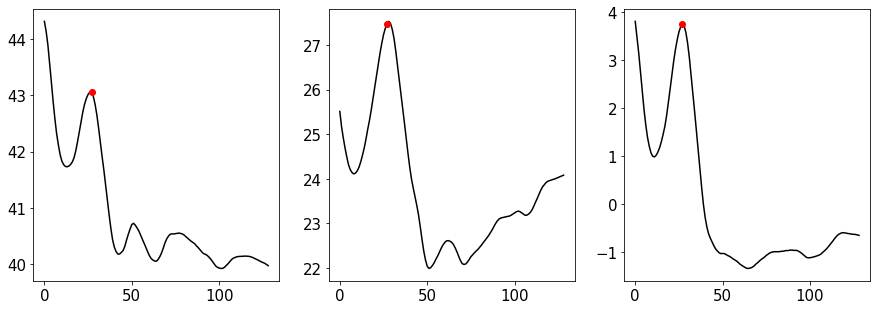

In [43]:
wins = row['Side_windows'].values[0] + (row['fps'].values*pwin).astype('int')
fig, axs = plt.subplots(1,3,figsize=(15,5))
ax = axs[0]
xtr = am.filter_trace(row['Side LEye x'].values[0])/row['Side_pixpercm'].values
ax.plot(xtr,'k')
for w in wins:
    ax.plot(w,xtr[w],'ro')

ax = axs[1]
ytr = am.filter_trace(row['Side LEye y'].values[0])/row['Side_pixpercm'].values
ax.plot(ytr,'k')
for w in wins:
    ax.plot(w,ytr[w],'ro')
    
ax = axs[2]
trace = np.sqrt(np.square(xtr) + np.square(ytr))
trace = trace - np.mean(trace)
ax.plot(trace,'k')
for w in wins:
    ax.plot(w,trace[w],'ro')

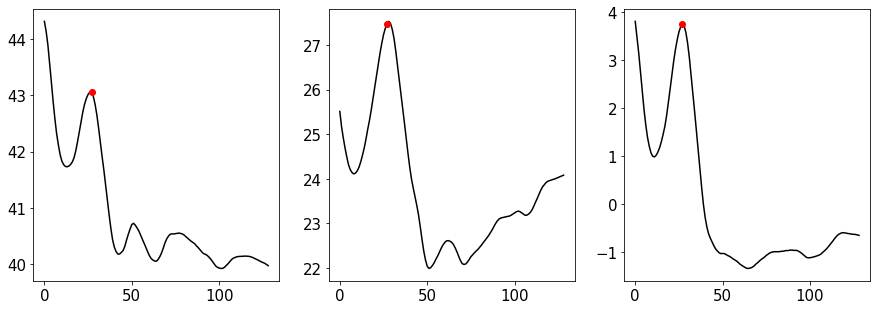

In [44]:
wins = row['Side_windows'].values[0] + (row['fps'].values*0.25).astype('int')
fig, axs = plt.subplots(1,3,figsize=(15,5))
ax = axs[0]
xtr = am.filter_trace(row['Side LEye x'].values[0])/row['Side_pixpercm'].values
ax.plot(xtr,'k')
for w in wins:
    ax.plot(w,xtr[w],'ro')

ax = axs[1]
ytr = am.filter_trace(row['Side LEye y'].values[0])/row['Side_pixpercm'].values
ax.plot(ytr,'k')
for w in wins:
    ax.plot(w,ytr[w],'ro')
    
ax = axs[2]
trace = np.sqrt(np.square(xtr) + np.square(ytr))
trace = trace - np.mean(trace)
ax.plot(trace,'k')
for w in wins:
    ax.plot(w,trace[w],'ro')

In [67]:
pwin = 0.25
distance = int(60*pwin)
neg_peaks = np.where((np.diff(ytr[:-1])<0)&(np.diff(ytr[1:])>0))[0]
pos_peaks = np.where((np.diff(ytr[:-1])>0)&(np.diff(ytr[1:])<0))[0]
peaks = np.sort(np.concatenate((neg_peaks,pos_peaks)))
peaks = peaks[(peaks>distance)&(peaks<(len(ytr)-distance))]
peaks

array([  7,  27,  50,  61,  70, 101, 105], dtype=int64)

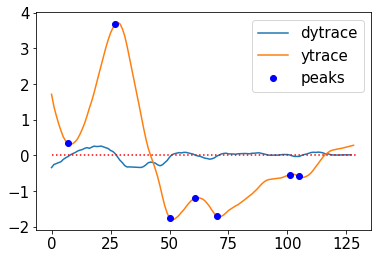

In [68]:
plt.plot(np.diff(ytr),label='dytrace')
plt.plot(ytr-np.mean(ytr),label='ytrace')
plt.plot([0,len(ytr)],[0,0],'r:')
plt.plot(peaks,ytr[peaks]-np.mean(ytr),'bo',label='peaks')
plt.legend()

In [20]:
int(row['fps']*pwin)

15

In [15]:
from scipy import signal
from itertools import compress

In [36]:
peakthresh = 0.5 #how to set this now? usually 0.5 for raw traces, but for x^2+y^2?
distance = int(row['fps'].values/5)
peaktimes,props = signal.find_peaks(trace, prominence=peakthresh, distance=distance)
# peaktimes_neg = signal.find_peaks(-trace, prominence=peakthresh, distance=distance)[0]
# peaktimes = np.hstack((peaktimes_pos,peaktimes_neg))
windows = np.vstack((peaktimes-int(row['fps']*pwin),peaktimes + int(row['fps']*pwin)))
prominences = props['prominences']
# windows = peaktimes

In [37]:
windows[0,:]

array([12], dtype=int64)

[2.78086538]


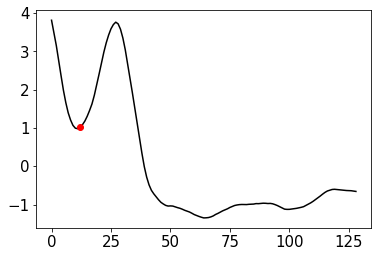

In [38]:
plt.plot(trace,'k')
for w in windows[0,:]:
    plt.plot(w,trace[w],'ro')
print(props['prominences'])

In [39]:
starts = windows[0,:]>0
ends = windows[1,:]<len(xtr)
good_pts = starts & ends
windows = windows[:,good_pts]
# windows = np.sort(windows,axis=1)
windows

array([[12],
       [42]], dtype=int64)

In [40]:
dcutoff = 6
lcutoff = 0.5 #1cm minimum movement requirement

eye_x_mvmnt = [xtr[j] for j in [np.arange(windows[0,i],windows[1,i]) for i in range(len(windows[0,:]))]]
eye_y_mvmnt = [ytr[j] for j in [np.arange(windows[0,i],windows[1,i]) for i in range(len(windows[0,:]))]]


# x_good = np.array([(np.max(x)-np.min(x))<dcutoff for x in eye_x_mvmnt])
# y_good = np.array([(np.max(y)-np.min(y))<dcutoff for y in eye_y_mvmnt])
good_pts = ((prominences<dcutoff)&(prominences>lcutoff)).tolist()# (x_good & y_good).tolist()

#         x_good = [np.max(np.gradient(x))<vcutoff for x in eye_x_mvmnt]
#         y_good = [np.max(np.gradient(y))<vcutoff for y in eye_y_mvmnt]
#         good_pts_v = x_good and y_good

# good_pts = good_pts_d# and good_pts_v
windows = list(compress(windows[0,:],good_pts))
# windows = windows[0,:]

eye_x_mvmnt = list(compress(eye_x_mvmnt, good_pts))
eye_y_mvmnt = list(compress(eye_y_mvmnt, good_pts))
# nose_x_mvmnt = list(compress(nose_x_mvmnt, good_pts))
# nose_y_mvmnt = list(compress(nose_y_mvmnt, good_pts))
windows

[12]

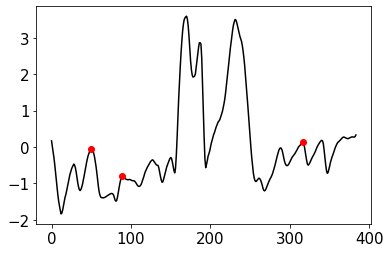

In [125]:
trace = np.sqrt(np.square(xtr) + np.square(ytr))
trace = trace - np.mean(trace)
plt.plot(trace,'k')
for w in windows:#[0,:]:
    plt.plot(w+int(pwin*row['fps']),trace[w+int(pwin*row['fps'])],'ro')

In [120]:
windows.shape

(2, 9)

Text(0, 0.5, 'movement amplitude (cm)')

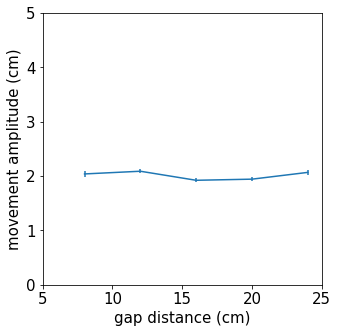

In [82]:
numAni = len(np.unique(base_labels['subject']))
jumpcurve = base_labels[(base_labels['success']==1)&(base_labels['yamps']>1.5)].groupby(['distance','subject']).mean()
mnplot = jumpcurve.groupby(['distance']).mean()
mnplot.reset_index(inplace=True)
semplot = jumpcurve.groupby(['distance']).std()/np.sqrt(numAni)
semplot.reset_index(inplace=True)
fig, ax = plt.subplots(1,1,figsize=(5,5))
ax.errorbar(mnplot['distance'],mnplot['yamps'],yerr=semplot['yamps'])
ax.set_xlim(5,25)
ax.set_ylim(0,5)
ax.set_xlabel('gap distance (cm)')
ax.set_ylabel('movement amplitude (cm)')

In [ ]:
### manually load clustered data
n_k = 12 # number of clusters in the dataset
df_pickle = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_alldata_500msClusts_df_%dclusts.h5' % n_k
labels_pickle = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_alldata_500msClusts_labels_%dclusts.h5' % n_k
df_all = pd.read_hdf(df_pickle)
labels_all = pd.read_hdf(labels_pickle)
df_all = df_all.astype({'success': 'int32'})
# df_all[df_all['success']==2] = df_all[df_all['success']==2].replace(2,0)
# df_all.loc[:,'jumpdist'] = df_all['jumpdist'].astype('float')
# labels_all[labels_all['success']==2] = labels_all[labels_all['success']==2].replace(2,0)
labels_all = am.get_movement_amplitudes_mm(labels_all,'Side')
labels_all.loc[:,'jumpdist'] = labels_all['jumpdist'].astype('float')
df_all = am.get_jump_accuracy(df_all)

### baseline (no opto) data
base_df = df_all.copy()
base_df = base_df[base_df['laser_trial']=='laser off']
base_df.reset_index(inplace=True,drop=True)
base_df[base_df['condition']=='opto suture'] = base_df[base_df['condition']=='opto suture'].replace('opto suture','suture')
base_labels = labels_all.copy()
base_labels = base_labels[base_labels['laser_trial']=='laser off']
base_labels.reset_index(inplace=True,drop=True)
base_labels[base_labels['condition']=='opto suture'] = base_labels[base_labels['condition']=='opto suture'].replace('opto suture','suture')

In [9]:
anis = np.unique(base_df['subject'])
base_ani_df = base_df[base_df['subject']==anis[1]]
base_ani_df.reset_index(inplace=True,drop=True)
save_pdf = True

## Set up group plot PDF file if save_pdf=True
if save_pdf:
    pdf_file = r'C:\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\example_jumping_plots.pdf'
    pp = PdfPages(pdf_file)
else:
    pp=[]

In [10]:
am.plot_jumps(base_ani_df,vid_path,['Side','Top'],'success',save_pdf,pp,'')

In [11]:
pp.close()

# Plot performance manually combining similar bob types

In [4]:
def remove_items_df(df,key,item_list):
    new_df = df.copy()
    for item in item_list:
        new_df = new_df[new_df[key]!=item]
        new_df.reset_index(inplace=True,drop=True)
    return new_df

In [2]:
### manually load clustered data
n_k = 12 # number of clusters in the dataset
df_pickle = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_alldata_500msClusts_df_%dclusts.h5' % n_k
labels_pickle = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_alldata_500msClusts_labels_%dclusts.h5' % n_k
df_all = pd.read_hdf(df_pickle)
labels_all = pd.read_hdf(labels_pickle)
# df_all = df_all.astype({'success': 'int32'})
# df_all[df_all['success']==2] = df_all[df_all['success']==2].replace(2,0)
# df_all.loc[:,'jumpdist'] = df_all['jumpdist'].astype('float')
# labels_all[labels_all['success']==2] = labels_all[labels_all['success']==2].replace(2,0)
labels_all = am.get_movement_amplitudes_mm(labels_all,'Side')
labels_all.loc[:,'jumpdist'] = labels_all['jumpdist'].astype('float')
df_all = am.get_jump_accuracy(df_all)

# ### baseline (no opto) data
# # remove_dates = ['061920', '062020', '062220', '062320']
# # base_df = remove_items_df(df_all,'expdate',remove_dates)
# base_df = df_all.copy()
# base_df = base_df[base_df['laser_trial']=='laser off']
# base_df.reset_index(inplace=True,drop=True)
# base_df[base_df['condition']=='opto suture'] = base_df[base_df['condition']=='opto suture'].replace('opto suture','suture')

# # base_labels = remove_items_df(labels_all,'expdate',remove_dates)
# base_labels = labels_all.copy()
# base_labels = base_labels[base_labels['laser_trial']=='laser off']
# base_labels.reset_index(inplace=True,drop=True)
# base_labels[base_labels['condition']=='opto suture'] = base_labels[base_labels['condition']=='opto suture'].replace('opto suture','suture')

# ## Set up group plot PDF file if save_pdf=True
# if save_pdf:
#     pdf_file = data_file[:-4] + '_combined_bob_performance_%dclusts.pdf' % n_k
#     pp = PdfPages(pdf_file)
# else:
#     pp=[]

# fig, ax = am.plot_movement_timing(base_labels,'Side','hclusters','ocular',-5,2,0.5,plot_params,save_pdf,pp)
    
# cluster_nums = [4,5,6] #periodic
# base_df = am.label_bob_frequency_multi(base_df,base_labels,'hclusters',cluster_nums)
# am.plot_combined_mvmnts(base_labels,'hclusters',cluster_nums,2,save_pdf,pp)
# fig, ax = am.plot_performance_bob_freq(base_df,'ocular','bob_freq',4,save_pdf,pp,'periodic movements')

# cluster_nums = [1,2,7,8,10] # vertical movements
# base_df = am.label_bob_frequency_multi(base_df,base_labels,'hclusters',cluster_nums)
# am.plot_combined_mvmnts(base_labels,'hclusters',cluster_nums,2,save_pdf,pp)
# fig, ax = am.plot_performance_bob_freq(base_df,'ocular','bob_freq',4,save_pdf,pp,'vertical movements')

# cluster_nums = [0,1,2,3,4,5,6,7,8,9,10,11]
# base_df = am.label_bob_frequency_multi(base_df,base_labels,'hclusters',cluster_nums)
# am.plot_combined_mvmnts(base_labels,'hclusters',cluster_nums,2,save_pdf,pp)
# fig, ax = am.plot_performance_bob_freq(base_df,'ocular','bob_freq',4,save_pdf,pp,'all movements')

# cluster_nums = [0,3]
# base_df = am.label_bob_frequency_multi(base_df,base_labels,'hclusters',cluster_nums)
# am.plot_combined_mvmnts(base_labels,'hclusters',cluster_nums,2,save_pdf,pp)
# fig, ax = am.plot_performance_bob_freq(base_df,'ocular','bob_freq',4,save_pdf,pp,'slips')

# pp.close()

# print('finished pdf!')

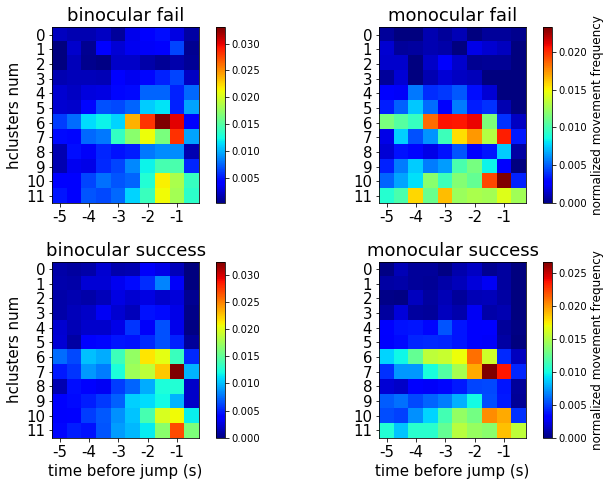

In [26]:
# side = 'Side'
# cluster_key = 'hclusters'
# condition = 'ocular'
# save_pdf = False
# pp = []
# labels = base_labels.copy()
# tstart=-5

# labels = am.remove_aborts(labels)
# anis = np.unique(labels['subject'])
# dists = np.unique(labels['distance'])
# conds = np.unique(labels[condition])
# success = np.unique(labels['success'])
# suc_lab = ['fail','success']
# n_k = len(np.unique(labels[cluster_key]))
# mov_dur = 0.25 #movement duration in sec
# #bins are hard coded right now
# tjump_histrange = [tstart,0]
# bps = 2 #bins per second
# # tstart_histrange = [0,1]
# bins= -int(tjump_histrange[0])*bps

# #first calculate the times for each animal/condition/distance
# tjump = np.zeros((len(anis),len(conds),n_k,len(success),bins))
# # tstart = np.zeros((len(anis),len(conds),n_k,bins))
# for a,ani in enumerate(anis):
#     for c,cond in enumerate(conds):
#         for s,suc in enumerate(success):
#             tot_tr = len(labels[(labels['subject']==ani)&(labels[condition]==cond)&(labels['success']==suc)])
#             for k in range(n_k):
#                 tr_idx = np.intersect1d(np.where(labels['subject']==ani)[0],
#                                               np.intersect1d(np.where(labels[cluster_key]==k)[0],
#                                                              np.intersect1d(np.where(labels[condition]==cond)[0],
#                                                                             np.where(labels['success']==suc)[0])))
#                 tjump[a,c,k,s,:] = np.histogram(labels[side + '_mov_rel_jump'][tr_idx]+mov_dur,
#                                               bins=bins,range=tjump_histrange)[0]/tot_tr#len(labels[side + '_mov_rel_jump'][tr_idx])
#     #             tstart[a,c,k,:] = np.histogram(labels[side + '_mov_rel_start'][tr_idx],
#     #                                            bins=bins,range=tstart_histrange)[0]/len(labels[side + '_mov_rel_start'][tr_idx])

# #then plot the results for time from jump
# fig, axs = plt.subplots(len(success),len(conds),figsize=(5*len(conds),5+len(success)))
# axs = axs.ravel()

# for c,cond in enumerate(conds):
#     for s,suc in enumerate(success):
#         ax = axs[c+len(conds)*s]
#         hist = np.nanmean(tjump[:,c,:,s,:],axis=0)
#         pos = ax.imshow(hist,cmap=plot_params['cm'])
#         ax.set_xticks(np.arange(0,bins,bps))
#         ax.set_yticks(np.arange(0,n_k,1))
#         ax.set_xticklabels(np.arange(tjump_histrange[0],tjump_histrange[1],1))
#         ax.set_title(cond + ' ' + suc_lab[s])
#         cbar = fig.colorbar(pos, ax=ax, orientation='vertical')
#         cbar.ax.tick_params(labelsize=10) 
#         if c==0:
#             ax.set_ylabel('%s num' % cluster_key)
#         if s==len(success)-1:
#             ax.set_xlabel('time before jump (s)')
#         if c==len(conds)-1:
#             cbar.ax.set_ylabel('normalized movement frequency',rotation=90,fontsize=12)

# fig.tight_layout()

# Plot opto performance including both cohorts

In [2]:
### import old data
key_keys = ['subject', 'expdate', 'condition', 'ocular','laser_trial','success', 'platform', 'distance','jumpdist','accuracy']
cohort3_path = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\old_cohorts'
cohort3_df = 'thirdGendf.pkl'
cohort3_labels = 'thirdGenlabels.pkl'
c3_df = pd.read_pickle(os.path.join(cohort3_path,cohort3_df))
c3_labels = pd.read_pickle(os.path.join(cohort3_path,cohort3_labels))
c3_df = am.get_jump_accuracy(c3_df)
c3_df = c3_df[key_keys]
c3_df['laser_trial'] = c3_df['laser_trial'].astype(str)
c3_df[c3_df['laser_trial']=='0'] = c3_df[c3_df['laser_trial']=='0'].replace('0','laser off')
c3_df[c3_df['laser_trial']=='1'] = c3_df[c3_df['laser_trial']=='1'].replace('1','laser on')


control
['laser off' 'laser on']
                            sum_sq    df          F        PR(>F)
C(distance)               1.507660   4.0  63.746749  3.114856e-14
C(condition)              0.005742   1.0   0.971161  3.322725e-01
C(distance):C(condition)  0.063374   4.0   2.679585  5.063359e-02
Residual                  0.177381  30.0        NaN           NaN

distance 8, p=0.391
distance 12, p=0.961
distance 16, p=0.118
distance 20, p=0.206
distance 24, p=0.495
alpha=0.010
finished plotting opto control group data!

PVChR2
['laser off' 'laser on']
                            sum_sq    df          F        PR(>F)
C(distance)               2.447862   4.0  18.287999  2.521427e-10
C(condition)              1.302972   1.0  38.938058  2.938548e-08
C(distance):C(condition)  0.074156   4.0   0.554017  6.967267e-01
Residual                  2.342387  70.0        NaN           NaN

distance 8, p=0.016
distance 12, p=0.015
distance 16, p=0.000
distance 20, p=0.048
distance 24, p=0.009
alpha=0.0

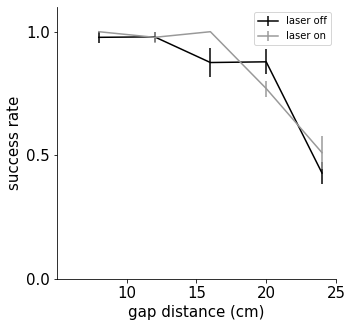

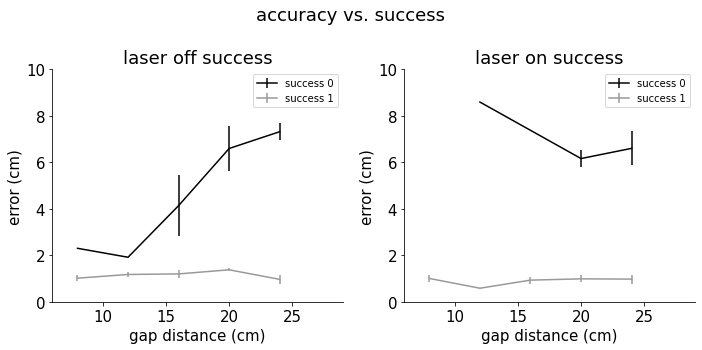

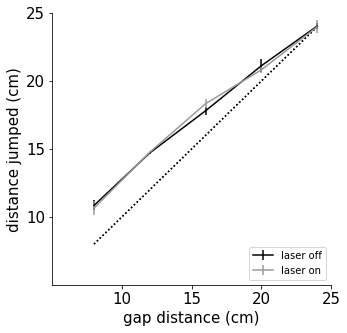

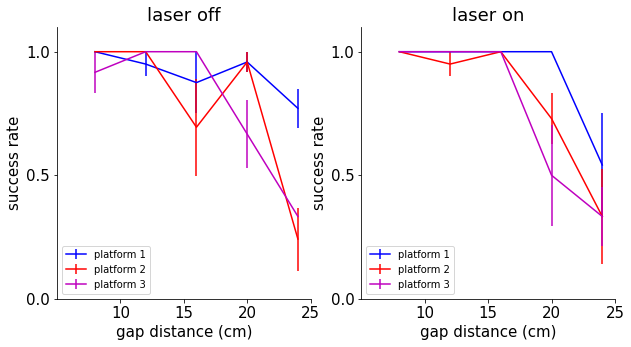

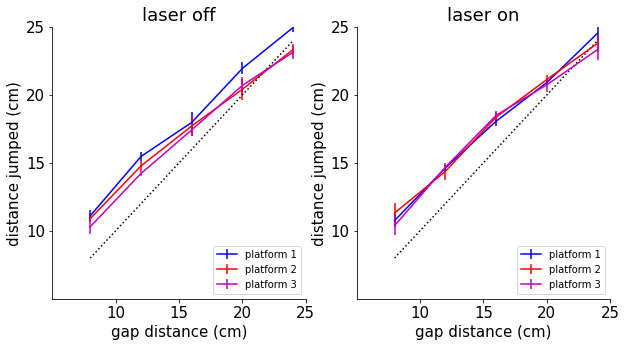

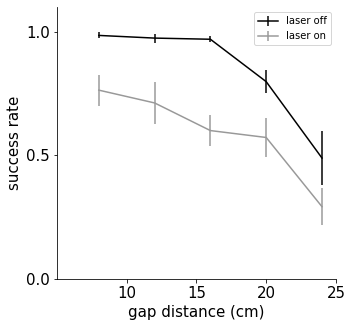

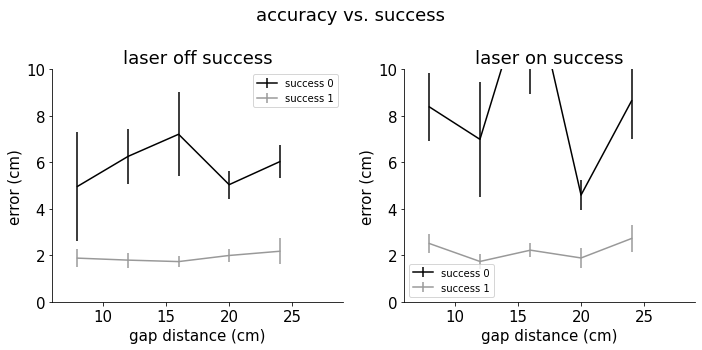

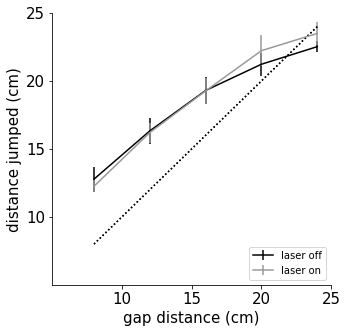

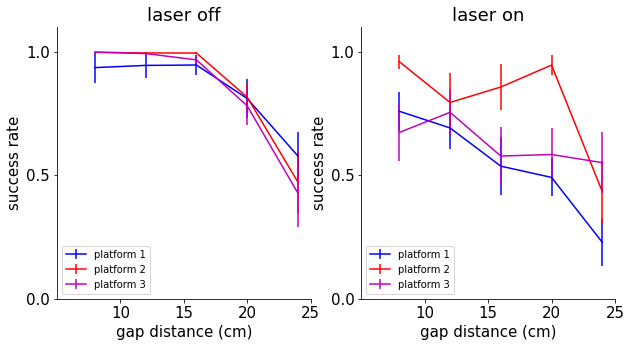

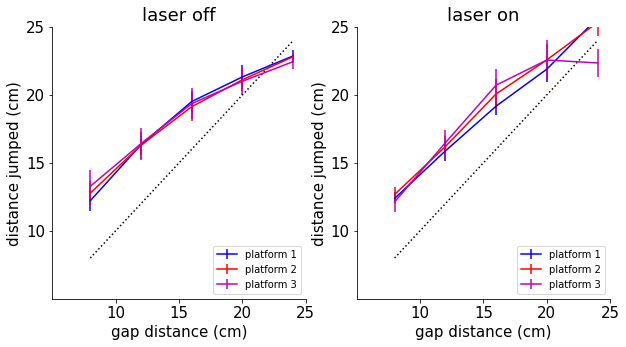

In [115]:
save_pdf = False
pp=[]

pwin = 0.25 #half the movement duration window desired
metric = 'velocity'
mvmnt_file = r'T:\variable_platform_mvmnts_%sms_%s.h5' % (int(pwin*1000),metric)
# Save the df and labels
df_pickle = mvmnt_file[:-3] + '_df.h5'
labels_pickle = mvmnt_file[:-3] + '_labels.h5'
df_clust = pd.read_hdf(df_pickle)
labels_all = pd.read_hdf(labels_pickle)
df_clust = am.get_jump_accuracy(df_clust)
labels_all = am.get_movement_amplitudes_mm(labels_all,'Side')
labels_all.loc[:,'jumpdist'] = labels_all['jumpdist'].astype('float')

###### opto analysis with old cohort added in
opto_df = df_clust.copy()
opto_df = opto_df[opto_df['condition']=='opto suture']
opto_df.reset_index(inplace=True,drop=True)
opto_labels = labels_all.copy()
opto_labels = opto_labels[opto_labels['condition']=='opto suture']
opto_labels.reset_index(inplace=True,drop=True)

###control group
opto_control_df = opto_df[opto_df['subject'].str.contains('J')]
opto_control_df.reset_index(inplace=True,drop=True)
opto_control_labels = opto_labels[opto_labels['subject'].str.contains('J')]
opto_control_labels.reset_index(inplace=True,drop=True)
opto_control_df = opto_control_df[key_keys]

###experimental group
opto_expt_df = opto_df[opto_df['subject'].str.contains('PV')]
opto_expt_df.reset_index(inplace=True,drop=True)
opto_expt_labels = opto_labels[opto_labels['subject'].str.contains('PV')]
opto_expt_labels.reset_index(inplace=True,drop=True)
opto_expt_df = opto_expt_df[key_keys]
opto_expt_df = pd.concat([opto_expt_df,c3_df],axis=0,ignore_index=True)
# opto_expt_df = c3_df.copy()
opto_expt_df = opto_expt_df[opto_expt_df['subject']!='PV-ChR8.7ALN'] #this animal had no laser on data? threw out before opto experiments?
opto_expt_df.reset_index(inplace=True,drop=True)

# opto_expt_df = opto_expt_df[(opto_expt_df['distance']==8)|(opto_expt_df['distance']==12)|(opto_expt_df['distance']==16)]

df_list = [opto_control_df,opto_expt_df]
labels_list = [opto_control_labels,opto_expt_labels]
opto_list = ['control','PVChR2']

cluster_key = 'hclusters'
condition = 'laser_trial'
side = 'Side'

for i in range(2):
    ## Set up group plot PDF file if save_pdf=True
    if save_pdf:
        pdf_file = 'T:\opto_%s_group_plots_%dclusts_aborts_newonly.pdf' % (opto_list[i],n_k)
        pp = PdfPages(pdf_file)
    else:
        pp=[]

    # Analyze movements from kmeans clustering of PCA data (group, individual)
#     fig, ax = am.plot_movement_clusters(df_list[i],labels_list[i],side,cluster_key,condition,plot_params,save_pdf,pp)
#     fig, ax = am.plot_cluster_freq(df_list[i],labels_list[i],cluster_key,condition,plot_params,save_pdf,pp)
#     fig, ax = am.plot_movement_timing(labels_list[i],side,cluster_key,condition,-5,2,0.5,plot_params,save_pdf,pp)

#     for cluster_num in range(n_k):
#         fig, ax = am.plot_movement_trace_distance(labels_list[i],side,cluster_num,cluster_key,condition,plot_params,save_pdf,pp)
#         base_df = am.label_bob_frequency(df_list[i],labels_list[i],cluster_key,cluster_num)
#         fig, ax = am.plot_performance_bob_freq(df_list[i],condition,'bob_freq',4,save_pdf,pp,'')

    ### create lists of platform widths and gap distances to get retinal image size
#     pfs = np.around(np.array([4,8,12])*2.54,decimals=1)
#     ds = np.around(np.arange(8,28,4),decimals=1)
#     ris, fig, ax = am.make_ris_table(pfs,ds,save_pdf,pp)

    print(opto_list[i])
    aborts=1
    fig, ax, stats_array = am.plot_performance(df_list[i],condition,aborts,5,25,plot_params,save_pdf,pp)
    fig, ax = am.plot_jump_accuracy(df_list[i],condition,'success',plot_params,save_pdf,pp,'accuracy vs. success')
    fig, ax = am.plot_jumpdist(df_list[i],condition,5,25,plot_params,save_pdf,pp)
    fig, ax = am.plot_performance_platforms(df_list[i],condition,aborts,5,25,plot_params,save_pdf,pp)
#     fig, ax = am.plot_ris_distance(df_list[i],condition,ris,plot_params,save_pdf,pp)
    fig, ax = am.plot_jumpdist_platforms(df_list[i],condition,5,25,plot_params,save_pdf,pp)

    ### close the group PDF
    try:
        pp.close()
    except:
        pass
    print('finished plotting opto %s group data!' % opto_list[i])
    print('')

In [100]:
pdf_file = 'T:\opto_performance_PV-ChR2.pdf'
pp = PdfPages(pdf_file)
anis = np.unique(opto_expt_df['subject'])
fig, axs, array = am.plot_fraction_success(opto_expt_df,'laser_trial',plot_params['opto_cols'],True,pp,'all subjects')
for ani in anis:
    ani_df = opto_expt_df[opto_expt_df['subject']==ani]
    fig, axs, array = am.plot_fraction_success(ani_df,'laser_trial',plot_params['opto_cols'],True,pp,ani)
    
pp.close()


alpha p=0.010
failure 8cm p=0.201
failure 12cm p=0.074
failure 16cm p=0.146
failure 20cm p=0.247
failure 24cm p=0.878
success 8cm p=0.016
success 12cm p=0.015
success 16cm p=0.000
success 20cm p=0.048
success 24cm p=0.009
abort 8cm p=0.017
abort 12cm p=0.038
abort 16cm p=0.012
abort 20cm p=0.009
abort 24cm p=0.044
alpha p=0.010
failure 8cm p=nan
failure 12cm p=nan
failure 16cm p=nan
failure 20cm p=nan
failure 24cm p=nan
success 8cm p=nan
success 12cm p=nan
success 16cm p=nan
success 20cm p=nan
success 24cm p=nan
abort 8cm p=nan
abort 12cm p=nan
abort 16cm p=nan
abort 20cm p=nan
abort 24cm p=nan
alpha p=0.010
failure 8cm p=nan
failure 12cm p=nan
failure 16cm p=nan
failure 20cm p=nan
failure 24cm p=nan
success 8cm p=nan
success 12cm p=nan
success 16cm p=nan
success 20cm p=nan
success 24cm p=nan
alpha p=0.010
failure 8cm p=nan
failure 12cm p=nan
failure 16cm p=nan
failure 20cm p=nan
failure 24cm p=nan
success 8cm p=nan
success 12cm p=nan
success 16cm p=nan
success 20cm p=nan
success 24cm 

alpha p=0.010
failure 8cm p=0.151
failure 12cm p=0.183
failure 16cm p=0.155
failure 20cm p=0.390
failure 24cm p=0.937
success 8cm p=0.004
success 12cm p=0.010
success 16cm p=0.000
success 20cm p=0.029
success 24cm p=0.155
abort 8cm p=0.008
abort 12cm p=0.024
abort 16cm p=0.005
abort 20cm p=0.007
abort 24cm p=0.083
failure
                              sum_sq    df          F        PR(>F)
C(distance)                 1.678406   4.0  10.990569  5.665131e-07
C(laser_trial)              0.031000   1.0   0.811987  3.706235e-01
C(distance):C(laser_trial)  0.095092   4.0   0.622680  6.478532e-01
Residual                    2.672482  70.0        NaN           NaN

success
                              sum_sq    df          F        PR(>F)
C(distance)                 2.447862   4.0  18.287999  2.521427e-10
C(laser_trial)              1.302972   1.0  38.938058  2.938548e-08
C(distance):C(laser_trial)  0.074156   4.0   0.554017  6.967267e-01
Residual                    2.342387  70.0        NaN  

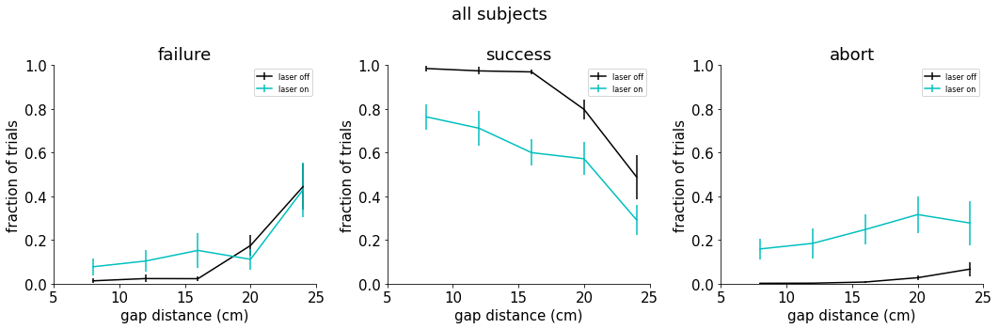

In [185]:
condition = 'laser_trial'
fig, axs, array = am.plot_fraction_success(opto_expt_df,condition,plot_params['opto_cols'],False,pp,'all subjects')
# array.shape
anis = np.unique(opto_expt_df['subject'])
dists = np.unique(opto_expt_df['distance'])
conds = np.unique(opto_expt_df[condition])
sucs = np.unique(opto_expt_df['success'])
suc_lab = ['failure','success','abort']


for s,suc in enumerate(sucs):
    anova_df = pd.DataFrame(columns=['distance',condition,'success'])
    for d,dist in enumerate(dists):
        for c,cond in enumerate(conds):
            temp_df = pd.DataFrame(columns=['distance',condition,'success'])
            temp_df['distance']  = pd.Series(np.repeat(dist,len(anis)))
            temp_df[condition] = pd.Series(np.repeat(cond,len(anis)))
            temp_df['success'] = array[:,d,c,s]
            anova_df = pd.concat([anova_df,temp_df],axis=0)
    #print anova results
    model = ols('success ~ C(distance) + C(laser_trial) + C(distance):C(laser_trial)', data=anova_df).fit()
    print(suc_lab[s])
    print(sm.stats.anova_lm(model, typ=2))
    print('')

alpha p=0.010
failure 8cm p=0.356
failure 12cm p=0.953
failure 16cm p=0.073
failure 20cm p=0.061
failure 24cm p=0.345
success 8cm p=0.356
success 12cm p=0.953
success 16cm p=0.073
success 20cm p=0.119
success 24cm p=0.345
abort 8cm p=nan
abort 12cm p=nan
abort 16cm p=nan
abort 20cm p=0.356
abort 24cm p=nan
failure
                              sum_sq    df          F        PR(>F)
C(distance)                 1.506250   4.0  67.026872  1.593339e-14
C(laser_trial)              0.004488   1.0   0.798862  3.785485e-01
C(distance):C(laser_trial)  0.071022   4.0   3.160406  2.789104e-02
Residual                    0.168542  30.0        NaN           NaN

success
                              sum_sq    df          F        PR(>F)
C(distance)                 1.507660   4.0  63.746749  3.114856e-14
C(laser_trial)              0.005742   1.0   0.971161  3.322725e-01
C(distance):C(laser_trial)  0.063374   4.0   2.679585  5.063359e-02
Residual                    0.177381  30.0        NaN          

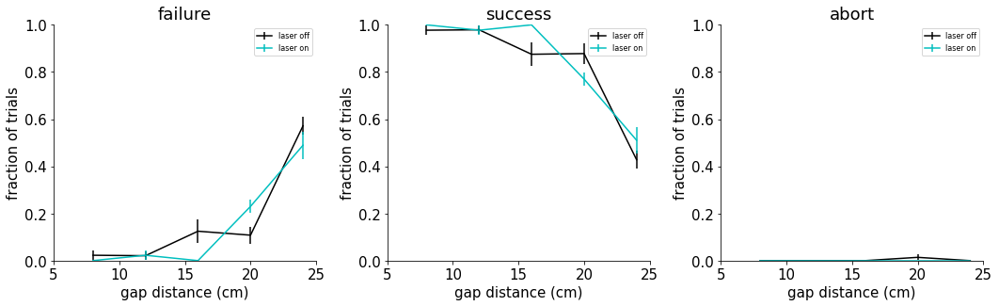

In [186]:
fig, axs, array = am.plot_fraction_success(opto_control_df,'laser_trial',plot_params['opto_cols'],False,pp,'')
anis = np.unique(opto_control_df['subject'])
dists = np.unique(opto_control_df['distance'])
conds = np.unique(opto_control_df[condition])
sucs = np.unique(opto_control_df['success'])
suc_lab = ['failure','success','abort']


for s,suc in enumerate(sucs):
    anova_df = pd.DataFrame(columns=['distance',condition,'success'])
    for d,dist in enumerate(dists):
        for c,cond in enumerate(conds):
            temp_df = pd.DataFrame(columns=['distance',condition,'success'])
            temp_df['distance']  = pd.Series(np.repeat(dist,len(anis)))
            temp_df[condition] = pd.Series(np.repeat(cond,len(anis)))
            temp_df['success'] = array[:,d,c,s]
            anova_df = pd.concat([anova_df,temp_df],axis=0)
    #print anova results
    model = ols('success ~ C(distance) + C(laser_trial) + C(distance):C(laser_trial)', data=anova_df).fit()
    print(suc_lab[s])
    print(sm.stats.anova_lm(model, typ=2))
    print('')

(5.0, 25.0)

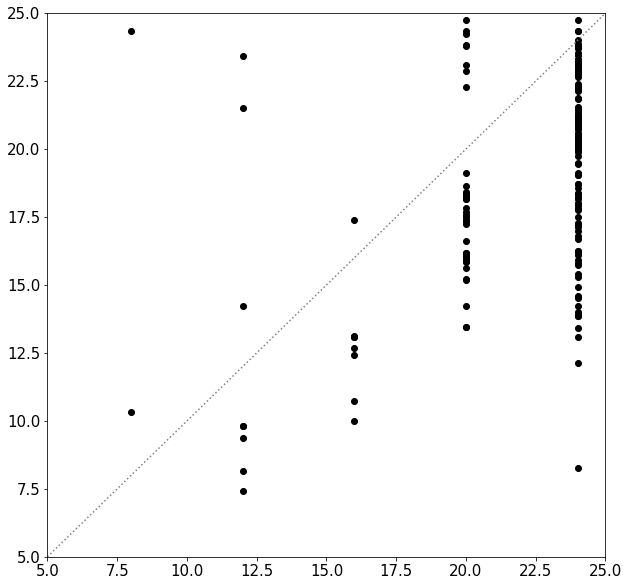

In [35]:
temp_df = opto_expt_df[(opto_expt_df['success']==0)&(opto_expt_df['laser_trial']=='laser off')]
fig, axs = plt.subplots(1,1,figsize=(10,10))
axs.plot(temp_df['distance'],temp_df['jumpdist'],'ko')
axs.plot([5,25],[5,25],':',color=[0.5,0.5,0.5])
axs.set_xlim(5,25)
axs.set_ylim(5,25)


(<Figure size 720x360 with 2 Axes>,
 <AxesSubplot:title={'center':'laser on'}, xlabel='gap distance (cm)', ylabel='accuracy'>)

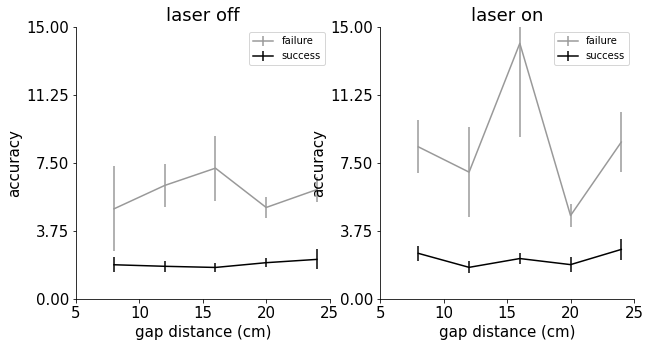

In [26]:
am.plot_variable_vs_distance(opto_expt_df,'accuracy','laser_trial',0,15,plot_params,False,pp,suptitle='')

In [187]:
dic = {"early": {"PV-CHR11P2RT": {"mean": 1.0706969794297547, "sem": 0.11257486309449936}, "J158BLT": {"mean": 2.6263190235361313, "sem": 0.09256764359636846}, "J157BRT": {"mean": 1.1665926747425652, "sem": 0.1124639045390993}, "PV-CHR11P1LT": {"mean": 1.8397331689557808, "sem": 0.08796181720575638}, "PV-CHR11P2LT": {"mean": 1.7442971212017935, "sem": 0.08702011135490065}, "J157BLT": {"mean": 1.127947614366473, "sem": 0.09740759994071395}, "PV-CHR11P1TT": {"mean": 1.917186989083244, "sem": 0.15667497772704236}, "J158BRT": {"mean": 2.6315513397995254, "sem": 0.159949193901663}}, "prep": {"PV-CHR11P2RT": {"mean": -0.5564097866119918, "sem": 0.12875360622543505}, "J158BLT": {"mean": -2.7684901766157353, "sem": 0.12049486722578624}, "J157BRT": {"mean": -2.3886130238179923, "sem": 0.1362526743175943}, "PV-CHR11P1LT": {"mean": -1.0483267430296934, "sem": 0.08874220826241079}, "PV-CHR11P2LT": {"mean": -0.9069241404785504, "sem": 0.10189548088658104}, "J157BLT": {"mean": -1.7429612772432468, "sem": 0.11416088425689658}, "PV-CHR11P1TT": {"mean": -1.1628372432354983, "sem": 0.17358541242765885}, "J158BRT": {"mean": -2.7405808053809926, "sem": 0.19698291688596856}}, "p_value": 0.00015748846811562562}
df = pd.DataFrame(dic)
df

,early,prep,p_value
PV-CHR11P2RT,"{'mean': 1.0706969794297547, 'sem': 0.11257486...","{'mean': -0.5564097866119918, 'sem': 0.1287536...",0.000157
J158BLT,"{'mean': 2.6263190235361313, 'sem': 0.09256764...","{'mean': -2.7684901766157353, 'sem': 0.1204948...",0.000157
J157BRT,"{'mean': 1.1665926747425652, 'sem': 0.11246390...","{'mean': -2.3886130238179923, 'sem': 0.1362526...",0.000157
PV-CHR11P1LT,"{'mean': 1.8397331689557808, 'sem': 0.08796181...","{'mean': -1.0483267430296934, 'sem': 0.0887422...",0.000157
PV-CHR11P2LT,"{'mean': 1.7442971212017935, 'sem': 0.08702011...","{'mean': -0.9069241404785504, 'sem': 0.1018954...",0.000157
J157BLT,"{'mean': 1.127947614366473, 'sem': 0.097407599...","{'mean': -1.7429612772432468, 'sem': 0.1141608...",0.000157
PV-CHR11P1TT,"{'mean': 1.917186989083244, 'sem': 0.156674977...","{'mean': -1.1628372432354983, 'sem': 0.1735854...",0.000157
J158BRT,"{'mean': 2.6315513397995254, 'sem': 0.15994919...","{'mean': -2.7405808053809926, 'sem': 0.1969829...",0.000157


In [188]:
df.reset_index(inplace=True)
df.columns.values

array(['index', 'early', 'prep', 'p_value'], dtype=object)

In [191]:
early_late = np.empty((8,2))
early_late[:] = np.nan
for index,row in df.iterrows():
    early_late[index,0] = row['early']['mean']
    early_late[index,1] = row['prep']['mean']
early_late    

array([[ 1.07069698, -0.55640979],
       [ 2.62631902, -2.76849018],
       [ 1.16659267, -2.38861302],
       [ 1.83973317, -1.04832674],
       [ 1.74429712, -0.90692414],
       [ 1.12794761, -1.74296128],
       [ 1.91718699, -1.16283724],
       [ 2.63155134, -2.74058081]])

In [192]:
print('early vergence mean/sem = %0.3f +/- %0.3f' % (np.mean(early_late[:,0]),(np.std(early_late[:,0])/np.sqrt(8))))
print('late vergence mean/sem = %0.3f +/- %0.3f' % (np.mean(early_late[:,1]),(np.std(early_late[:,1])/np.sqrt(8))))

early vergence mean/sem = 1.766 +/- 0.208
late vergence mean/sem = -1.664 +/- 0.289


In [193]:
scipy.stats.ttest_rel(early_late[:,0],early_late[:,1])

Ttest_relResult(statistic=7.338385967624814, pvalue=0.00015748846811562562)

In [172]:
# dic = {"all": {"PV-CHR11P2RT": {"mean": -6.071701041108482e-16, "sem": 0.1320806456658373}, "J158BLT": {"mean": 6.2327971827293904e-15, "sem": 0.15242119122637385}, "J157BRT": {"mean": 7.090413503870129e-16, "sem": 0.17656879804168357}, "PV-CHR11P1LT": {"mean": -3.7626849364128237e-16, "sem": 0.0941126130358905}, "PV-CHR11P2LT": {"mean": -2.1345245605079635e-15, "sem": 0.10981816097527818}, "J157BLT": {"mean": 3.1624855509907496e-17, "sem": 0.15949079177216754}, "PV-CHR11P1TT": {"mean": 1.1056766567929488e-15, "sem": 0.17587505825829391}, "J158BRT": {"mean": 1.7538713097875891e-15, "sem": 0.17479035978657037}}, "early": {"PV-CHR11P2RT": {"mean": -8.497098382103966e-15, "sem": 0.21356683470729956}, "J158BLT": {"mean": 3.901388496083309e-16, "sem": 0.19903749145212}, "J157BRT": {"mean": -3.640144843692919e-15, "sem": 0.36522522561789444}, "PV-CHR11P1LT": {"mean": -3.201003427233248e-16, "sem": 0.1616837210634802}, "PV-CHR11P2LT": {"mean": 1.250854269751694e-15, "sem": 0.16256383127024981}, "J157BLT": {"mean": -5.207192978462503e-16, "sem": 0.2849411106520942}, "PV-CHR11P1TT": {"mean": 1.7665427132157186e-16, "sem": 0.3258953711727894}, "J158BRT": {"mean": -5.0454093017847885e-15, "sem": 0.2236653725950646}}, "preparatory": {"PV-CHR11P2RT": {"mean": 1.9160702986789218e-15, "sem": 0.1812571741464258}, "J158BLT": {"mean": 6.0896425553200744e-15, "sem": 0.2215391821605021}, "J157BRT": {"mean": -2.5000770646888145e-16, "sem": 0.241793986424932}, "PV-CHR11P1LT": {"mean": 2.198175879325016e-15, "sem": 0.1033005320789621}, "PV-CHR11P2LT": {"mean": 1.081701595828887e-15, "sem": 0.15386830613810115}, "J157BLT": {"mean": -1.4645989176235074e-15, "sem": 0.18612435393903626}, "PV-CHR11P1TT": {"mean": -3.472308591350699e-15, "sem": 0.22293006813647093}, "J158BRT": {"mean": 8.121806883830338e-16, "sem": 0.252033326852524}}, "p_value": 0.11087256205260328}
dic = {"early": {"PV-CHR11P2RT": {"mean": 135.76855727789655, "sem": 0.23958069067351423}, "J158BLT": {"mean": 136.02159728988553, "sem": 0.21862631442853173}, "J157BRT": {"mean": 131.63967117869763, "sem": 0.39808791967210666}, "PV-CHR11P1LT": {"mean": 134.8579394924811, "sem": 0.1748447328950985}, "PV-CHR11P2LT": {"mean": 129.18387548043742, "sem": 0.1739940714800398}, "J157BLT": {"mean": 130.62323800243, "sem": 0.2961441889849759}, "PV-CHR11P1TT": {"mean": 138.96004648805967, "sem": 0.3479939867777771}, "J158BRT": {"mean": 139.3135078826097, "sem": 0.2546620679978579}}, "prep": {"PV-CHR11P2RT": {"mean": 139.83605452354976, "sem": 0.19164597458759447}, "J158BLT": {"mean": 146.54022759256125, "sem": 0.2363416808478821}, "J157BRT": {"mean": 140.2540514282682, "sem": 0.2611390944896532}, "PV-CHR11P1LT": {"mean": 141.08548365697482, "sem": 0.11829817376209038}, "PV-CHR11P2LT": {"mean": 133.60265424113945, "sem": 0.16499942031166392}, "J157BLT": {"mean": 139.62108920611897, "sem": 0.19765174665059848}, "PV-CHR11P1TT": {"mean": 145.47649108302298, "sem": 0.24204073287607722}, "J158BRT": {"mean": 145.80824126656458, "sem": 0.2719911802724316}}, "p_value": 0.11087256205260328}
df = pd.DataFrame(dic)
df

,early,prep,p_value
PV-CHR11P2RT,"{'mean': 135.76855727789655, 'sem': 0.23958069...","{'mean': 139.83605452354976, 'sem': 0.19164597...",0.110873
J158BLT,"{'mean': 136.02159728988553, 'sem': 0.21862631...","{'mean': 146.54022759256125, 'sem': 0.23634168...",0.110873
J157BRT,"{'mean': 131.63967117869763, 'sem': 0.39808791...","{'mean': 140.2540514282682, 'sem': 0.261139094...",0.110873
PV-CHR11P1LT,"{'mean': 134.8579394924811, 'sem': 0.174844732...","{'mean': 141.08548365697482, 'sem': 0.11829817...",0.110873
PV-CHR11P2LT,"{'mean': 129.18387548043742, 'sem': 0.17399407...","{'mean': 133.60265424113945, 'sem': 0.16499942...",0.110873
J157BLT,"{'mean': 130.62323800243, 'sem': 0.29614418898...","{'mean': 139.62108920611897, 'sem': 0.19765174...",0.110873
PV-CHR11P1TT,"{'mean': 138.96004648805967, 'sem': 0.34799398...","{'mean': 145.47649108302298, 'sem': 0.24204073...",0.110873
J158BRT,"{'mean': 139.3135078826097, 'sem': 0.254662067...","{'mean': 145.80824126656458, 'sem': 0.27199118...",0.110873


In [173]:
df.reset_index(inplace=True)
df.columns.values

array(['index', 'early', 'prep', 'p_value'], dtype=object)

In [181]:
early_late = np.empty((8,2))
early_late[:] = np.nan
for index,row in df.iterrows():
    early_late[index,0] = row['early']['mean']-180
    early_late[index,1] = row['prep']['mean']-180
early_late

array([[-44.23144272, -40.16394548],
       [-43.97840271, -33.45977241],
       [-48.36032882, -39.74594857],
       [-45.14206051, -38.91451634],
       [-50.81612452, -46.39734576],
       [-49.376762  , -40.37891079],
       [-41.03995351, -34.52350892],
       [-40.68649212, -34.19175873]])

In [182]:
print('early pitch mean/sem = %0.3f +/- %0.3f' % (np.mean(early_late[:,0]),(np.std(early_late[:,0])/np.sqrt(8))))
print('late pitch mean/sem = %0.3f +/- %0.3f' % (np.mean(early_late[:,1]),(np.std(early_late[:,1])/np.sqrt(8))))

early pitch mean/sem = -45.454 +/- 1.241
late pitch mean/sem = -38.472 +/- 1.426


In [183]:
scipy.stats.ttest_rel(early_late[:,0],early_late[:,1])

Ttest_relResult(statistic=-8.79100597555737, pvalue=4.968758452972331e-05)

In [17]:
def plot_success_condition(og_df,condition,plt_min,plt_max,plot_params,save_pdf,pp,suptitle=''):
    anis = np.unique(df['subject'])
    dists = np.unique(df['distance'])
    conds = np.unique(df[condition])

    # stats_array = np.empty((len(anis),len(dists),len(conds)))

    # anova_df = pd.DataFrame(columns=['distance','condition','jumpdist'])

    fig, ax = plt.subplots(1,1,figsize=(5,5))        
    for c,cond in enumerate(conds):
        jumpcurve = df[(df['success']==1)&(df[condition]==cond)].groupby(['distance','subject']).mean()
        # jumpcurve.reset_index(inplace=True)
        mnplot = jumpcurve.groupby(['distance']).mean()
        semplot = jumpcurve.groupby(['distance']).std()/np.sqrt(len(anis))
        mnplot.reset_index(inplace=True)
        semplot.reset_index(inplace=True)
        semplot[np.isnan(semplot)]=0
        xvals = np.unique(mnplot['distance'])
        ax.errorbar(xvals,
                     mnplot['jumpdist'],
                     yerr=semplot['jumpdist'],label='%s' % cond,color=plot_params['cond_col'][c])
        ax.set_xlabel('gap distance (cm)')
        ax.set_ylabel('distance jumped (cm)')
        ax.set_xlim(plt_min,plt_max)
        ax.set_ylim(plt_min,plt_max)
        ax.set_xticks([10,15,20,25])
        ax.set_yticks([10,15,20,25])
        # ax.set_xticks(np.arange(plt_min,plt_max+plt_min,plt_min))
        # ax.set_yticks(np.arange(plt_min,plt_max+plt_min,plt_min))
        ax.legend(loc=4,fontsize=10)
        # ax1.set_title('both bi/monocular')
        # locs, labels = plt.xticks(fontsize=10)
        # plt.xticks(np.arange(8, 32, step=4))
        # for pl in range(3):
        ax.plot(xvals,xvals,'k:')
        ax = xy_axis(ax)

array(['laser off', 'laser on'], dtype=object)

In [ ]:


plot_success_condition(opto_expt_df,'laser_trial',5,25,plot_params,False,[],suptitle='')

In [19]:
###### opto analysis
opto_df = df_all.copy()
opto_df = opto_df[opto_df['condition']=='opto suture']
opto_df.reset_index(inplace=True,drop=True)
opto_labels = labels_all.copy()
opto_labels = opto_labels[opto_labels['condition']=='opto suture']
opto_labels.reset_index(inplace=True,drop=True)

###control group
opto_control_df = opto_df[opto_df['subject'].str.contains('J')]
opto_control_df.reset_index(inplace=True,drop=True)
opto_control_labels = opto_labels[opto_labels['subject'].str.contains('J')]
opto_control_labels.reset_index(inplace=True,drop=True)

###experimental group
opto_expt_df = opto_df[opto_df['subject'].str.contains('PV')]
opto_expt_df.reset_index(inplace=True,drop=True)
opto_expt_labels = opto_labels[opto_labels['subject'].str.contains('PV')]
opto_expt_labels.reset_index(inplace=True,drop=True)

df_list = [opto_control_df,opto_expt_df]
labels_list = [opto_control_labels,opto_expt_labels]
opto_list = ['control','PVChR2']

cluster_key = 'hclusters'
condition = 'laser_trial'
side = 'Side'

for i in range(2):
    ## Set up group plot PDF file if save_pdf=True
    if save_pdf:
        pdf_file = data_file[:-4] + '_opto_%s_group_plots_%dclusts.pdf' % (opto_list[i],n_k)
        pp = PdfPages(pdf_file)
    else:
        pp=[]

    # Analyze movements from kmeans clustering of PCA data (group, individual)
    fig, ax = am.plot_movement_clusters(df_list[i],labels_list[i],side,cluster_key,condition,plot_params,save_pdf,pp)
    fig, ax = am.plot_cluster_freq(df_list[i],labels_list[i],cluster_key,condition,plot_params,save_pdf,pp)
    fig, ax = am.plot_movement_timing(labels_list[i],side,cluster_key,condition,-5,2,0.5,plot_params,save_pdf,pp)

    for cluster_num in range(n_k):
        fig, ax = am.plot_movement_trace_distance(labels_list[i],side,cluster_num,cluster_key,condition,plot_params,save_pdf,pp)
        base_df = am.label_bob_frequency(df_list[i],labels_list[i],cluster_key,cluster_num)
        fig, ax = am.plot_performance_bob_freq(df_list[i],condition,'bob_freq',4,save_pdf,pp,'')

    ### create lists of platform widths and gap distances to get retinal image size
    pfs = np.around(np.array([4,8,12])*2.54,decimals=1)
    ds = np.around(np.arange(8,28,4),decimals=1)
    ris, fig, ax = am.make_ris_table(pfs,ds,save_pdf,pp)

    fig, ax = am.plot_performance(df_list[i],condition,plot_params,save_pdf,pp)
    fig, ax = am.plot_jump_accuracy(df_list[i],condition,'success',plot_params,save_pdf,pp,'accuracy vs. success')
    fig, ax = am.plot_jumpdist(df_list[i],condition,plot_params,save_pdf,pp)
    fig, ax = am.plot_performance_platforms(df_list[i],condition,plot_params,save_pdf,pp)
#     fig, ax = am.plot_ris_distance(df_list[i],condition,ris,plot_params,save_pdf,pp)
    fig, ax = am.plot_jumpdist_platforms(df_list[i],condition,plot_params,save_pdf,pp)

    ### close the group PDF
    try:
        pp.close()
    except:
        pass
    print('finished plotting opto %s group data!' % opto_list[i])

finished plotting opto control group data!
finished plotting opto PVChR2 group data!


In [84]:
###### Individual analysis
anis = np.unique(labels_all['subject'])
### loop through each animal
for a,ani in enumerate(anis):
    
    ## Set up individual plot PDF file if save_pdf=True
    if save_pdf:
        pdf_file = mvmnt_file[:-4] + '_baseline_group_plots_normpca_%d_%sclusts_%s.pdf' % (n_k,cluster_key,ani)
        pp = PdfPages(pdf_file)
    else:
        pp=[]
        
    base_ani_df = base_df[base_df['subject']==ani]
    base_ani_df.reset_index(inplace=True,drop=True)
    base_ani_labels = base_labels[base_labels['subject']==ani]
    base_ani_labels.reset_index(inplace=True,drop=True)
#     opto_ani_df = opto_df[opto_df['subject']==ani]
#     opto_ani_df.reset_index(inplace=True,drop=True)
#     opto_ani_labels = opto_labels[opto_labels['subject']==ani]
#     opto_ani_labels.reset_index(inplace=True,drop=True)
    
   # Analyze movements from kmeans clustering of PCA data (group, individual)
    fig, ax = am.plot_movement_clusters(base_ani_df,base_ani_labels,'Side','hclusters','ocular',plot_params,save_pdf,pp)
    fig, ax = am.plot_cluster_freq(base_ani_df,base_ani_labels,'hclusters','ocular',plot_params,save_pdf,pp)
    fig, ax = am.plot_movement_timing(base_ani_labels,'Side','hclusters','ocular',-5,2,0.5,plot_params,save_pdf,pp)

    # fig, ax = am.plot_movement_timing(base_labels,'Side','hclusters','ocular',plot_params,save_pdf,pp)

    # base_df = am.label_any_bob_trials(base_df,base_labels,'hclusters')
    # fig, ax = am.plot_performance_vs_movement(base_df,base_labels,' any mvmt','hclusters','ocular',plot_params,save_pdf,pp)

    for cluster_num in range(n_k):
        fig, ax = am.plot_movement_trace_distance(base_ani_labels,'Side',cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
        base_ani_df = am.label_bob_frequency(base_ani_df,base_ani_labels,'hclusters',cluster_num)
        fig, ax = am.plot_performance_bob_freq(base_ani_df,'ocular','bob_freq',4,save_pdf,pp,'')
    #     fig, ax = am.calculate_movement_frequency(base_df,base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
    #     fig, ax = am.plot_movement_amplitudes(base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
    #     fig, ax = am.plot_yamps_mm(base_labels,cluster_num,'hclusters','ocular',1,4,plot_params,save_pdf,pp)
    #     fig, ax = am.plot_visangles(base_labels,cluster_num,'hclusters','ocular',1,plot_params,save_pdf,pp)
    #     fig, ax = am.plot_performance_vs_movement(base_df,base_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
    #     base_df = am.label_bob_trials(base_df,base_labels,'hclusters',cluster_num)
    #     fig, ax = am.plot_jump_accuracy(base_df,'ocular','bob_trial',cluster_num,plot_params,save_pdf,pp)

    ### create lists of platform widths and gap distances to get retinal image size
#     pfs = np.around(np.array([4,8,12])*2.54,decimals=1)
#     ds = np.around(np.arange(8,28,4),decimals=1)
#     ris, fig, ax = am.make_ris_table(pfs,ds,save_pdf,pp)

    fig, ax = am.plot_performance(base_ani_df,'ocular',plot_params,save_pdf,pp)
    fig, ax = am.plot_performance_platforms(base_ani_df,'ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_ris_distance(base_ani_df,'ocular',ris,plot_params,save_pdf,pp)
    fig, ax = am.plot_jumpdist(base_ani_df,'ocular',plot_params,save_pdf,pp)
    fig, ax = am.plot_jumpdist_platforms(base_ani_df,'ocular',plot_params,save_pdf,pp)


#     # Analyze movements from kmeans clustering of PCA data (group, individual)
#     fig, ax = am.plot_movement_clusters(base_ani_df,base_ani_labels,'Side','hclusters','ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_cluster_freq(base_ani_df,base_ani_labels,'hclusters','ocular',plot_params,save_pdf,pp)
# #     fig, ax = am.plot_movement_timing(base_ani_labels,'Side','hclusters','ocular',plot_params,save_pdf,pp)

#     base_ani_df = am.label_any_bob_trials(base_ani_df,base_ani_labels,'hclusters')
#     fig, ax = am.plot_performance_vs_movement(base_ani_df,base_ani_labels,' any mvmt','hclusters','ocular',plot_params,save_pdf,pp)

#     for cluster_num in range(n_k):
#         base_ani_df = am.label_bob_trials(base_ani_df,base_ani_labels,'hclusters',cluster_num)
#         fig, ax = am.plot_movement_trace_distance(base_ani_labels,'Side',cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#         fig, ax = am.calculate_movement_frequency(base_ani_df,base_ani_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#         fig, ax = am.plot_movement_amplitudes(base_ani_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#         fig, ax = am.plot_yamps_mm(base_ani_labels,cluster_num,'hclusters','ocular',1,4,plot_params,save_pdf,pp)
#         fig, ax = am.plot_visangles(base_ani_labels,cluster_num,'hclusters','ocular',1,plot_params,save_pdf,pp)
#         fig, ax = am.plot_performance_vs_movement(base_ani_df,base_ani_labels,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#         fig, ax = am.plot_jump_accuracy(base_ani_df,'ocular','bob_trial',cluster_num,plot_params,save_pdf,pp)

#     ### create lists of platform widths and gap distances to get retinal image size
#     pfs = np.around(np.array([4,8,12])*2.54,decimals=1)
#     ds = np.around(np.arange(8,28,4),decimals=1)
#     ris, fig, ax = am.make_ris_table(pfs,ds,save_pdf,pp)

#     fig, ax = am.plot_performance(base_ani_df,'ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_performance_platforms(base_ani_df,'ocular',plot_params,save_pdf,pp)
# #     fig, ax = am.plot_ris_distance(base_ani_df,'ocular',ris,plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist(base_ani_df,'ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist_platforms(base_ani_df,'ocular',plot_params,save_pdf,pp)
    
#     #opto analysis
#     # Analyze movements from kmeans clustering of PCA data (group, individual)
#     fig, ax = am.plot_movement_clusters(opto_ani_df,opto_ani_labels,'Side','hclusters','laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_cluster_freq(opto_ani_df,opto_ani_labels,'hclusters','laser_trial',plot_params,save_pdf,pp)
# #     fig, ax = am.plot_movement_timing(opto_ani_labels,'Side','hclusters','laser_trial',plot_params,save_pdf,pp)

#     base_ani_df = am.label_any_bob_trials(opto_ani_df,opto_ani_labels,'hclusters')
#     fig, ax = am.plot_performance_vs_movement(opto_ani_df,opto_ani_labels,' any mvmt','hclusters','laser_trial',plot_params,save_pdf,pp)

#     for cluster_num in range(n_k):
#         base_ani_df = am.label_bob_trials(opto_ani_df,opto_ani_labels,'hclusters',cluster_num)
#         fig, ax = am.plot_movement_trace_distance(opto_ani_labels,'Side',cluster_num,'hclusters','laser_trial',plot_params,save_pdf,pp)
#         fig, ax = am.calculate_movement_frequency(opto_ani_df,opto_ani_labels,cluster_num,'hclusters','laser_trial',plot_params,save_pdf,pp)
#         fig, ax = am.plot_movement_amplitudes(opto_ani_labels,cluster_num,'hclusters','laser_trial',plot_params,save_pdf,pp)
#         fig, ax = am.plot_yamps_mm(opto_ani_labels,cluster_num,'hclusters','laser_trial',1,4,plot_params,save_pdf,pp)
#         fig, ax = am.plot_visangles(opto_ani_labels,cluster_num,'hclusters','laser_trial',1,plot_params,save_pdf,pp)
#         fig, ax = am.plot_performance_vs_movement(opto_ani_df,opto_ani_labels,cluster_num,'hclusters','laser_trial',plot_params,save_pdf,pp)
#         fig, ax = am.plot_jump_accuracy(opto_ani_df,'laser_trial','bob_trial',cluster_num,plot_params,save_pdf,pp)

#     fig, ax = am.plot_performance(opto_ani_df,'laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_performance_platforms(opto_ani_df,'laser_trial',plot_params,save_pdf,pp)
#     # fig, ax = am.plot_ris_distance(opto_ani_df,'laser_trial',ris,plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist(opto_ani_df,'laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist_platforms(opto_ani_df,'laser_trial',plot_params,save_pdf,pp)
    
#     # plot all jumps
#     fig, ax = am.plot_jumps(base_ani_df,'Top',vid_path,'laser_trial',plot_params,save_pdf,pp)

    ### close the individual PDF
    try:
        pp.close()
    except:
        pass
    
    print('finished %d/%d individual plots!'% (a+1,len(ani)))

ValueError: could not broadcast input array from shape (3) into shape (2)

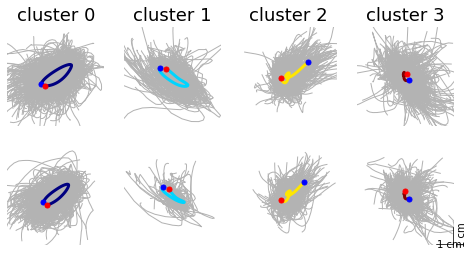

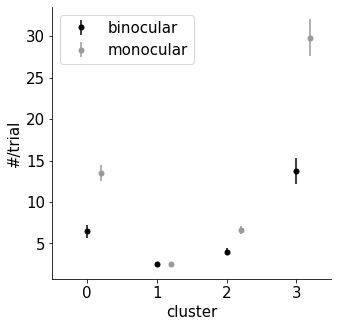

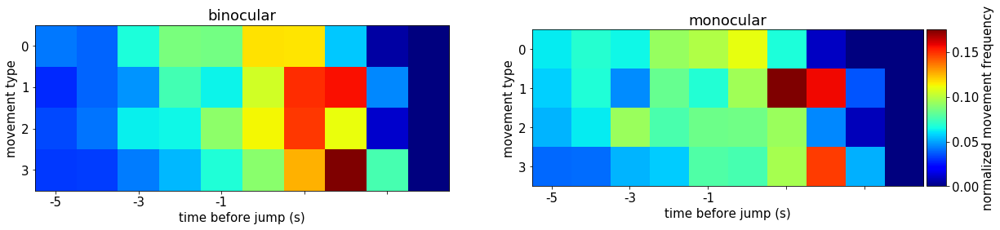

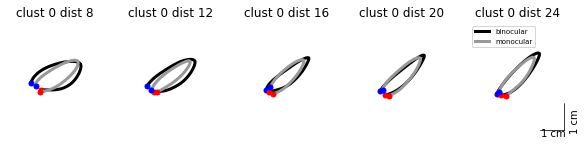

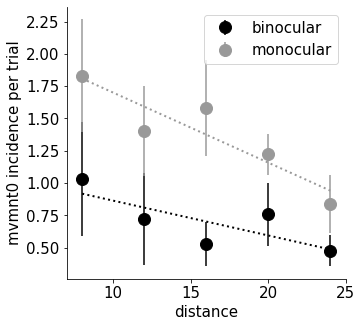

...

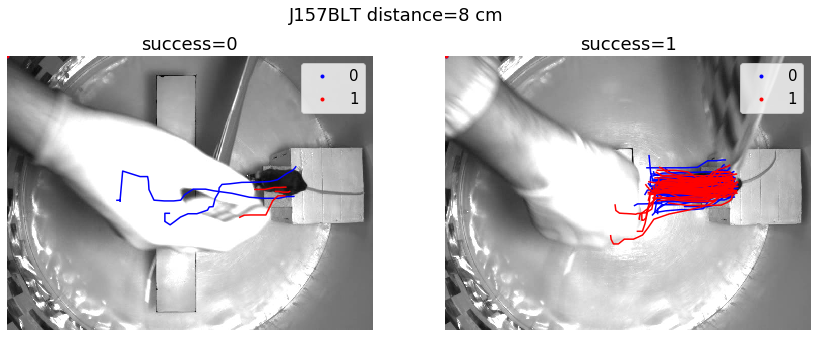

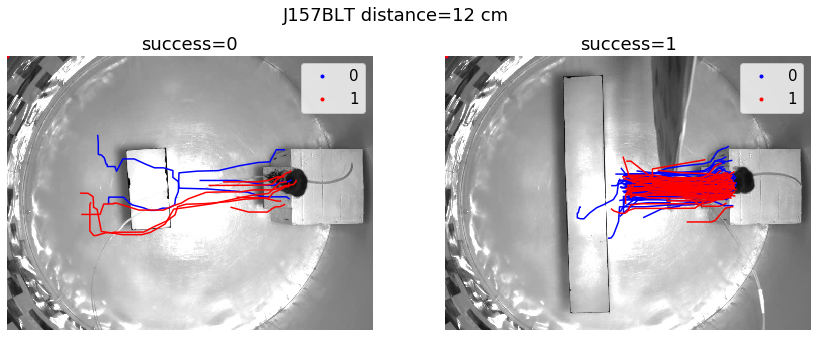

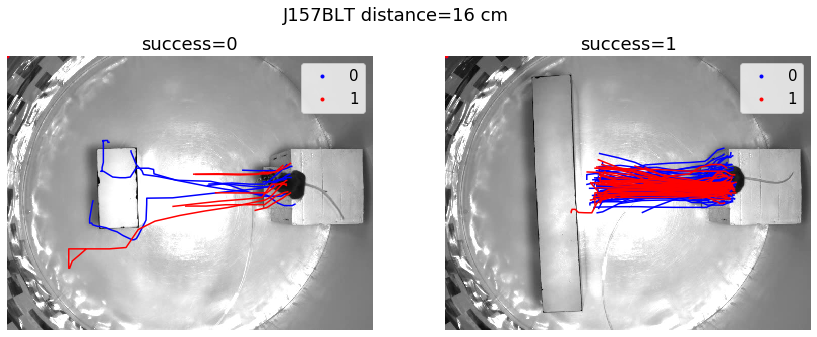

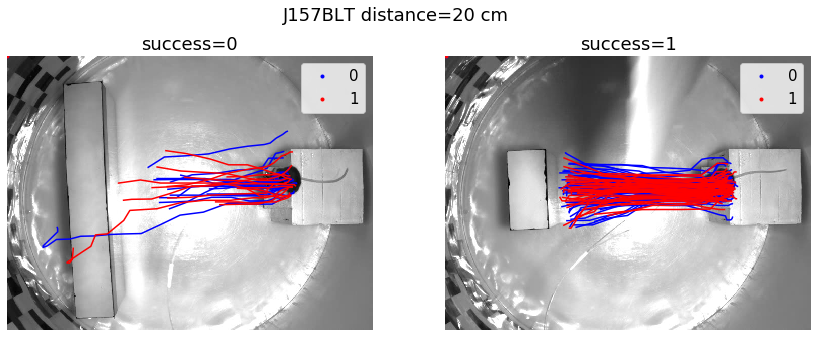

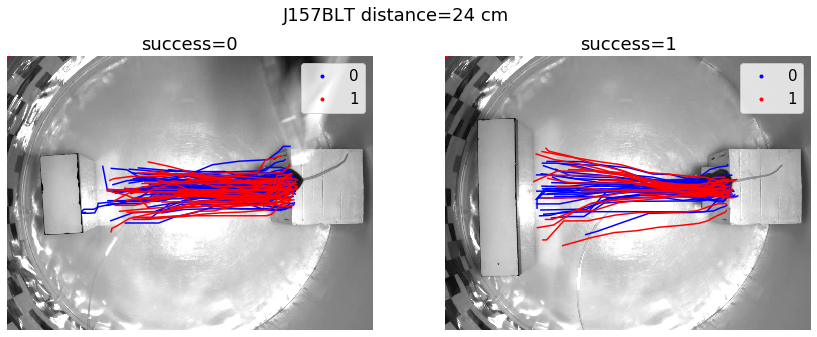

In [4]:
# ###### Individual analysis

# ### loop through each animal
# for a,ani in enumerate(np.unique(labels['subject'])):
    
#     ## Set up individual plot PDF file if save_pdf=True
#     if save_pdf:
#         pdf_file = data_file[:-4] + '_%s_plots_%dclusts.pdf' % (ani,n_k)
#         pp = PdfPages(pdf_file)
#     else:
#         pp=[]
        
#     ### baseline (no opto) data
#     df = df_all.copy()
#     df = df[df['laser_trial']!=1]
#     df.reset_index(inplace=True,drop=True)
#     df[df['condition']=='opto suture'] = df[df['condition']=='opto suture'].replace('opto suture','suture')
#     labels = labels_all.copy()
#     labels = labels[labels['laser_trial']!=1]
#     labels.reset_index(inplace=True,drop=True)
#     labels[labels['condition']=='opto suture'] = labels[labels['condition']=='opto suture'].replace('opto suture','suture')

#     df_ani = df[df['subject']==ani]
#     df_ani.reset_index(inplace=True,drop=True)
#     labels_ani = labels[labels['subject']==ani]
#     labels_ani.reset_index(inplace=True,drop=True)
#     new_labels_ani = new_labels[new_labels['subject']==ani]
#     new_labels_ani.reset_index(inplace=True,drop=True)
    
#     fig, ax = am.plot_movement_clusters(df_ani,labels_ani,'Side','hclusters','ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_cluster_freq(df_ani,labels_ani,'hclusters','ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_movement_timing(labels_ani,'Side','hclusters','ocular',plot_params,save_pdf,pp)
#     for cluster_num in range(n_k):
#         fig, ax = am.plot_movement_trace_distance(labels_ani,'Side',cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#         fig, ax = am.calculate_movement_frequency(df_ani,labels_ani,cluster_num,'hclusters','ocular',plot_params,save_pdf,pp)
#         fig,ax = am.plot_movement_amplitudes(labels_ani,cluster_num,'hclusters','ocular',1,plot_params,save_pdf,pp)
#         fig, ax = am.plot_yamps_mm(new_labels_ani,cluster_num,'hclusters','ocular',1,4,plot_params,save_pdf,pp)
#         fig, ax = am.plot_visangles(labels_ani,cluster_num,'hclusters','ocular',1,plot_params,save_pdf,pp)

#     ### Performance-related plots
#     # get rid of abort trials for bob performance curve so jumpdist makes sense
#     bob_df_ani = df.copy()
# #     bob_df[['success']] = bob_df[['success']].apply(pd.to_numeric)
# #     bob_df = bob_df[bob_df['success']!=2]
# #     bob_df.reset_index(inplace=True,drop=True)

#     bob_labels_ani = labels.copy()
# #     bob_labels[['success']] = bob_labels[['success']].apply(pd.to_numeric)
# #     bob_labels = bob_labels[bob_labels['success']!=2]
# #     bob_labels.reset_index(inplace=True,drop=True)
# #     #get jump accuracy
# #     bob_df = am.get_jump_accuracy(bob_df)
    
# #     bob_df_ani = bob_df.copy()
# #     bob_df_ani.reset_index(inplace=True,drop=True)
# #     bob_labels_ani = bob_labels.copy()
# #     bob_labels_ani.reset_index(inplace=True,drop=True)

#     for clust in range(n_k):
#         fig, ax = am.plot_performance_vs_movement(bob_df_ani,bob_labels_ani,clust,'hclusters','ocular',plot_params,save_pdf,pp)
#         bob_df = am.label_bob_trials(bob_df_ani,bob_labels_ani,'hclusters',clust)
#         fig, ax = am.plot_jump_accuracy(bob_df_ani,'ocular','bob_trial',clust,plot_params,save_pdf,pp)

#     ### count abort trials as failures for overall performance
#     perf_df = df.copy()
#     perf_df[['success']] = perf_df[['success']].apply(pd.to_numeric)
#     perf_df[perf_df['success']==2] = perf_df[perf_df['success']==2].replace(2,0)
#     perf_df.reset_index(inplace=True,drop=True)

#     perf_labels = labels.copy()
#     perf_labels[['success']] = perf_labels[['success']].apply(pd.to_numeric)
#     perf_labels[perf_labels['success']==2] = perf_labels[perf_labels['success']==2].replace(2,0)
#     perf_labels.reset_index(inplace=True,drop=True)
    
#     perf_df_ani = perf_df.copy() #what is this even achieving?
#     perf_df_ani.reset_index(inplace=True,drop=True)
#     perf_labels_ani = perf_labels.copy()
#     perf_labels_ani.reset_index(inplace=True,drop=True)

#     fig, ax = am.plot_performance(perf_df_ani,'ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_performance_platforms(perf_df_ani,'ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_ris_distance(perf_df_ani,'ocular',ris,plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist(perf_df_ani,'ocular',plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist_platforms(perf_df_ani,'ocular',plot_params,save_pdf,pp)

#     # plot all jumps
#     fig, ax = am.plot_jumps(bob_df_ani,'Top',vid_path,'ocular',plot_params,save_pdf,pp)
    
    
#     ###### opto analysis
#     df = df_all.copy()
#     df = df[df['condition']=='opto suture']
#     df.reset_index(inplace=True,drop=True)
#     labels = labels_all.copy()
#     labels = labels[labels['condition']=='opto suture']
#     labels.reset_index(inplace=True,drop=True)
    
#     df_ani = df[df['subject']==ani]
#     df_ani.reset_index(inplace=True,drop=True)
#     labels_ani = labels[labels['subject']==ani]
#     labels_ani.reset_index(inplace=True,drop=True)
#     new_labels_ani = new_labels[new_labels['subject']==ani]
#     new_labels_ani.reset_index(inplace=True,drop=True)
    
#     fig, ax = am.plot_movement_clusters(df_ani,labels_ani,'Side','hclusters','laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_cluster_freq(df_ani,labels_ani,'hclusters','laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_movement_timing(labels_ani,'Side','hclusters','laser_trial',plot_params,save_pdf,pp)
#     for cluster_num in range(n_k):
#         fig, ax = am.plot_movement_trace_distance(labels_ani,'Side',cluster_num,'hclusters','laser_trial',plot_params,save_pdf,pp)
#         fig, ax = am.calculate_movement_frequency(df_ani,labels_ani,cluster_num,'hclusters','laser_trial',plot_params,save_pdf,pp)
#         fig,ax = am.plot_movement_amplitudes(labels_ani,cluster_num,'hclusters','laser_trial',1,plot_params,save_pdf,pp)
#         fig, ax = am.plot_yamps_mm(new_labels_ani,cluster_num,'hclusters','laser_trial',1,4,plot_params,save_pdf,pp)
#         fig, ax = am.plot_visangles(labels_ani,cluster_num,'hclusters','laser_trial',1,plot_params,save_pdf,pp)

#     ### Performance-related plots
#     # get rid of abort trials for bob performance curve so jumpdist makes sense
#     bob_df = df.copy()
#     bob_df[['success']] = bob_df[['success']].apply(pd.to_numeric)
#     bob_df = bob_df[bob_df['success']!=2]
#     bob_df.reset_index(inplace=True,drop=True)

#     bob_labels = labels.copy()
#     bob_labels[['success']] = bob_labels[['success']].apply(pd.to_numeric)
#     bob_labels = bob_labels[bob_labels['success']!=2]
#     bob_labels.reset_index(inplace=True,drop=True)
#     #get jump accuracy
#     bob_df = am.get_jump_accuracy(bob_df)
    
#     bob_df_ani = bob_df.copy()
#     bob_df_ani.reset_index(inplace=True,drop=True)
#     bob_labels_ani = bob_labels.copy()
#     bob_labels_ani.reset_index(inplace=True,drop=True)

#     for clust in range(n_k):
#         new_df,fig, ax = am.plot_performance_vs_movement(bob_df_ani,bob_labels_ani,clust,'hclusters','laser_trial',plot_params,save_pdf,pp)
#         bob_df = am.label_bob_trials(bob_df_ani,bob_labels_ani,'hclusters',clust)
#         fig, ax = am.plot_jump_accuracy(bob_df_ani,'laser_trial','bob_trial',clust,plot_params,save_pdf,pp)

#     ### count abort trials as failures for overall performance
#     perf_df = df.copy()
#     perf_df[['success']] = perf_df[['success']].apply(pd.to_numeric)
#     perf_df[perf_df['success']==2] = perf_df[perf_df['success']==2].replace(2,0)
#     perf_df.reset_index(inplace=True,drop=True)

#     perf_labels = labels.copy()
#     perf_labels[['success']] = perf_labels[['success']].apply(pd.to_numeric)
#     perf_labels[perf_labels['success']==2] = perf_labels[perf_labels['success']==2].replace(2,0)
#     perf_labels.reset_index(inplace=True,drop=True)
    
#     perf_df_ani = perf_df.copy()
#     perf_df_ani.reset_index(inplace=True,drop=True)
#     perf_labels_ani = perf_labels.copy()
#     perf_labels_ani.reset_index(inplace=True,drop=True)

#     fig, ax = am.plot_performance(perf_df_ani,'laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_performance_platforms(perf_df_ani,'laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_ris_distance(perf_df_ani,'laser_trial',ris,plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist(perf_df_ani,'laser_trial',plot_params,save_pdf,pp)
#     fig, ax = am.plot_jumpdist_platforms(perf_df_ani,'laser_trial',plot_params,save_pdf,pp)

#     # plot all jumps
#     fig, ax = am.plot_jumps(bob_df_ani,'Top',vid_path,'laser_trial',plot_params,save_pdf,pp)

#     ### close the animal PDF
#     try:
#         pp.close()
#     except:
#         pass
    

    

# Make videos to show bobs

In [51]:
if make_videos:
    n_k = 4 # number of clusters in the dataset
    df_pickle = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_df_%dclusts_v2.pkl' % n_k
    labels_pickle = r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\analysis\paper_cohort_labels_%dclusts_v2.pkl' % n_k
    df_all = pd.read_pickle(df_pickle)
    labels_all = pd.read_pickle(labels_pickle)
    df_all[['success']] = df_all[['success']].apply(pd.to_numeric)
    labels_all[['success']] = labels_all[['success']].apply(pd.to_numeric)

    base_path = r'\\sendak\D\Phil\jumping_analysis\paper_cohort\bob_vids'
    side = 'Side'
    tdown = 1 # temporal downsample
    sdown = 2 # spatial downsample

    make_bob_vids(temp_df,labels_all,base_path,vid_path,side,tdown,sdown)

In [43]:
# if make_videos:
#     # Draw points on frame
#     def draw_points(frame, x, y, color,ptsize):
#         point_adds = product(range(-ptsize,ptsize), range(-ptsize,ptsize))
#         for pt in point_adds:
#             try:
#                 frame[x+pt[0],y+pt[1]] = color
#             except IndexError:
#                 pass
#         return frame


#     #a function to find the files we want
#     def find(pattern, path_list):
#         result = []
#         for path in path_list:
#     #         print(path)
#             for root, dirs, files in os.walk(path):
#                 for name in files: 
#                     if fnmatch.fnmatch(name,pattern): 
#     #                     print(name)
#                         result.append(os.path.join(root,name))
#         return result


#     movie_trials = labels.index[labels['kmeans']==bob_clust].tolist()
#     for mov in tqdm(np.arange(len(movie_trials))):

#         tr = movie_trials[mov]
#         name = labels['subject'][tr]
#         nm = name.replace('.','p')

#         date = labels['expdate'][tr]
#         dt = date.split('-')
#         dt = dt[1]+dt[2]+dt[0][2:]

#         tnum = labels['trial'][tr]

#         # vid_trial = df[(df['subject']==name)&(df['expdate']==date)&(df['trial']==tnum)]
#         # ppcm = vid_trial['pixpercm'].tolist()[0]
#         # eye_x = vid_trial['eye_x_trace'].tolist()[0]*ppcm
#         # eye_y = vid_trial['eye_y_trace'].tolist()[0]*ppcm

#         movie_path = [r'D:\Phil\jumping_analysis\firstgen\clipped_vids',r'D:\Phil\jumping_analysis\secondgen\clipped_vids']

#         vidfile = find(dt + '_' + nm + '*_' + str(tnum).zfill(3) + '.avi',movie_path)[0]

#         dlc_file = find(dt + '_' + nm + '*_' + str(tnum).zfill(3) + '*.csv',movie_path)[0]

#         out_file = os.path.join(r'\\sendak\C\Users\nlab\Box Sync\Phil Niell Lab\Behavior\Jumping task\bob_vids',
#                                 os.path.split(vidfile)[-1][:-4] + '_mvmnt' + str(tr).zfill(3) + '.avi')

#         print(vidfile,dlc_file,out_file)

#         dlc = pd.read_csv(dlc_file,skiprows=2)
#         eye_x = dlc['x.2']
#         eye_y = dlc['y.2']

#         vid = cv2.VideoCapture(vidfile)
#         total_frames_1 = int(vid.get(cv2.CAP_PROP_FRAME_COUNT))
#         print(total_frames_1)
#         fps = vid.get(cv2.CAP_PROP_FPS)
#         frame_width = int(vid.get(3))
#         frame_height = int(vid.get(4))
        
#         st_frame = labels['windows'][tr]
#         frame_range = np.ceil(fps*0.4) #number of frames in movement/2
#         vid_frames = np.arange(st_frame,st_frame+frame_range*2+1,1).astype('int')
#         vid_frames

#         col = [255,0,0]
#         tdown = 4 #slo-mo factor
#         out = cv2.VideoWriter(out_file,cv2.VideoWriter_fourcc('M','J','P','G'), fps/tdown,(frame_width,frame_height))

#         for idx in vid_frames:
#             vid.set(cv2.CAP_PROP_POS_FRAMES, idx)
#             ret, frame_1 = vid.read()
#             frame_1 = draw_points(frame_1, eye_y[vid_frames[0]:idx].astype('int'), eye_x[vid_frames[0]:idx].astype('int'), col,5)
#             out.write(frame_1)

#             if cv2.waitKey(1) & 0xFF == ord('q'):
#                 break

#         out.release()
#         vid.release()
#         cv2.destroyAllWindows()

In [44]:
# if make_videos:
#     import os,fnmatch
#     import cv2
#     import matplotlib.colors as mpc
#     from itertools import product

#     def draw_points(frame, x, y, color,ptsize):
#         point_adds = product(range(-ptsize,ptsize), range(-ptsize,ptsize))
#         for pt in point_adds:
#             try:
#                 frame[x+pt[0],y+pt[1]] = color
#             except IndexError:
#                 pass
#         return frame


#     #a function to find the files we want
#     def find(pattern, path_list):
#         result = []
#         for path in path_list:
#     #         print(path)
#             for root, dirs, files in os.walk(path):
#                 for name in files: 
#                     if fnmatch.fnmatch(name,pattern): 
#     #                     print(name)
#                         result.append(os.path.join(root,name))
#         if len(result)==1:
#             result = result[0]
#         return result

#     cm = pylab.get_cmap('plasma')

#     movie_path = [r'D:\Phil\jumping_analysis\paper_cohort\clipped_vids']
#     bob_path = r'D:\Phil\jumping_analysis\paper_cohort\bob_vids'
#     # if make_videos:
#     #     for tr,row in df.iterrows():



#     temp_df = df.iloc[[300,400,500,600,700,800,900,1000]]
#     # temp_df.reset_index(inplace=True)
#     for index, row in temp_df.iterrows():

#         name = row['subject']
#         date = row['expdate']
#         tnum = row['trial']

#         vidfile = find(date + '_' + name + '_Side_' + str(tnum).zfill(3) + '.avi',movie_path)
#         dlcfile = find(date + '_' + name + '_Side_' + str(tnum).zfill(3) + '*filtered.h5',movie_path)
#         out_file = os.path.join(bob_path, date + '_' + name + '_mvmnt' + str(tnum).zfill(3) + '.avi')

#         print(vidfile,dlcfile,out_file)
        
#         pts = pd.read_hdf(dlcfile)
#         pts.columns = [' '.join(col[:][1:3]).strip() for col in pts.columns.values]
#         eye_x = pts['LEye x']
#         eye_y = pts['LEye y']

# #         eye_x = row['Side LEye x']
# #         eye_y = row['Side LEye y']

#         col_labels = np.zeros((len(eye_x))).astype('int')
#         st_frame = row['windows']
#         k_vals = labels[(labels['subject']==name)&(labels['expdate']==date)&(labels['trial']==tnum)]['kmeans'].tolist()

        
#         vid = cv2.VideoCapture(vidfile)
#         total_frames_1 = int(vid.get(cv2.CAP_PROP_FRAME_COUNT))
#         fps = vid.get(cv2.CAP_PROP_FPS)
#         frame_width = int(vid.get(3))
#         frame_height = int(vid.get(4))

#         frame_range = int(np.ceil(fps*0.4)) #number of frames in movement (800ms window)
#         for st,k in zip(st_frame,k_vals):
#             st = st+frame_range
#             vid_frames = np.arange(st-frame_range/2,st+frame_range/2+1,1).astype('int')
#             col_labels[vid_frames] = k#+1

#         tdown = 4 #slo-mo factor
#         out = cv2.VideoWriter(out_file,cv2.VideoWriter_fourcc('M','J','P','G'), fps/tdown,(frame_width,frame_height))

#         mvmnt_label = ['no movement']
#         for i in range(n_k):
#             mvmnt_label.append('movement %d' % i)

#         font = cv2.FONT_HERSHEY_DUPLEX
#         fontsize = 2

#         for idx in np.arange(total_frames_1):
#             vid.set(cv2.CAP_PROP_POS_FRAMES, idx)
#             ret, frame_1 = vid.read()

#             if idx<len(eye_x):
#                 col = 255*np.array(mpc.to_rgb(cm(col_labels[idx]/n_k)))
#                 col = col.astype('int64')
#                 if idx>frame_range:
#                     frame_1 = draw_points(frame_1, eye_y[idx-frame_range:idx].astype('int'),
#                                           eye_x[idx-frame_range:idx].astype('int'),
#                                       col,5)
#                 else:
#                     frame_1 = draw_points(frame_1, eye_y[:idx].astype('int'),
#                                           eye_x[:idx].astype('int'),
#                                           col,5)
#                 cv2.putText(frame_1, mvmnt_label[col_labels[idx]], (int(frame_width/3),int(frame_height/3)), font, fontsize, tuple(col.tolist()), 1, cv2.LINE_AA)
#             out.write(frame_1)

#             if cv2.waitKey(1) & 0xFF == ord('q'):
#                 break

#         out.release()
#         vid.release()
#         cv2.destroyAllWindows()

# Older analyses below

In [45]:
# from sklearn.cluster import AgglomerativeClustering
# from sklearn.neighbors import kneighbors_graph
# from scipy.cluster.hierarchy import dendrogram

# def plot_dendrogram(model, **kwargs):
#     # Create linkage matrix and then plot the dendrogram

#     # create the counts of samples under each node
#     counts = np.zeros(model.children_.shape[0])
#     n_samples = len(model.labels_)
#     for i, merge in enumerate(model.children_):
#         current_count = 0
#         for child_idx in merge:
#             if child_idx < n_samples:
#                 current_count += 1  # leaf node
#             else:
#                 current_count += counts[child_idx - n_samples]
#         counts[i] = current_count

#     linkage_matrix = np.column_stack([model.children_, model.distances_,
#                                       counts]).astype(float)

#     # Plot the corresponding dendrogram
#     dendrogram(linkage_matrix, **kwargs)

# # setting distance_threshold=0 ensures we compute the full tree.
# knn_graph = kneighbors_graph(reduced_data, 50, include_self=False,mode='distance')
# model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)
# cluster_data = model.fit(reduced_data)

# plt.figure(figsize=(10,10))
# plt.title('Hierarchical Clustering Dendrogram')
# # plot the top three levels of the dendrogram
# plot_dendrogram(cluster_data, truncate_mode='level', p=3)
# plt.xlabel("Number of points in node (or index of point if no parenthesis).")
# plt.show()

In [46]:
# # setting distance_threshold=0 ensures we compute the full tree.
# knn_graph = kneighbors_graph(reduced_data, 50, include_self=False,mode='distance')
# model = AgglomerativeClustering(linkage='ward',connectivity=knn_graph,n_clusters=None,distance_threshold=0)
# model = model.fit(reduced_data)

# plt.figure(figsize=(10,10))
# plt.title('Hierarchical Clustering Dendrogram')
# # plot the top three levels of the dendrogram
# plot_dendrogram(model, truncate_mode='level', p=3)
# plt.xlabel("Number of points in node (or index of point if no parenthesis).")
# plt.show()

In [47]:
# model = AgglomerativeClustering(linkage='ward',connectivity=knn_graph,n_clusters=10)
# model = model.fit(reduced_data)
# cluster_data = model.labels_
# np.unique(cluster_data).shape

# n_k = len(np.unique(cluster_data)) #number of k-means clusters

# ### Plot all traces and average trace for each cluster with color matching UMAP cluster plot
# cond_trials = [df[(df['ocular']=='binocular')].shape[0],df[(df['ocular']=='monocular')].shape[0]] #num trials in each cond

# fig, axs = plt.subplots(2*len(conds),math.ceil(n_k/2),figsize=(2*n_k,8*len(conds)))
# fig2, ax2 = plt.subplots(1,1,figsize=(10,10))
# axs = axs.ravel()
# cnt=0 #subplot counter

# for c,cond in enumerate(conds):
#     for label in range(n_k):
#     #         tr_idx = np.intersect1d(np.where(kmeans.labels_==label)[0],np.intersect1d(np.where(labels['condition_id']==cond)[0],
#     #                                                                                   np.where(success==1)[0]))
#         tr_idx = np.intersect1d(np.where(labels['kmeans']==label)[0],np.where(labels['condition']==cond)[0])
# #         tr_idx = np.where(kmeans.labels_==label)[0]
#         n_t = len(tr_idx)
#         ax = axs[cnt]
#         for idx in tr_idx:
#             xtr = x[idx,:] - np.mean(x[idx,:])
#             ytr = y[idx,:] - np.mean(y[idx,:])
#             ax.plot(xtr,ytr,color=[0.7,0.7,0.7],linewidth=1)

#         xtr = np.mean(x[tr_idx,:],axis=0)
#         xtr -= np.mean(xtr)
#         ytr = np.mean(y[tr_idx,:],axis=0)
#         ytr -= np.mean(ytr)
#         col = cm(1.*label/n_k)
#         ax.plot(xtr,ytr,color=col,linewidth=3,label=str(label))
#         ax.plot(xtr[0],ytr[0],'bo',markersize=5)
#         ax.plot(xtr[-1],ytr[-1],'ro',markersize=5)

#         ax.set_xlim(-3,3)
#         ax.set_ylim(-3,3)
#         ax.set_title('clust%d %s' % (label,cond))#,oc[cond]))
#         ax.text(-2.5,-2.5,'n=%d in %d trials' % (n_t,cond_trials[c]), fontsize=10)
#         ax.set_xticks(np.arange(-2,3,step=2))
#         ax.set_yticks(np.arange(-2,3,step=2))
#         cnt+=1
        
#         if label==0:
#             ax2.bar(label+0.5*c,n_t/cond_trials[c],color=cond_col[c],label=cond)
#         else:
#             ax2.bar(label+0.5*c,n_t/cond_trials[c],color=cond_col[c])
#         ax2.set_ylabel('#mvmnt/#trials')
#         ax2.set_xlabel('cluster')
#         ax2.legend()

# knn_graph = kneighbors_graph(reduced_data, 50, include_self=False)
# model = AgglomerativeClustering(linkage='ward',connectivity=knn_graph,n_clusters=10)
# cluster_data = model.fit_predict(reduced_data)

In [48]:
# n_k = len(np.unique(kmeans.labels_))
# plt.rcParams.update({'font.size': 50})
# numAni = len(np.unique(subject))

# prominence=0.1
# pdist=5

# fig, axs = plt.subplots(2,5,figsize=(100,40))
# axs = axs.ravel()
# for label in range(n_k):
#     tr_idx = np.intersect1d(np.where(kmeans.labels_==label)[0],np.where(success==1)[0])
# #     tr_idx = np.where(kmeans.labels_==label)[0]
#     dtr = distance[tr_idx]
#     xtr = x[tr_idx,:]
#     ytr = y[tr_idx,:]

#     xamps = np.zeros(xtr.shape[0])
#     yamps = np.zeros(ytr.shape[0])
#     for t,(xt,yt) in enumerate(zip(xtr,ytr)):
#         xpt,xptp = signal.find_peaks(xt, prominence=prominence, distance=pdist)
#         ypt,yptp = signal.find_peaks(yt, prominence=prominence, distance=pdist)
#         if (len(xpt)==0) and (len(ypt)==0):
#             xamps[t] = np.nan
#             yamps[t] = np.nan
#         elif len(xpt)==0:
#             idx = np.argmin(abs(ypt-len(yt)/2).astype('int'))
#             yamps[t] = yptp['prominences'][idx]
#             L = yptp['left_bases'][idx]
#             R = yptp['right_bases'][idx]
#             xamps[t] = np.abs(xt[L]-xt[R])       
#         elif len(ypt)==0:
#             idx = np.argmin(abs(xpt-len(xt)/2).astype('int'))
#             xamps[t] = xptp['prominences'][idx]
#             L = xptp['left_bases'][idx]
#             R = xptp['right_bases'][idx]
#             yamps[t] = np.abs(yt[L]-yt[R])
#         else:
#             idx = np.argmin(abs(xpt-len(xt)/2).astype('int'))
#             xamps[t] = xptp['prominences'][idx]
#             idx = np.argmin(abs(ypt-len(yt)/2).astype('int'))
#             yamps[t] = yptp['prominences'][idx]

#     yxratio = yamps/xamps#(xamps+yamps)
#     ax = axs[label]
#     for d in np.unique(dtr):
#         try:
#             ax.errorbar(d,np.mean(xamps[dtr==d]),yerr=np.std(xamps[dtr==d])/np.sqrt(numAni),color='b',marker='o',markersize=30)
#             ax.errorbar(d,np.mean(yamps[dtr==d]),yerr=np.std(yamps[dtr==d])/np.sqrt(numAni),color='r',marker='o',markersize=30)
#             ax.errorbar(d,np.mean(yxratio[dtr==d]),yerr=np.std(yxratio[dtr==d])/np.sqrt(numAni),color='k',marker='o',markersize=30)

#         except:
#             pass
#     ax.set_ylim(0,3)
#     ax.set_title('clust%d' % (label))
                                


In [49]:
# n_k = len(np.unique(kmeans.labels_))
# plt.rcParams.update({'font.size': 15})
# numAni = len(np.unique(subject))

# prominence=0.1
# pdist=5

# fig, ax = plt.subplots(1,1,figsize=(10,10))
# tr_idx = np.intersect1d(np.where(success==1)[0],np.union1d(np.where(kmeans.labels_==4)[0],
#                         np.union1d(np.where(kmeans.labels_==5)[0],np.where(kmeans.labels_==9)[0])))
# #     tr_idx = np.where(kmeans.labels_==label)[0]
# dtr = distance[tr_idx]
# xtr = x[tr_idx,:]
# ytr = y[tr_idx,:]

# xamps = np.zeros(xtr.shape[0])
# yamps = np.zeros(ytr.shape[0])
# for t,(xt,yt) in enumerate(zip(xtr,ytr)):
#     xpt,xptp = signal.find_peaks(xt, prominence=prominence, distance=pdist)
#     ypt,yptp = signal.find_peaks(yt, prominence=prominence, distance=pdist)
#     if (len(xpt)==0) and (len(ypt)==0):
#         xamps[t] = np.nan
#         yamps[t] = np.nan
#     elif len(xpt)==0:
#         idx = np.argmin(abs(ypt-len(yt)/2).astype('int'))
#         yamps[t] = yptp['prominences'][idx]
#         L = yptp['left_bases'][idx]
#         R = yptp['right_bases'][idx]
#         xamps[t] = np.abs(xt[L]-xt[R])       
#     elif len(ypt)==0:
#         idx = np.argmin(abs(xpt-len(xt)/2).astype('int'))
#         xamps[t] = xptp['prominences'][idx]
#         L = xptp['left_bases'][idx]
#         R = xptp['right_bases'][idx]
#         yamps[t] = np.abs(yt[L]-yt[R])
#     else:
#         idx = np.argmin(abs(xpt-len(xt)/2).astype('int'))
#         xamps[t] = xptp['prominences'][idx]
#         idx = np.argmin(abs(ypt-len(yt)/2).astype('int'))
#         yamps[t] = yptp['prominences'][idx]

# yxratio = yamps/xamps#(xamps+yamps)
# for d in np.unique(dtr):
#     try:
#         ax.errorbar(d,np.mean(xamps[dtr==d]),yerr=np.std(xamps[dtr==d])/np.sqrt(numAni),color='b',marker='o',markersize=10)
#         ax.errorbar(d,np.mean(yamps[dtr==d]),yerr=np.std(yamps[dtr==d])/np.sqrt(numAni),color='r',marker='o',markersize=10)
#         ax.errorbar(d,np.mean(yxratio[dtr==d]),yerr=np.std(yxratio[dtr==d])/np.sqrt(numAni),color='k',marker='o',markersize=10)

#     except:
#         pass
# ax.set_ylim(0,3)
# # ax.set_title('clust%d' % (label))
                                


In [50]:
# n_k = len(np.unique(kmeans.labels_))
# plt.rcParams.update({'font.size': 15})
# numAni = len(np.unique(subject))

# prominence=0.1
# pdist=5

# fig, axs = plt.subplots(1,2,figsize=(10,5))
# axs = axs.ravel()
# for i,label in enumerate([4,9]):
#     tr_idx = np.intersect1d(np.where(kmeans.labels_==label)[0],np.where(success==1)[0])
# #     tr_idx = np.where(kmeans.labels_==label)[0]
#     dtr = distance[tr_idx]
#     xtr = x[tr_idx,:]
#     ytr = y[tr_idx,:]

#     xamps = np.zeros(xtr.shape[0])
#     yamps = np.zeros(ytr.shape[0])
#     for t,(xt,yt) in enumerate(zip(xtr,ytr)):
#         xpt,xptp = signal.find_peaks(xt, prominence=prominence, distance=pdist)
#         ypt,yptp = signal.find_peaks(yt, prominence=prominence, distance=pdist)
#         if (len(xpt)==0) and (len(ypt)==0):
#             xamps[t] = np.nan
#             yamps[t] = np.nan
#         elif len(xpt)==0:
#             idx = np.argmin(abs(ypt-len(yt)/2).astype('int'))
#             yamps[t] = yptp['prominences'][idx]
#             L = yptp['left_bases'][idx]
#             R = yptp['right_bases'][idx]
#             xamps[t] = np.abs(xt[L]-xt[R])       
#         elif len(ypt)==0:
#             idx = np.argmin(abs(xpt-len(xt)/2).astype('int'))
#             xamps[t] = xptp['prominences'][idx]
#             L = xptp['left_bases'][idx]
#             R = xptp['right_bases'][idx]
#             yamps[t] = np.abs(yt[L]-yt[R])
#         else:
#             idx = np.argmin(abs(xpt-len(xt)/2).astype('int'))
#             xamps[t] = xptp['prominences'][idx]
#             idx = np.argmin(abs(ypt-len(yt)/2).astype('int'))
#             yamps[t] = yptp['prominences'][idx]

#     yxratio = yamps/xamps#(xamps+yamps)
#     ax = axs[i]
#     for d in np.unique(dtr):
#         try:
#             ax.errorbar(d,np.mean(xamps[dtr==d]),yerr=np.std(xamps[dtr==d])/np.sqrt(numAni),color='b',marker='o',markersize=10,label='xamp')
#             ax.errorbar(d,np.mean(yamps[dtr==d]),yerr=np.std(yamps[dtr==d])/np.sqrt(numAni),color='r',marker='o',markersize=10,label='yamp')
# #             ax.errorbar(d,np.mean(yxratio[dtr==d]),yerr=np.std(yxratio[dtr==d])/np.sqrt(numAni),color='k',marker='o',markersize=10)

#         except:
#             pass
#     ax.set_ylim(0,3)
#     ax.set_xlim(5,30)
#     ax.set_yticks(np.arange(0,4,step=1))
#     ax.set_title('clust%d' % (label))
#     ax.set_ylabel('amplitude (cm)')
#     ax.set_xlabel('gap distance (cm)')
    
# ax.set_xlim(5,33)                                


In [51]:
# #plot a head movement
# num = 800
# x = df.eye_x_trace[num]
# y = df.eye_y_trace[num]

# plt.figure(figsize=(5,5))
# plt.plot(x-np.mean(x)+1,'b',label='x_eye')
# plt.plot(y-np.mean(y)-1,'r',label='y_eye')
# plt.xlabel('time (s)')
# plt.ylabel('position (cm)')
# plt.xticks(np.arange(0, 200, step=50),np.arange(0, 2, step=0.5))
# plt.legend(fontsize=10)

# plt.figure(figsize=(5,5))
# plt.plot(x-np.mean(x),y-np.mean(y),'k')
# plt.plot(x[0]-np.mean(x),y[0]-np.mean(y),'go',label='start')
# plt.plot(x[-1]-np.mean(x),y[-1]-np.mean(y),'ro',label='end')
# plt.axis([-3,3,-3,3])
# plt.xlabel('x position (cm)')
# plt.ylabel('y position (cm)')
# plt.xticks(np.arange(-2, 3, step=2))
# plt.yticks(np.arange(-2, 3, step=2))
# plt.legend(fontsize=10)

## Calculate total distance traveled in x and y in each movement cluster and plot against distance (success only, not really relevant to some of the noisier movements)

In [52]:
# #take the sum of the absolute value of the derivative in each dimension (x and y) to get total distance traveled
# n_k = len(np.unique(kmeans.labels_))
# plt.rcParams.update({'font.size': 50})
# numAni = len(np.unique(subject))

# prominence=0.1
# pdist=5

# oc = ['binocular','monocular']
# for cond in range(len(np.unique(condition))):
#     fig, axs = plt.subplots(2,5,figsize=(100,40))
#     axs = axs.ravel()
#     for label in range(n_k):
#         tr_idx = np.intersect1d(np.where(kmeans.labels_==label)[0],np.intersect1d(np.where(labels['condition']==cond)[0],
#                                                                                   np.where(success==1)[0]))
#     #     tr_idx = np.where(kmeans.labels_==label)[0]
#         dtr = distance[tr_idx]
#         xtr = x[tr_idx,:]
#         ytr = y[tr_idx,:]

#         xamps = np.zeros(xtr.shape[0])
#         yamps = np.zeros(ytr.shape[0])
#         for t,(xt,yt) in enumerate(zip(xtr,ytr)):
#             xamps[t] = np.sum(np.abs(np.gradient(xt)))
#             yamps[t] = np.sum(np.abs(np.gradient(yt)))
#         yxratio = yamps/xamps#(xamps+yamps)
#         ax = axs[label]
#         for d in np.unique(dtr):
#             try:
#                 ax.errorbar(d,np.mean(xamps[dtr==d]),yerr=np.std(xamps[dtr==d])/np.sqrt(numAni),color='b',marker='o',markersize=30)
#                 ax.errorbar(d,np.mean(yamps[dtr==d]),yerr=np.std(yamps[dtr==d])/np.sqrt(numAni),color='r',marker='o',markersize=30)
#                 ax.errorbar(d,np.mean(yxratio[dtr==d]),yerr=np.std(yxratio[dtr==d])/np.sqrt(numAni),color='k',marker='o',markersize=30)

#             except:
#                 pass
#         ax.set_title('clust%d %s' % (label,oc[cond]))
#     #     ax.set_ylim(0,3)


## Calculate peak velocity in x and y in each movement cluster and plot against distance (success only)

In [53]:
# #take the mean of max of the absolute value of the derivative in each dimension (x and y) to get velocity
# #note this is /frame not /sec
# n_k = len(np.unique(kmeans.labels_))
# plt.rcParams.update({'font.size': 50})
# numAni = len(np.unique(subject))

# oc = ['binocular','monocular']
# for cond in range(len(np.unique(condition))):
#     fig, axs = plt.subplots(2,5,figsize=(100,40))
#     axs = axs.ravel()
#     for label in range(n_k):
#         tr_idx = np.intersect1d(np.where(kmeans.labels_==label)[0],np.intersect1d(np.where(labels['condition']==cond)[0],
#                                                                                   np.where(success==1)[0]))
#     #     tr_idx = np.where(kmeans.labels_==label)[0]
#         dtr = distance[tr_idx]
#         xtr = x[tr_idx,:]
#         ytr = y[tr_idx,:]

#         xamps = np.zeros(xtr.shape[0])
#         yamps = np.zeros(ytr.shape[0])
#         for t,(xt,yt) in enumerate(zip(xtr,ytr)):
#             xamps[t] = np.max(np.abs(np.gradient(xt))) #change this for mean vs. peak velocity
#             yamps[t] = np.max(np.abs(np.gradient(yt))) #change this for mean vs. peak velocity
#         yxratio = yamps/xamps#(xamps+yamps)
#         ax = axs[label]
#         for d in np.unique(dtr):
#             try:
#                 ax.errorbar(d,np.mean(xamps[dtr==d]),yerr=np.std(xamps[dtr==d])/np.sqrt(numAni),color='b',marker='o',markersize=30)
#                 ax.errorbar(d,np.mean(yamps[dtr==d]),yerr=np.std(yamps[dtr==d])/np.sqrt(numAni),color='r',marker='o',markersize=30)
# #                 ax.errorbar(d,np.mean(yxratio[dtr==d]),yerr=np.std(yxratio[dtr==d])/np.sqrt(numAni),color='k',marker='o',markersize=30)

#             except:
#                 pass
#         ax.set_title('clust%d %s' % (label,oc[cond]))
#         ax.set_ylim(0,)


# Extended PCA analysis

## Plot first three PCA components in 3D

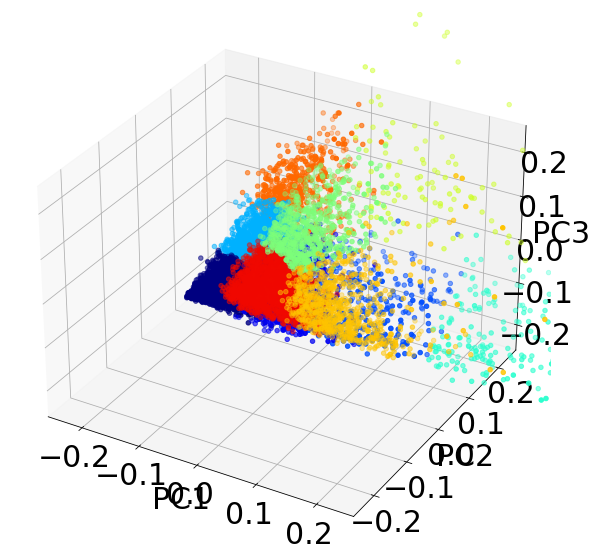

In [23]:
plt.rcParams.update({'font.size': 30})
n_k = len(np.unique(kmeans.labels_))
cm = pylab.get_cmap('jet')
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')

for label in range(n_k):
    col = cm(1.*label/n_k)
    idx = np.where(kmeans.labels_==label)[0]
    pc1 = reduced_data[idx,0]
    pc2 = reduced_data[idx,1]
    pc3 = reduced_data[idx,2]
    ax.scatter(pc1,pc2,pc3,color=col,marker='o')
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
lim = 0.25
ax.set_xlim(-lim,lim)
ax.set_ylim(-lim,lim)
ax.set_zlim(-lim,lim)

plt.show()

## Sequentially plot PCA components against each other

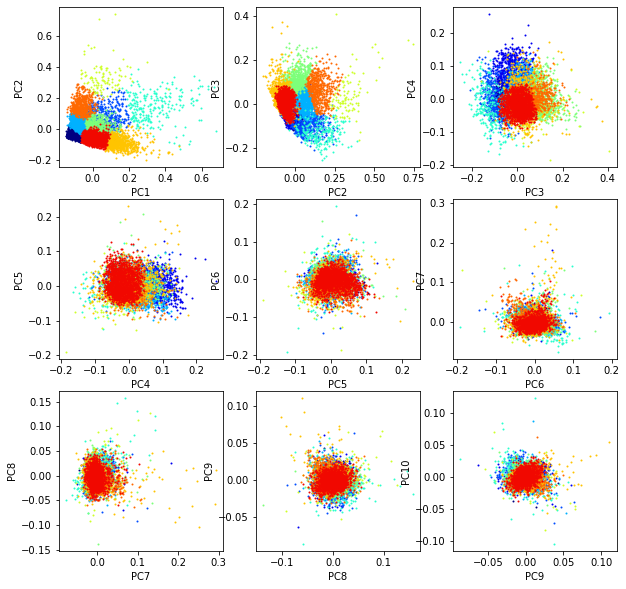

In [22]:
plt.rcParams.update({'font.size': 10})
n_k = len(np.unique(kmeans.labels_))
cm = pylab.get_cmap('jet')
fig, axs = plt.subplots(3,3,figsize=(10,10))
axs = axs.ravel()

for pc in range(9):
    ax = axs[pc]
    for label in range(n_k):
        col = cm(1.*label/n_k)
        idx = np.where(kmeans.labels_==label)[0]
        pc1 = reduced_data[idx,pc]
        pc2 = reduced_data[idx,pc+1]
        ax.plot(pc1,pc2,'o',color=col,markersize=1)
#     ax.axis([-2,2,-2,2])
    ax.set_xlabel('PC%d' % (pc+1))
    ax.set_ylabel('PC%d' % (pc+2))

In [56]:
# plt.rcParams.update({'font.size': 20})

# fig, axs = plt.subplots(2,5,figsize=(25,10))
# axs = axs.ravel()

# for pc in range(10):
#     ax = axs[pc]
#     curve = pca.components_[pc,:]
#     ax.plot(curve[:int(len(curve)/2)],'b',label='x')
#     ax.plot(curve[int(len(curve)/2):],'r',label='y')
#     lim = 0.4
#     ax.set_ylim(-lim,lim)
#     ax.legend(fontsize=10)


# fig, axs = plt.subplots(2,5,figsize=(25,10))
# axs = axs.ravel()

# for pc in range(10):
#     ax = axs[pc]
#     curve = pca.components_[pc,:]
#     ax.plot(curve[:int(len(curve)/2)],curve[int(len(curve)/2):],'k')
#     ax.plot(curve[0],curve[int(len(curve)/2)],'go')
#     ax.plot(curve[int(len(curve)/2-1)],curve[-1],'ro')
#     lim = 0.4
#     ax.axis([-lim,lim,-lim,lim])


In [57]:
# import cv2
# vidfile = r'D:\Phil\jumping_analysis\2cams\clipped_vids\101019_CK2-CK2-7P2-RT_cam1_016.avi'
# vid = cv2.VideoCapture(vidfile)
# total_frames_1 = int(vid.get(cv2.CAP_PROP_FRAME_COUNT))
# fps = vid.get(cv2.CAP_PROP_FPS)
# cv2.namedWindow('image')#,cv2.WND_PROP_FULLSCREEN)
# def nothing(x):
#     pass
# cv2.createTrackbar('Frame','image',0,total_frames_1-1,nothing)
# cnt=0
# print(fps,total_frames_1
      
# while(True):
#     n_frame = cv2.getTrackbarPos('Frame','image')
#     vid.set(cv2.CAP_PROP_POS_FRAMES, n_frame)

#     ret, frame_1 = vid.read()

#     k = cv2.waitKey(1) 

#     #esc key exits
#     if k == 27:
#         cv2.destroyAllWindows()

#     elif k == ord('s'):
#         cv2.imwrite(r'C:\Users\nlab\Desktop\frame%d.png' % cnt,frame_1)
#         cnt+=1
#     #navigation keys
#     elif k == ord('i'): # Left key fast
#         n_frame = cv2.setTrackbarPos('Frame','image',n_frame-1)
#     elif k == ord('o'): # Right key fast
#         n_frame = cv2.setTrackbarPos('Frame','image',n_frame+1)
            

        
# cv2.destroyAllWindows()

In [58]:
# cv2.destroyAllWindows()